# **Introduction**

## **Description and goal of the project**

<span style="font-size:18px;">This project is part of the assessment for the "Python for Data Analysis" module in the first semester of the Master 1 "Data & Artificial Intelligence" at ESILV, 2023-2024. Working in a group of two students, here Emrys MEZIANI and Sébastien MOINE from DIA5, we are required to apply what we have learned during lecture and tutorial sessions, and more. Two datasets were proposed to us, and we ultimately chose the one focusing on the popularity of online articles, "Online News Popularity".

<span style="font-size:18px;">The project involves analyzing the dataset, processing the data (data pre-processing), visualizing the data to demonstrate the connection between the variables and the "target", which is the variable we wish to explain and predict. The final aspect is the modeling of predictive models using the scikit-learn library, modifying and optimizing the hyperparameters, and comparing the results. Additionally, we are asked to transform the predictive model of our choice into an API. Finally, the team will have to present their topic to their tutorial professor during a reserved slot, with a PowerPoint explaining the "ins" and "outs" of the problem, the thought process, the different variables, how the project aligns with the module, the results obtained, etc.

<span style="font-size:18px;">In short, the overall objective of the project is to provide a complete solution for analyzing data, developing an accurate predictive model, and making it accessible via an API. This will allow us to solve the problem and obtain usable results.

## **Description of the dataset**

<span style="font-size:18px;">The "Online News Popularity" dataset, released on 05/30/2015, is available on the UCI Machine Learning Repository. The data is a set of features on articles published by "Mashable" over a two-year period (2013-2014). The goal is to predict the number of "shares" on social networks, thereby measuring popularity. This problem can be addressed both through regression and classification. The dataset contains 39,797 instances and 61 variables (58 predictive attributes, 2 non-predictive, and 1 goal field).

<span style="font-size:18px;">Here is a detail of the variables present in the dataset:

**Attribute Information:**

     0. url:                           URL of the article
     1. timedelta:                     Days between the article publication and
                                       the dataset acquisition
     2. n_tokens_title:                Number of words in the title
     3. n_tokens_content:              Number of words in the content
     4. n_unique_tokens:               Rate of unique words in the content
     5. n_non_stop_words:              Rate of non-stop words in the content
     6. n_non_stop_unique_tokens:      Rate of unique non-stop words in the
                                       content
     7. num_hrefs:                     Number of links
     8. num_self_hrefs:                Number of links to other articles
                                       published by Mashable
     9. num_imgs:                      Number of images
    10. num_videos:                    Number of videos
    11. average_token_length:          Average length of the words in the
                                       content
    12. num_keywords:                  Number of keywords in the metadata
    13. data_channel_is_lifestyle:     Is data channel 'Lifestyle'?
    14. data_channel_is_entertainment: Is data channel 'Entertainment'?
    15. data_channel_is_bus:           Is data channel 'Business'?
    16. data_channel_is_socmed:        Is data channel 'Social Media'?
    17. data_channel_is_tech:          Is data channel 'Tech'?
    18. data_channel_is_world:         Is data channel 'World'?
    19. kw_min_min:                    Worst keyword (min. shares)
    20. kw_max_min:                    Worst keyword (max. shares)
    21. kw_avg_min:                    Worst keyword (avg. shares)
    22. kw_min_max:                    Best keyword (min. shares)
    23. kw_max_max:                    Best keyword (max. shares)
    24. kw_avg_max:                    Best keyword (avg. shares)
    25. kw_min_avg:                    Avg. keyword (min. shares)
    26. kw_max_avg:                    Avg. keyword (max. shares)
    27. kw_avg_avg:                    Avg. keyword (avg. shares)
    28. self_reference_min_shares:     Min. shares of referenced articles in
                                       Mashable
    29. self_reference_max_shares:     Max. shares of referenced articles in
                                       Mashable
    30. self_reference_avg_sharess:    Avg. shares of referenced articles in
                                       Mashable
    31. weekday_is_monday:             Was the article published on a Monday?
    32. weekday_is_tuesday:            Was the article published on a Tuesday?
    33. weekday_is_wednesday:          Was the article published on a Wednesday?
    34. weekday_is_thursday:           Was the article published on a Thursday?
    35. weekday_is_friday:             Was the article published on a Friday?
    36. weekday_is_saturday:           Was the article published on a Saturday?
    37. weekday_is_sunday:             Was the article published on a Sunday?
    38. is_weekend:                    Was the article published on the weekend?
    39. LDA_00:                        Closeness to LDA topic 0
    40. LDA_01:                        Closeness to LDA topic 1
    41. LDA_02:                        Closeness to LDA topic 2
    42. LDA_03:                        Closeness to LDA topic 3
    43. LDA_04:                        Closeness to LDA topic 4
    44. global_subjectivity:           Text subjectivity
    45. global_sentiment_polarity:     Text sentiment polarity
    46. global_rate_positive_words:    Rate of positive words in the content
    47. global_rate_negative_words:    Rate of negative words in the content
    48. rate_positive_words:           Rate of positive words among non-neutral
                                       tokens
    49. rate_negative_words:           Rate of negative words among non-neutral
                                       tokens
    50. avg_positive_polarity:         Avg. polarity of positive words
    51. min_positive_polarity:         Min. polarity of positive words
    52. max_positive_polarity:         Max. polarity of positive words
    53. avg_negative_polarity:         Avg. polarity of negative  words
    54. min_negative_polarity:         Min. polarity of negative  words
    55. max_negative_polarity:         Max. polarity of negative  words
    56. title_subjectivity:            Title subjectivity
    57. title_sentiment_polarity:      Title polarity
    58. abs_title_subjectivity:        Absolute subjectivity level
    59. abs_title_sentiment_polarity:  Absolute polarity level
    60. shares:                        Number of shares (target)

<span style="font-size:16px;">Citation :
    
    K. Fernandes, P. Vinagre and P. Cortez. A Proactive Intelligent Decision
    Support System for Predicting the Popularity of Online News. Proceedings
    of the 17th EPIA 2015 - Portuguese Conference on Artificial Intelligence,
    September, Coimbra, Portugal.

# **Importations**

In [1]:
#pip install scikit-plot

In [2]:
#pip install shap

In [3]:
import math
import shap
import numpy as np
import pandas as pd
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns
import scikitplot as skplt
import plotly.subplots as sp
import plotly.graph_objects as go
import plotly.express as px
import tensorflow as tf

from matplotlib import cm

from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.svm import SVR
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import roc_curve, auc, r2_score, mean_squared_error, accuracy_score, f1_score

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping

from bs4 import BeautifulSoup
import requests

# **Dataset Downloading & Characteristics**

In [4]:
data = pd.read_csv("OnlineNewsPopularity.csv")
data.head()

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-...,731.0,12.0,219.0,0.663594,1.0,0.815385,4.0,2.0,1.0,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-spon...,731.0,9.0,255.0,0.604743,1.0,0.791946,3.0,1.0,1.0,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billio...,731.0,9.0,211.0,0.575130,1.0,0.663866,3.0,1.0,1.0,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre...,731.0,9.0,531.0,0.503788,1.0,0.665635,9.0,0.0,1.0,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731.0,13.0,1072.0,0.415646,1.0,0.540890,19.0,19.0,20.0,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [5]:
data.shape

(39644, 61)

<span style="font-size:16px;">Have a look on if there are NaN values in the data:

In [6]:
data.isna().sum()

url                              0
 timedelta                       0
 n_tokens_title                  0
 n_tokens_content                0
 n_unique_tokens                 0
                                ..
 title_subjectivity              0
 title_sentiment_polarity        0
 abs_title_subjectivity          0
 abs_title_sentiment_polarity    0
 shares                          0
Length: 61, dtype: int64

<span style="font-size:16px;">The data is clean on this side, so we don't have to delete some rows for the moment.

In [7]:
data.columns

Index(['url', ' timedelta', ' n_tokens_title', ' n_tokens_content',
       ' n_unique_tokens', ' n_non_stop_words', ' n_non_stop_unique_tokens',
       ' num_hrefs', ' num_self_hrefs', ' num_imgs', ' num_videos',
       ' average_token_length', ' num_keywords', ' data_channel_is_lifestyle',
       ' data_channel_is_entertainment', ' data_channel_is_bus',
       ' data_channel_is_socmed', ' data_channel_is_tech',
       ' data_channel_is_world', ' kw_min_min', ' kw_max_min', ' kw_avg_min',
       ' kw_min_max', ' kw_max_max', ' kw_avg_max', ' kw_min_avg',
       ' kw_max_avg', ' kw_avg_avg', ' self_reference_min_shares',
       ' self_reference_max_shares', ' self_reference_avg_sharess',
       ' weekday_is_monday', ' weekday_is_tuesday', ' weekday_is_wednesday',
       ' weekday_is_thursday', ' weekday_is_friday', ' weekday_is_saturday',
       ' weekday_is_sunday', ' is_weekend', ' LDA_00', ' LDA_01', ' LDA_02',
       ' LDA_03', ' LDA_04', ' global_subjectivity',
       ' global_sent

We've noticed that all columns names have a space before them. We remove them:

In [8]:
column_names = []
for column in data.columns:
  column_names.append(column.lstrip())
data.columns = column_names

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39644 entries, 0 to 39643
Data columns (total 61 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   url                            39644 non-null  object 
 1   timedelta                      39644 non-null  float64
 2   n_tokens_title                 39644 non-null  float64
 3   n_tokens_content               39644 non-null  float64
 4   n_unique_tokens                39644 non-null  float64
 5   n_non_stop_words               39644 non-null  float64
 6   n_non_stop_unique_tokens       39644 non-null  float64
 7   num_hrefs                      39644 non-null  float64
 8   num_self_hrefs                 39644 non-null  float64
 9   num_imgs                       39644 non-null  float64
 10  num_videos                     39644 non-null  float64
 11  average_token_length           39644 non-null  float64
 12  num_keywords                   39644 non-null 

# **Data Cleaning**

<span style="font-size:20px;">In this part, we will go through the multiple variables in order to discover the various features, analyze them to understand them, highlight the links that unite them, detect outliers, check via Webscapping, and finally sort and optimize the set of data to keep only the essential and relevant.</span>

<span style="font-size:16px;">Firstly, we want to have an overview of the different features' distributions</span>

In [10]:
def binary_columns(df):
    cols_binaires = []

    for col in data.columns:
          if len(data[col].value_counts()) == 2:
              cols_binaires.append(col)

    return cols_binaires

In [11]:
colonnes_binaires_df = data.filter(items=binary_columns(data))
colonnes_binaires_df.describe()

,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend
count,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000
mean,0.052946,0.178009,0.157855,0.058597,0.185299,0.212567,0.168020,0.186409,0.187544,0.183306,0.143805,0.061876,0.069039,0.130915
std,0.223929,0.382525,0.364610,0.234871,0.388545,0.409129,0.373889,0.389441,0.390353,0.386922,0.350896,0.240933,0.253524,0.337312
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


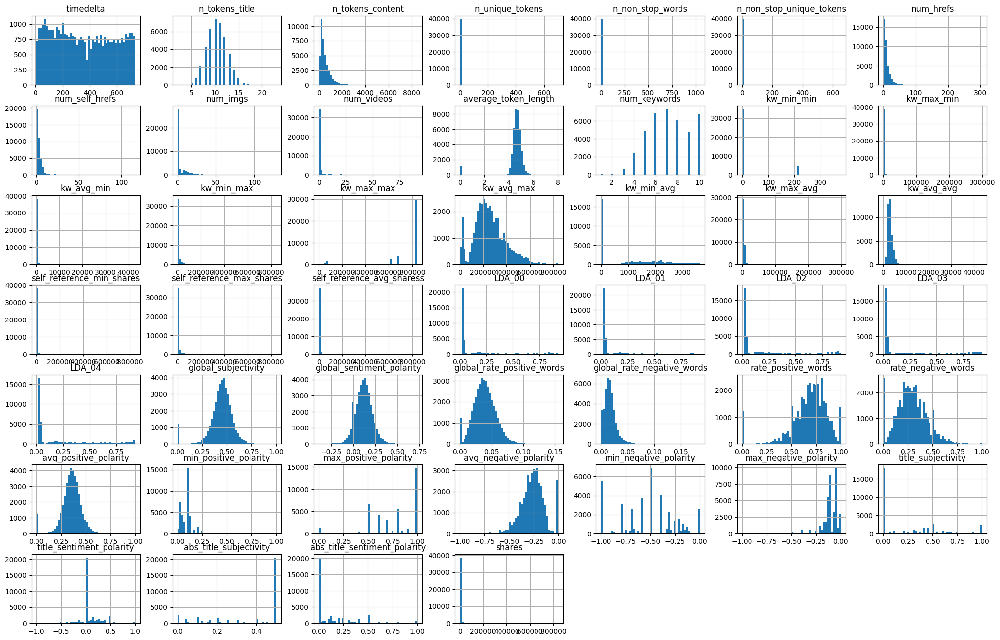

In [12]:
data.drop(columns=binary_columns(data), inplace=False).hist(bins=50, figsize= (25,16))
plt.show()

<span style="font-size:16px;">As we can see, there are many columns with outliers. It is here more visible but if we look at the describe table carefully, we find these outliers by looking at the min, the max, and the mean of the relevant columns.</span>

<span style="font-size:16px;">We can see that the column 'shares' seems to be very impacted, and it is our target so we are going to deal with its outliers.</span>

## **Shares column (our target)**

<span style="font-size:18px;">The column 'shares' is our target, it is the feature that we tend to predict with the other predictives features. So this column is very important and we saw a lot of extreme values so we have to clean it.</span>

<span style="font-size:18px;">Let's test different methods in order to make our choice in the outliers handling.</span>

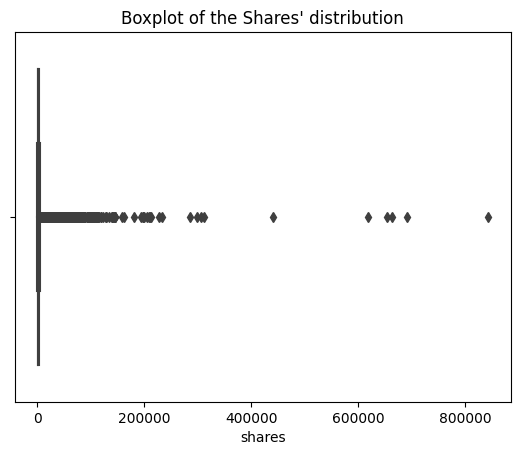

In [13]:
sns.boxplot(x = data['shares'])
plt.title("Boxplot of the Shares' distribution")
#plt.xlim(0,15000)
plt.show()

<span style="font-size:16px;">'Shares' is our target, and as we can see, there are a lot of outliers so we need to find a method to fix this.</span>

### **Using Quartiles**

In [14]:
print("Quantile 90% :",data['shares'].quantile(0.9))
print("Number of rows above 90% :", data[data['shares']>data['shares'].quantile(0.9)].shape[0]," so about ",round(data[data['shares']>data['shares'].quantile(0.9)].shape[0]*100/len(data),2),"% of the dataset.\n")
print("Quantile 75% :",data['shares'].quantile(0.75))
print("Number of rows above 75% :", data[data['shares']>data['shares'].quantile(0.75)].shape[0]," so about ",round(data[data['shares']>data['shares'].quantile(0.75)].shape[0]*100/len(data),2),"% of the dataset.\n")
print("Quantile 1% :",data['shares'].quantile(0.01))
print("Number of rows under 1% :", data[data['shares']<data['shares'].quantile(0.01)].shape[0]," so about ",round(data[data['shares']<data['shares'].quantile(0.01)].shape[0]*100/len(data),2),"% of the dataset.")

Quantile 90% : 6200.0
Number of rows above 90% : 3946  so about  9.95 % of the dataset.

Quantile 75% : 2800.0
Number of rows above 75% : 9630  so about  24.29 % of the dataset.

Quantile 1% : 381.0
Number of rows under 1% : 394  so about  0.99 % of the dataset.


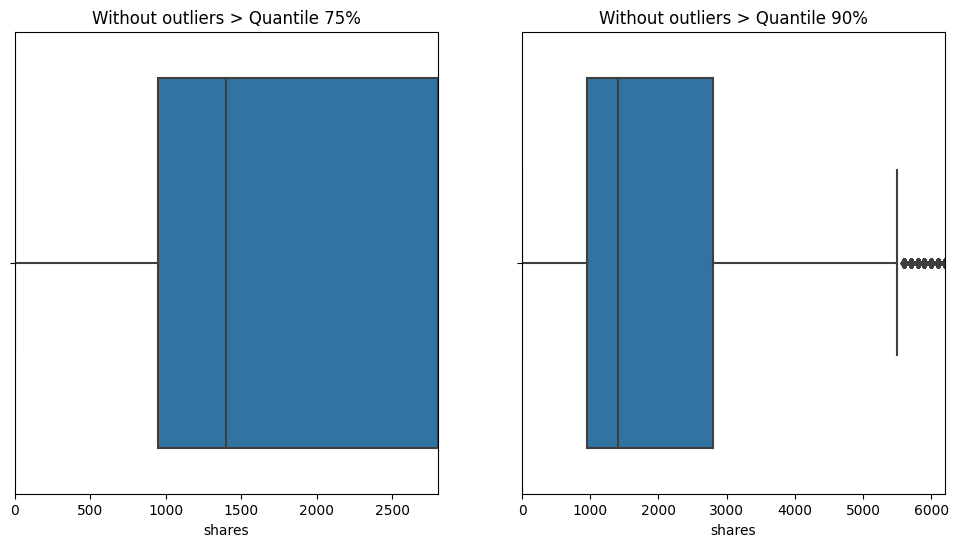

In [15]:
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(12,6))
sns.boxplot(x = data['shares'], ax=ax1)
ax1.set_xlim(0,data['shares'].quantile(0.75))
ax1.set_title("Without outliers > Quantile 75%")
sns.boxplot(x = data['shares'], ax=ax2)
ax2.set_xlim(0,data['shares'].quantile(0.9))
ax2.set_title("Without outliers > Quantile 90%")
plt.show()

### **Using IQR Rule**

<span style="font-size:18px;">The IQR (Interquartile Range) rule is a statistical method used to detect outliers in a dataset. The IQR is a measure of dispersion that represents the difference between the first quartile (Q1) and the third quartile (Q3) of a dataset.</span>

In [16]:
Q1 = data['shares'].quantile(0.25)
Q3 = data['shares'].quantile(0.75)
IQR = Q3-Q1
print("Value at the quantile 25%:",Q1)
print("Value at the quantile 75%:",Q3)
print("Value of the difference between these two quantiles:" ,IQR)

Value at the quantile 25%: 946.0
Value at the quantile 75%: 2800.0
Value of the difference between these two quantiles: 1854.0


In [17]:
lower_lim_shares = Q1 - (1.5 * IQR)
upper_lim_shares = Q3 + 1.5 * IQR
print("Lower limit :",lower_lim_shares)
print("Upper limit :",upper_lim_shares)
upper_quantile_shares = data[data['shares']>upper_lim_shares].shape[0]/len(data)
print("\nThe upper quantile for 'upper_lim' :",100-(upper_quantile_shares*100),"%")
print("Number of rows above upper_quantile :", data[data['shares']>data['shares'].quantile(1-upper_quantile_shares)].shape[0])

Lower limit : -1835.0
Upper limit : 5581.0

The upper quantile for 'upper_lim' : 88.54555544344667 %
Number of rows above upper_quantile : 4541


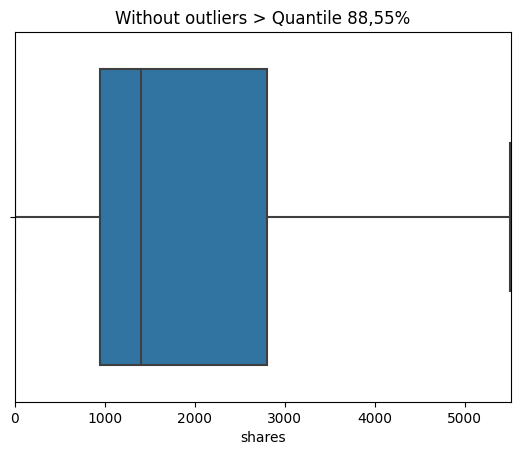

In [18]:
sns.boxplot(x = data['shares'])
plt.xlim(0,data['shares'].quantile(1-upper_quantile_shares))
plt.title("Without outliers > Quantile 88,55%")
plt.show()

### **Using Z-Score**

<span style="font-size:18px;">The Z-Score, also known as the standardized score, is a statistical measure that indicates how far a data point is from the mean of a dataset, expressed in terms of standard deviation. It is calculated by subtracting the mean of the data and dividing the result by the standard deviation</span>

Outliers size (number of rows) : 308 so about 0.78 % of the dataset.


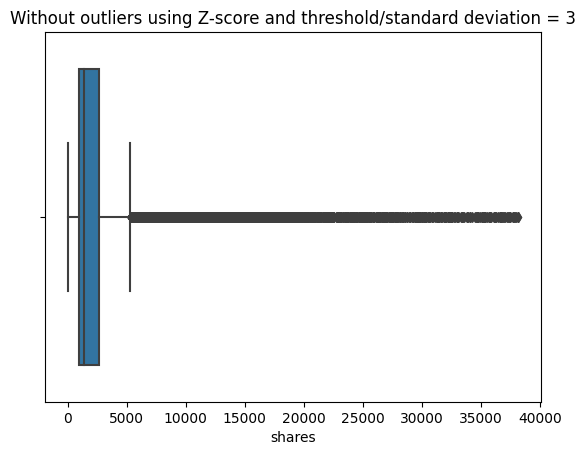

In [19]:
z = np.abs(stats.zscore(data['shares']))
threshold = 3 #classic threshold, but even if 1, the outliers are still too present
outliers = data[z > threshold]
without_outliers = data[z <= threshold]
print("Outliers size (number of rows) :",outliers.shape[0], "so about",round(outliers.shape[0]*100/len(data),2),"% of the dataset.")
sns.boxplot(x=without_outliers['shares'])
plt.title("Without outliers using Z-score and threshold/standard deviation = 3")
plt.show()

<span style="font-size:16px;">As we can see, this method still keep to many outliers.</span>
    
<span style="font-size:16px;">And treating the outliers with only the quantiles is not accurate because its arbitrary and its not a regular method. However, the IQR Rule seems to be very practical and the method looks very regular and well tailored for your data.</span>

In [20]:
data = data[data['shares']<=data['shares'].quantile(1-upper_quantile_shares)]
data.shape

(35103, 61)

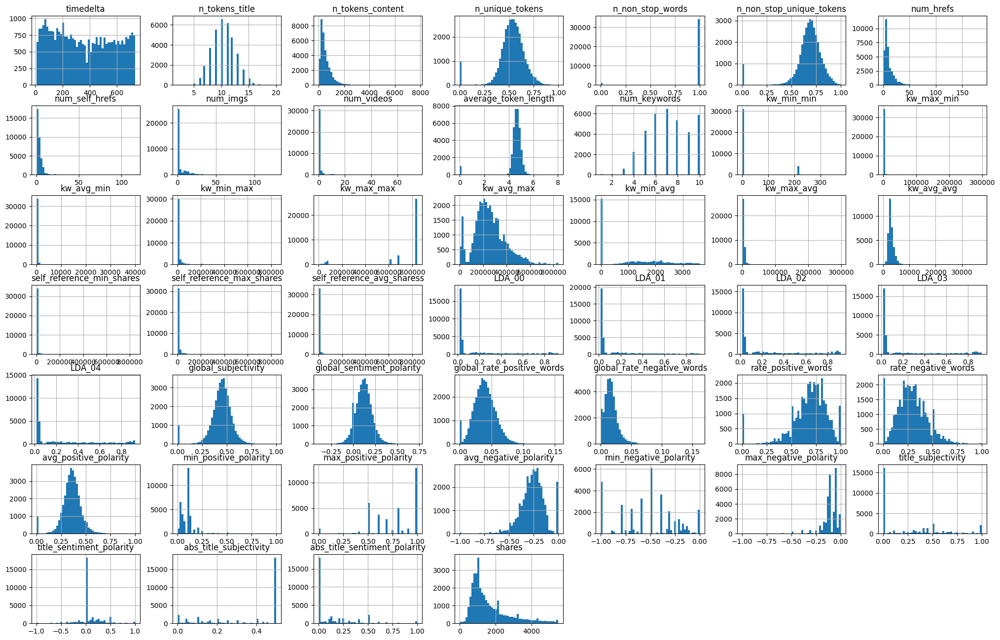

In [21]:
data.drop(columns=binary_columns(data), inplace=False).hist(bins=50, figsize= (25,16))
plt.show()

<span style="font-size:16px;">'shares' has been corrected, and very few others, but the majority still shows some outliers.</span>

## **IQR Rule Method**

In [22]:
def IQRrule(cols):
    parameters={}
    for col in cols :
        Q1=data[col].quantile(0.25)
        Q3=data[col].quantile(0.75)
        IQR=Q3-Q1
        lower_lim = round((Q1 - (1.5 * IQR)),2)
        upper_lim = round((Q3 + (1.5 * IQR)),2)

        decimal = str(upper_lim).split('.')[1][0]
        if int(decimal) >=5:
          upper_lim = math.ceil(upper_lim)
        else:
          upper_lim = math.floor(upper_lim)

        decimal = str(lower_lim).split('.')[1][0]
        if int(decimal) >=5:
          lower_lim = math.floor(lower_lim)
        else :
          lower_lim = math.ceil(lower_lim)
        print(f"For '{col}' :\nLower limit :",lower_lim)
        print("Upper limit :",upper_lim)
        upper_quantile = data[data[col]>upper_lim].shape[0]/len(data)
        lower_quantile = data[data[col]<lower_lim].shape[0]/len(data)
        print("The upper quantile for 'upper_lim' :",100-(upper_quantile*100),"%")
        print("The upper quantile for 'lower_lim' :",(lower_quantile*100),"%\n")

        parameters[col]=[upper_lim,lower_lim,upper_quantile,lower_quantile]
    return parameters

## **Drop column method**

In [23]:
def DropColumn(df, cols):
    for col in cols:
        if col not in df.columns:
            cols.remove(col)
            print(f"{col} wasn't in the DataFrame.")
    if len(cols)==0:
        print('Nothing has been deleted.')
    else:
        df.drop(cols, axis=1, inplace=True)

<span style="font-size:18px;">**In the presentation of the dataset, it is quite easy to notice that groups of features stand out.**</span>

<span style="font-size:18px;">From now on, we will deal with them, because as we saw previously with the feature distributions, there are still many outliers, and we will also check the correlation between the variables of these groups.</span>


<span style="font-size:18px;">The objective is also, if possible, to correct outlier values, and to minimize the number of columns as best as possible to keep only what may be relevant for our analyzes and our future model.</span>

## **Token Columns**

2: n_tokens_title:                Number of words in the title

3: n_tokens_content:              Number of words in the content

4: n_unique_tokens:               Rate of unique words in the content

5: n_non_stop_words:              Rate of non-stop words in the content

6: n_non_stop_unique_tokens:      Rate of unique non-stop words in the                                   content

11: average_token_length:          Average length of the words in the content


In [24]:
token_columns = ['n_tokens_title',
                 'n_tokens_content',
                 'n_unique_tokens',
                 'n_non_stop_words',
                 'n_non_stop_unique_tokens',
                 'average_token_length']

In [25]:
data[token_columns].describe()

,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,average_token_length
count,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000
mean,10.402330,546.791699,0.531275,0.972367,0.674805,4.560363
std,2.108118,462.714379,0.134254,0.163921,0.150249,0.817241
min,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9.000000,250.000000,0.471815,1.000000,0.627586,4.481877
50%,10.000000,414.000000,0.538721,1.000000,0.691176,4.668421
75%,12.000000,715.000000,0.607018,1.000000,0.754545,4.858998
max,20.000000,7764.000000,1.000000,1.000000,1.000000,8.041534


<span style="font-size:16px;">We can see that the distribution of 'n_non_stop_words' seems strange. Let's investigate.</span>

### Focus on 'n_non_stop_words'

In [26]:
print(data['n_non_stop_words'].value_counts().head(10))
print(data['n_non_stop_words'].unique())

0.0    970
1.0    122
1.0    121
1.0    120
1.0    117
1.0    114
1.0    113
1.0    113
1.0    113
1.0    112
Name: n_non_stop_words, dtype: int64
[0.99999999 0.99999999 0.99999999 ... 1.         1.         1.        ]


<span style="font-size:16px;">'n_non_stop_words' is a rate, but as we can see, there are 1181 values to 0.0, and a lot of values to 1.0, but not exactly the same 1.0. If we look closer to the unique values, there are 1451 unique values but so close to 1 (float : 0.999999...) that almost all the articles have 100% of non_stop_words.</span>

<span style="font-size:16px;">Actually, a stop word is in Natural Language Processing, a set of commonly used words in any language. For example in English :</span>

>  <span style="font-size:16px;">a, the, and , or , of , on , this , we , were, is, not...</span>

<span style="font-size:16px;">So the thing that for 1181 articles, the rate of non-stop word is 0% is impossible. Secondly, the thing that almost 100% of an article is a composed of non-stop words is also impossible. So, we suggest to delete this column which seems erroneous and unnecessary to us.</span>

In [27]:
DropColumn(data,['n_non_stop_words'])
token_columns.remove('n_non_stop_words')

### Return to token columns

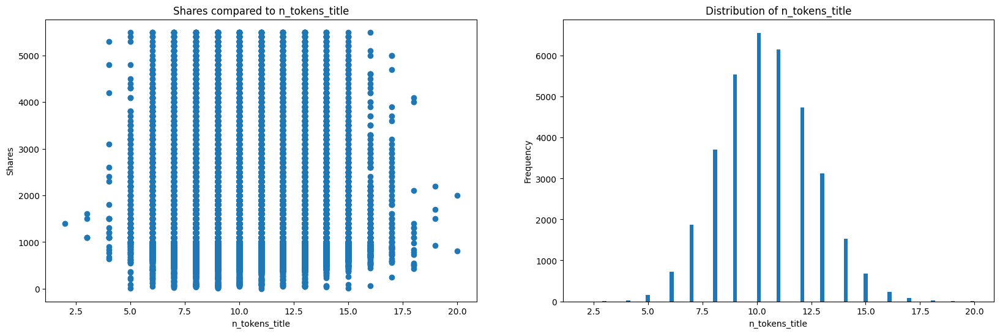

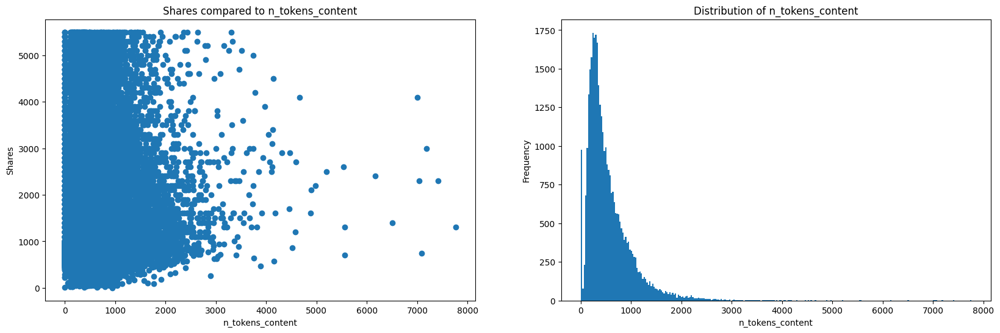

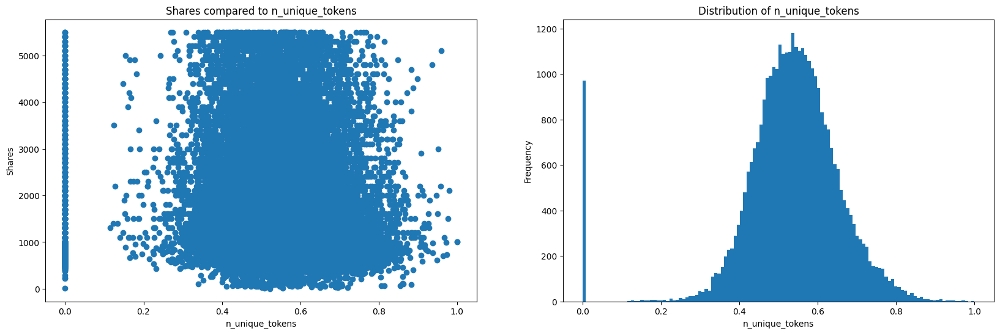

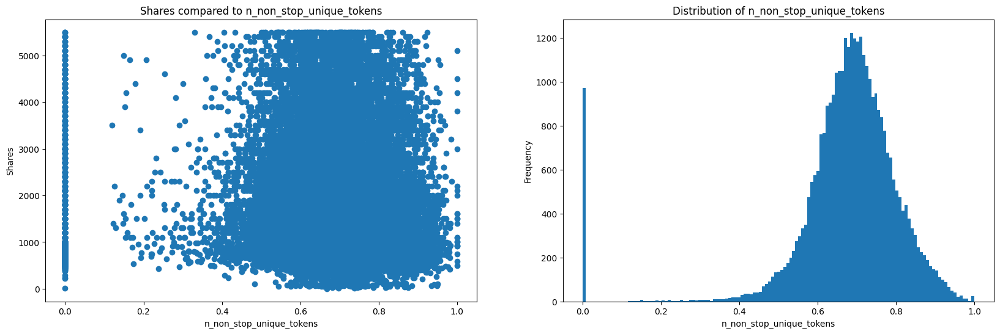

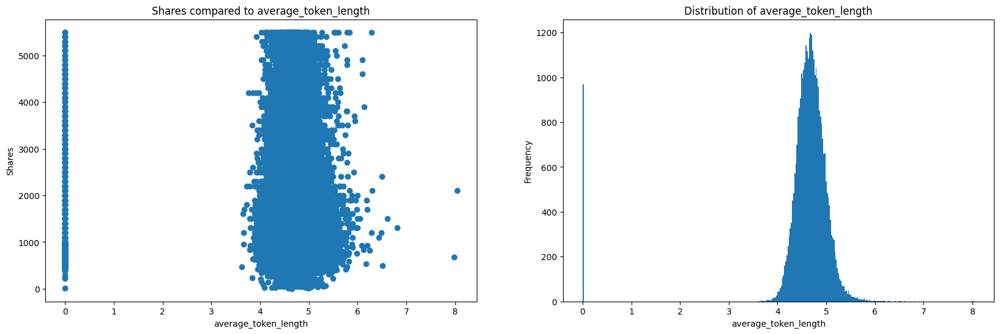

In [28]:
for col in token_columns:
    fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
    ax1.scatter(data[col],data["shares"])
    ax2.hist(data[col],bins='auto')
    ax1.set_xlabel(col)
    ax1.set_ylabel("Shares")
    ax1.set_title(f"Shares compared to {col}")
    ax2.set_xlabel(col)
    ax2.set_ylabel("Frequency")
    ax2.set_title(f"Distribution of {col}")
    plt.show()

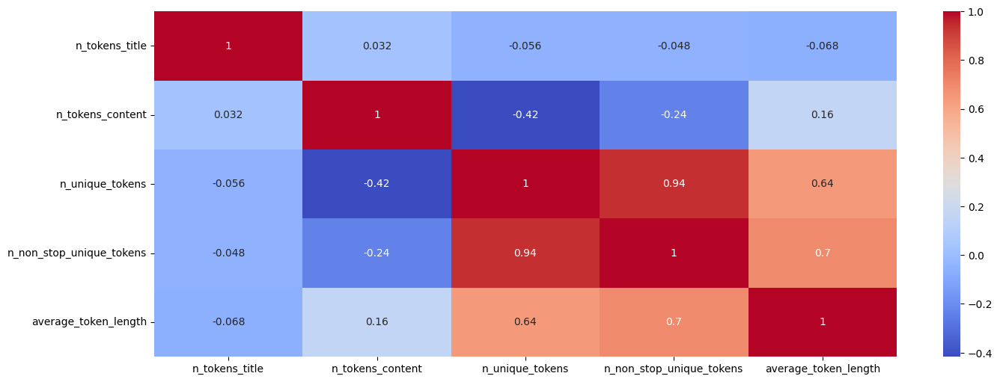

In [29]:
plt.figure(figsize=(16,6))
sns.heatmap(data[token_columns].corr(),cmap="coolwarm",annot=True)
plt.show()

<span style="font-size:16px;">From this correlation matrix, we see that 'n_non_stop_unique_tokens' is highly correlated with 'n_unique_tokens' (0.94). It is obvious because 'n_non_stop_unique_tokens' is the rate of unique non-stop words (normal words) and 'n_unique_tokens' is direclty linked because it is the rate of all kind of words, so encapsuling the non-stop words too. We can say that 'n_non_stop_unique_tokens' is a subspace of 'n_unique_tokens'</span>

<span style="font-size:16px;">**==> We delete 'n_non_stop_unique_tokens'.**</span>

In [30]:
DropColumn(data,['n_non_stop_unique_tokens'])
token_columns.remove('n_non_stop_unique_tokens')

In [31]:
token_columns_no_binary_no_normal_distribution = ['n_tokens_title','n_tokens_content','average_token_length']
IQRparameters = IQRrule(token_columns_no_binary_no_normal_distribution)
IQR_n_tokens_title = IQRparameters['n_tokens_title']
IQR_n_tokens_content = IQRparameters['n_tokens_content']
IQR_avg_token_length = IQRparameters['average_token_length']

For 'n_tokens_title' :
Lower limit : 4
Upper limit : 17
The upper quantile for 'upper_lim' : 99.93162977523289 %
The upper quantile for 'lower_lim' : 0.01709255619177848 %

For 'n_tokens_content' :
Lower limit : -448
Upper limit : 1413
The upper quantile for 'upper_lim' : 95.17705039455318 %
The upper quantile for 'lower_lim' : 0.0 %

For 'average_token_length' :
Lower limit : 3
Upper limit : 5
The upper quantile for 'upper_lim' : 87.73039341366835 %
The upper quantile for 'lower_lim' : 2.763296584337521 %



## **Videos & Images**

In [32]:
pd.set_option('display.max_rows', None)
print("Videos :\n",data['num_videos'].value_counts(),"\n")
print("Images :\n",data['num_imgs'].value_counts())

Videos :
 0.0     22583
1.0      8163
2.0      1862
3.0       460
11.0      226
4.0       213
10.0      184
21.0      158
5.0       136
26.0      113
6.0        99
9.0        88
7.0        80
16.0       79
12.0       69
8.0        68
25.0       62
13.0       61
15.0       58
14.0       55
20.0       51
17.0       46
27.0       26
18.0       22
22.0       19
31.0       14
19.0       14
33.0       13
23.0       10
28.0        9
24.0        9
50.0        5
73.0        5
32.0        4
34.0        4
74.0        4
51.0        4
35.0        3
30.0        3
29.0        3
36.0        2
48.0        2
58.0        2
59.0        2
75.0        2
42.0        2
38.0        2
65.0        1
66.0        1
53.0        1
46.0        1
Name: num_videos, dtype: int64 

Images :
 1.0      16698
0.0       5942
2.0       2705
3.0       1092
11.0       930
10.0       711
4.0        591
6.0        507
12.0       480
9.0        455
13.0       431
8.0        431
5.0        415
15.0       404
7.0        362
14.0    

In [33]:
pd.set_option('display.max_columns', None)
print("For videos :\n",data[data['num_videos']>=10]['url'][:15])
print("\nFor images :\n",data[data['num_imgs']>=10]['url'][:15])

For videos :
 99     http://mashable.com/2013/01/09/blue-umbrella-t...
126         http://mashable.com/2013/01/09/gopro-videos/
181    http://mashable.com/2013/01/10/al-roker-pooped...
190      http://mashable.com/2013/01/10/cats-in-pajamas/
206    http://mashable.com/2013/01/10/ferrell-gosling...
232        http://mashable.com/2013/01/10/orange-beagle/
238        http://mashable.com/2013/01/10/people-winter/
253    http://mashable.com/2013/01/10/why-men-have-ni...
261    http://mashable.com/2013/01/11/a-cappella-remi...
264    http://mashable.com/2013/01/11/basketball-buzz...
292         http://mashable.com/2013/01/11/puppy-stairs/
304    http://mashable.com/2013/01/11/tim-hortons-sin...
310    http://mashable.com/2013/01/11/youtube-office-...
342    http://mashable.com/2013/01/13/joke-cubicle-ma...
400        http://mashable.com/2013/01/14/kid-bulldozer/
Name: url, dtype: object

For images :
 4      http://mashable.com/2013/01/07/att-u-verse-apps/
6     http://mashable.com/2013/01/0

<span style="font-size:16px;">We have tried all these URLs, and any has more than 10 videos, to tell the truth, they often have 0 videos. Sometimes it seems that the video has just been deleted, but if we read the article, it mentions only 1 video, and not 10 or more.</span>

<span style="font-size:16px;">For the images, all these 15 urls are supposed to contain at least 10 images, but in reality, for one link I've counted 3 in maximum, and the rest has 1 or 2 images.</span>

In [34]:
data[data['num_imgs']==0]['url'][:5]

5      http://mashable.com/2013/01/07/beewi-smart-toys/
8     http://mashable.com/2013/01/07/car-of-the-futu...
28    http://mashable.com/2013/01/07/isp02-iphone-ta...
37    http://mashable.com/2013/01/07/man-instagram-i...
39    http://mashable.com/2013/01/07/messi-year-all-...
Name: url, dtype: object

<span style="font-size:16px;">There are 6987 links with 0 image, but if we look at these 5 first links with 0 image in theory, we can clearly see that it's wrong and we can assume that every article has at least 1 image : the cover.</span>

In [35]:
data['num_imgs'] = data['num_imgs'].replace(0, 1)

In [36]:
print("Videos :\n",data['num_videos'].describe(),"\n90%\t   ",data['num_videos'].quantile(0.9),"\n")
print("Images :\n",data['num_imgs'].describe(),"\n90%\t   ",data['num_imgs'].quantile(0.9))

Videos :
 count    35103.000000
mean         1.187762
std          3.962538
min          0.000000
25%          0.000000
50%          0.000000
75%          1.000000
max         75.000000
Name: num_videos, dtype: float64 
90%	    2.0 

Images :
 count    35103.000000
mean         4.505114
std          8.009084
min          1.000000
25%          1.000000
50%          1.000000
75%          3.000000
max        128.000000
Name: num_imgs, dtype: float64 
90%	    13.0


<span style="font-size:16px;">We see that the max and the 75% quantile are very distant. Same for 90%, especially for videos where it's is obvious.</span>

In [37]:
pd.set_option('display.max_colwidth', 100)
data[data['num_videos']==3]['url'][:5]

195                   http://mashable.com/2013/01/10/chilly-gonzales-ipad/
222     http://mashable.com/2013/01/10/kickstart-films-oscars-nominations/
877           http://mashable.com/2013/01/22/the-second-space-race-its-on/
990            http://mashable.com/2013/01/24/faa-stunt-pilot-viral-video/
1230        http://mashable.com/2013/01/28/star-trek-into-darkness-iphone/
Name: url, dtype: object

<span style="font-size:16px;">Exactly the same as above.</span>

In [38]:
pd.set_option('display.max_colwidth', 100)
data[data['num_videos']==1]['url'][0:10]

9                   http://mashable.com/2013/01/07/chuck-hagel-website/
21                     http://mashable.com/2013/01/07/ftc-google-leaks/
30                http://mashable.com/2013/01/07/land-a-job-at-spotify/
37           http://mashable.com/2013/01/07/man-instagram-images-blind/
39                 http://mashable.com/2013/01/07/messi-year-all-goals/
50                             http://mashable.com/2013/01/07/papertab/
59    http://mashable.com/2013/01/07/samsung-2013-ces-press-conference/
66     http://mashable.com/2013/01/07/sharp-unveils-next-gen-igo-hdtvs/
76               http://mashable.com/2013/01/07/vh1-new-logo-plus-sign/
77                    http://mashable.com/2013/01/07/youtube-future-tv/
Name: url, dtype: object

In [39]:
colonnesIQR=['num_videos','num_imgs']
IQRparameters = IQRrule(colonnesIQR)
IQR_vids = IQRparameters['num_videos']
IQR_imgs = IQRparameters['num_imgs']

For 'num_videos' :
Lower limit : -2
Upper limit : 3
The upper quantile for 'upper_lim' : 94.2027746916218 %
The upper quantile for 'lower_lim' : 0.0 %

For 'num_imgs' :
Lower limit : -2
Upper limit : 6
The upper quantile for 'upper_lim' : 79.62282426003475 %
The upper quantile for 'lower_lim' : 0.0 %



Number of rows with 4 or more videos : 2035
Which represents 5.8 % of the dataset.

Number of rows with 7 or more images : 7153
Which represents 20.38 % of the dataset.


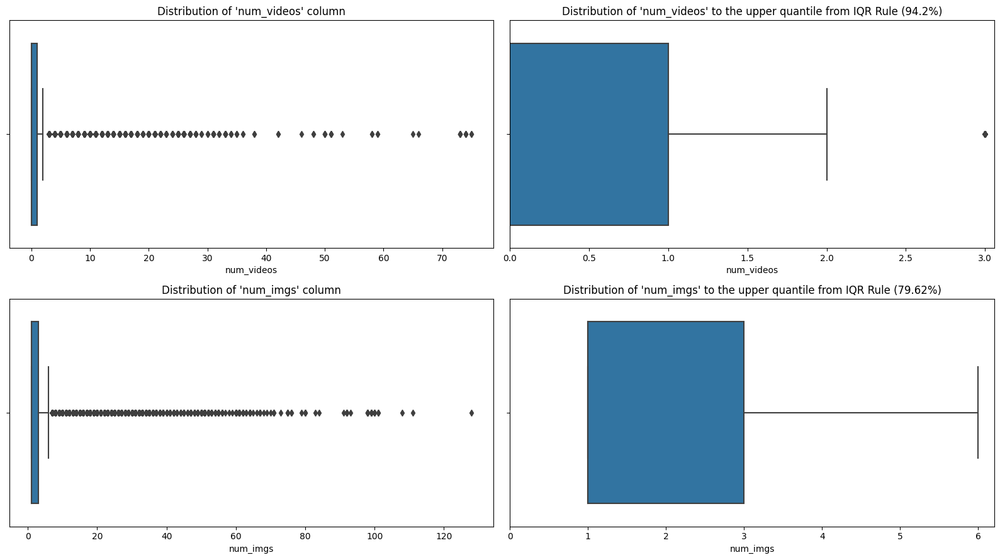

In [40]:
row_vid_count = data[data['num_videos']>IQR_vids[0]].shape[0]
print(f"Number of rows with {IQR_vids[0]+1} or more videos :",row_vid_count)
print("Which represents",round(row_vid_count*100/len(data),2),"% of the dataset.\n")
row_img_count = data[data['num_imgs']>IQR_imgs[0]].shape[0]
print(f"Number of rows with {IQR_imgs[0]+1} or more images :",row_img_count)
print("Which represents",round(row_img_count*100/len(data),2),"% of the dataset.")

fig, axes = plt.subplots(2,2, figsize=(16,9))
sns.boxplot(x=data['num_videos'],ax=axes[0, 0])
axes[0, 0].set_title("Distribution of 'num_videos' column")
sns.boxplot(x=data['num_videos'],ax=axes[0, 1])
axes[0, 1].set_xlim(0,data['num_videos'].quantile(1-IQR_vids[2]))
axes[0, 1].set_title(f"Distribution of 'num_videos' to the upper quantile from IQR Rule ({round(100-(IQR_vids[2]*100),2)}%)")

sns.boxplot(x=data['num_imgs'],ax=axes[1, 0])
axes[1, 0].set_title("Distribution of 'num_imgs' column")
sns.boxplot(x=data['num_imgs'],ax=axes[1, 1])
axes[1, 1].set_xlim(0,data['num_imgs'].quantile(1-IQR_imgs[2]))
axes[1, 1].set_title(f"Distribution of 'num_imgs' to the upper quantile from IQR Rule ({round(100-(IQR_imgs[2]*100),2)}%)")

plt.tight_layout()
plt.show()

In [41]:
commun_bad_rows = data[(data['num_videos']>IQR_vids[0]) & (data['num_imgs']>IQR_imgs[0])].shape[0]
print(f"Number of rows with {IQR_vids[0]+1} or more videos, and {IQR_imgs[0]+1} or more images :",commun_bad_rows)
print("Which represents",round(commun_bad_rows*100/len(data),2),"% of the dataset.\n")

Number of rows with 4 or more videos, and 7 or more images : 197
Which represents 0.56 % of the dataset.



<span style="font-size:16px;">Here, a lot of pourcentage of the dataset has a great chance to have wrong values with videos (5.76%) and with images (19.95%). The crossed 'bad lines' of num_videos and num_imgs only represent XX lines, which is very few and therefore not very useful.</span>

<span style="font-size:16px;">**So we will change the values of those bad rows :**</span>

In [42]:
print("Mean of the 'shares' for articles with 7 or more images :",data[data['num_imgs'] >6]['shares'].mean())
print("Mean of the 'shares' for articles with 6 images max :",data[data['num_imgs'] <=6]['shares'].mean(),"\n")
print("Mean of the 'shares' for articles with 4 or more videos :",data[data['num_videos'] >3]['shares'].mean())
print("Mean of the 'shares' for articles with 3 videos max :",data[data['num_videos'] <=3]['shares'].mean(),"\n")
print("Mean of the 'shares' :",data['shares'].mean(),"\n-----------------------------------------------------------------------------")

print("Median of the 'shares' for articles with 7 or more images :",data[data['num_imgs'] >6]['shares'].median())
print("Median of the 'shares' for articles with 6 images max :",data[data['num_imgs'] <=6]['shares'].median(),"\n")
print("Median of the 'shares' for articles with 4 or more videos :",data[data['num_videos'] >3]['shares'].median())
print("Median of the 'shares' for articles with 3 videos max :",data[data['num_videos'] <=3]['shares'].median(),"\n")
print("Median of the 'shares' :",data['shares'].median())

Mean of the 'shares' for articles with 7 or more images : 1840.925066405704
Mean of the 'shares' for articles with 6 images max : 1628.7341323792486 

Mean of the 'shares' for articles with 4 or more videos : 1692.002457002457
Mean of the 'shares' for articles with 3 videos max : 1670.740020563687 

Mean of the 'shares' : 1671.9726519100932 
-----------------------------------------------------------------------------
Median of the 'shares' for articles with 7 or more images : 1500.0
Median of the 'shares' for articles with 6 images max : 1300.0 

Median of the 'shares' for articles with 4 or more videos : 1300.0
Median of the 'shares' for articles with 3 videos max : 1300.0 

Median of the 'shares' : 1300.0


<span style="font-size:16px;">We can see that non-outliers and outliers values for the number of videos and images, have pretty much the same median and mean, so globally, keep the outliers, or delete them, or capped them or other methods, won't change a lot regarding our target 'shares'.</span>

<span style="font-size:16px;">Because we have the opportunity to make in place webscrapping, thanks to our dataset with a column 'url', we are going to webscrap some pages in order to verify a part of the outliers.</span>

### **Webscraping**

In [43]:
def nb_imgs_url(url):
    response = requests.get(url)
    html = response.content
    soup = BeautifulSoup(html, 'html.parser')
    img_tags = soup.find_all('img')
    num_images = len(img_tags) - 2
    return num_images

def nb_videos_url(url):
    response = requests.get(url)
    html = response.content
    text=str(html)
    return text.count("video-container")/2

In [44]:
#df_imgs_videos_test = data[(data['num_imgs']>7)][0:1000].copy()
#df_imgs_videos_test["true_nb_imgs"] = df_imgs_videos_test['url'].apply(lambda url: nb_imgs_url(url))

# It takes approximately 15 min to run

<span style="font-size:16px;">By using webscrapping we observe that in a sample of 1000 articles with more than 7 images in the dataset, the real values mean is 1,75. Since the average increases with the sample size, we decide to round it to 2, as in any case, the number of images can only be an integer. We could replace the number of images higher than 7 to the webscrapping result mean.</span>

<span style="font-size:16px;">It's almost the same thing for videos :</span>

In [45]:
#df_imgs_videos_test = data[(data['num_videos']>4)][0:1000].copy()
#df_imgs_videos_test["true_nb_videos"] = df_imgs_videos_test['url'].apply(lambda url: nb_videos_url(url))
#df_imgs_videos_test["true_nb_videos"].describe()
# It takes approximately 15 min to run

<span style="font-size:16px;">We verified manually on a dozen URLs, but web scraping confirmed our suspicions. In a sample of 1000 articles with more than 4 videos, all actual values are 0. We decided to replace all values higher than 4 with 0.</span>

<span style="font-size:16px;">Now we don't need 'url' column anymore :</span>

In [46]:
DropColumn(data, ['url'])

## **LDAs and Data channels**

<span style="font-size:16px;">The obvious thing with these features is that each column is binary, and we can therefore group the LDAs together, and the same for the 'Data Channels'.
But before that, let's see if there are similarities between these two groups.</span>

In [47]:
data_no_theme = data[(data['data_channel_is_bus']==0) & (data['data_channel_is_world']==0) & (data['data_channel_is_socmed']==0) & (data['data_channel_is_entertainment']==0) & (data['data_channel_is_tech']==0) & (data['data_channel_is_lifestyle']==0)]
print("Number of articles with no theme mentionned :",data_no_theme.shape[0])
data_no_LDA = data[(data['LDA_00']==0) & (data['LDA_00']==0) & (data['LDA_01']==0) & (data['LDA_02']==0) & (data['LDA_03']==0) & (data['LDA_04']==0)]
print("Number of articles with no LDA mentionned :",data_no_LDA.shape[0])


Number of articles with no theme mentionned : 4793
Number of articles with no LDA mentionned : 0


In [48]:
cols_channel_LDA = ['data_channel_is_lifestyle',
       'data_channel_is_entertainment', 'data_channel_is_bus',
       'data_channel_is_socmed', 'data_channel_is_tech',
       'data_channel_is_world', 'LDA_00',
       'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04']
df_channel_LDA = data[cols_channel_LDA]
print(df_channel_LDA.shape)
df_channel_LDA.head()

(35103, 11)


,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04
0,0.0,1.0,0.0,0.0,0.0,0.0,0.500331,0.378279,0.040005,0.041263,0.040123
1,0.0,0.0,1.0,0.0,0.0,0.0,0.799756,0.050047,0.050096,0.050101,0.050001
2,0.0,0.0,1.0,0.0,0.0,0.0,0.217792,0.033334,0.033351,0.033334,0.682188
3,0.0,1.0,0.0,0.0,0.0,0.0,0.028573,0.419300,0.494651,0.028905,0.028572
4,0.0,0.0,0.0,0.0,1.0,0.0,0.028633,0.028794,0.028575,0.028572,0.885427


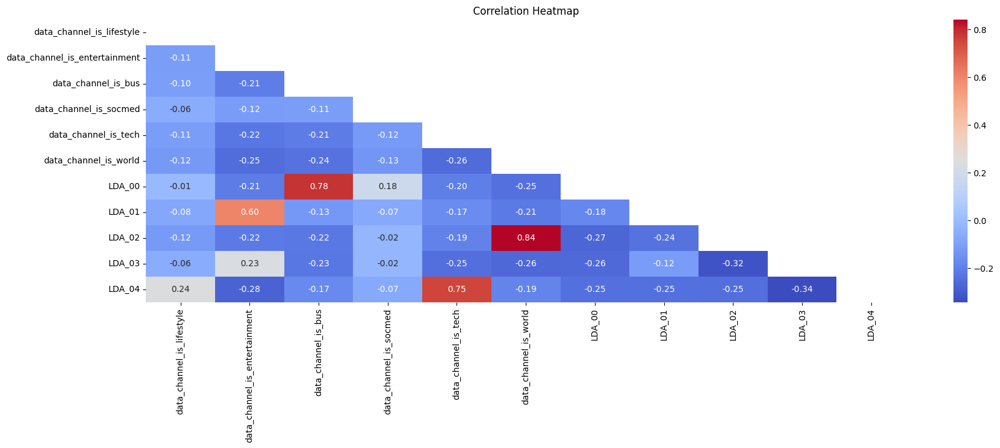

In [49]:
corr = df_channel_LDA.corr()

plt.figure(figsize=(20, 6))
mask = np.triu(np.ones_like(corr, dtype=bool))
ax = sns.heatmap(corr, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, mask=mask)
ax.set_title('Correlation Heatmap')
plt.show()

<span style="font-size:16px;">In NLP, LDA (Latent Dirichlet Allocation) treats each document as a mixture of various topics, and each topic as a distribution of words. It is an unsupervised machine learning algorithm that helps discover hidden topics in a collection of text documents.

<span style="font-size:16px;">The correlation matrix shows that 4 on the 5 LDAs are strongly correlated with some data channels. Maybe because the topics identified by the LDA is about the data channel, so obviously very correlated. In short, LDA is almost a double of data channel in terms of information. Only one (LDA_03) hasn't a very strong correlation but is pretty well negatively correlated with almost all the data_channel, and we find this pattern for all the LDAs more generally.

In [50]:
lda_columns = ["LDA_00", "LDA_01", "LDA_02", "LDA_03", "LDA_04"]
data_channel_columns = ['data_channel_is_lifestyle', 'data_channel_is_entertainment', 'data_channel_is_bus',
                  'data_channel_is_socmed', 'data_channel_is_tech', 'data_channel_is_world']

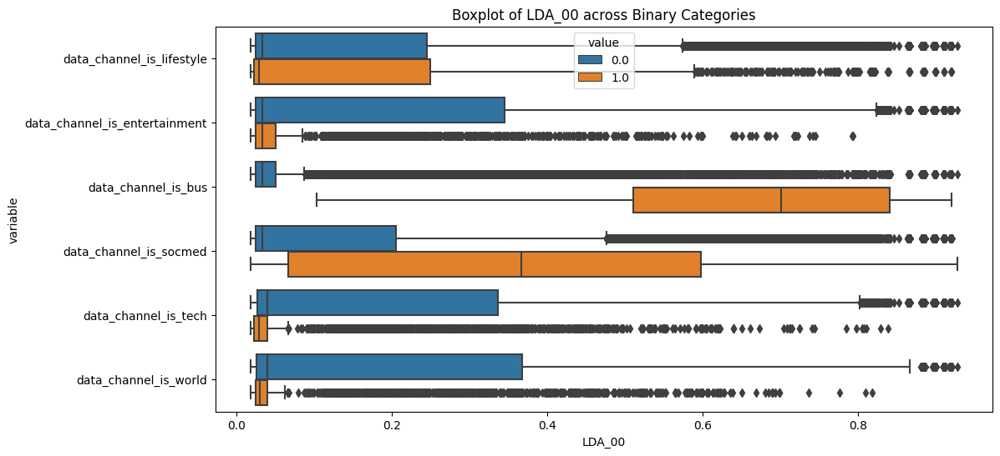

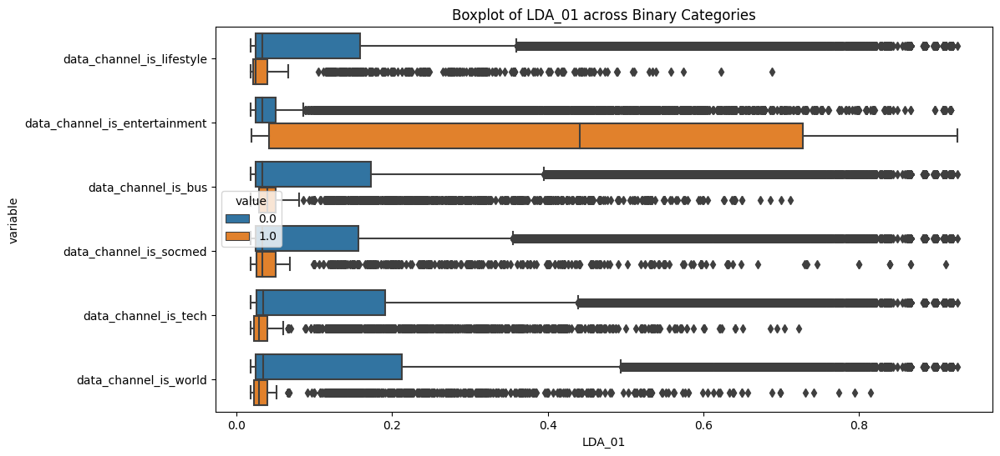

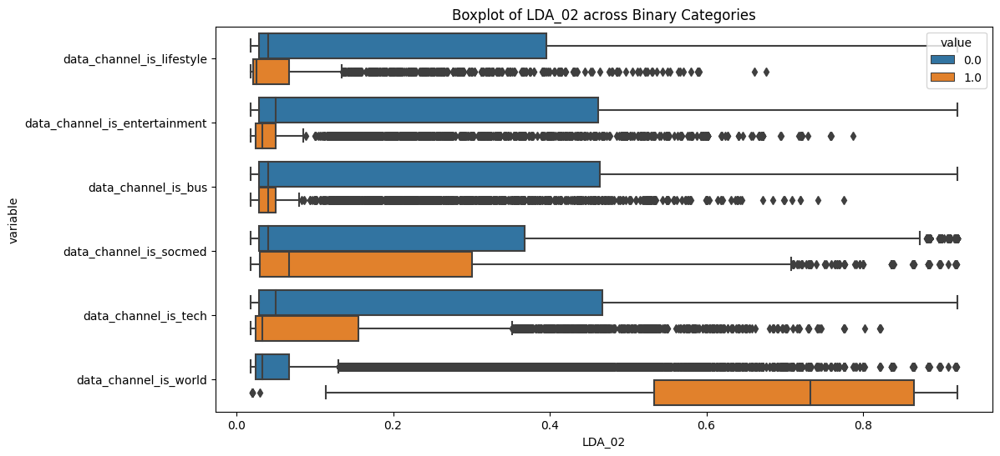

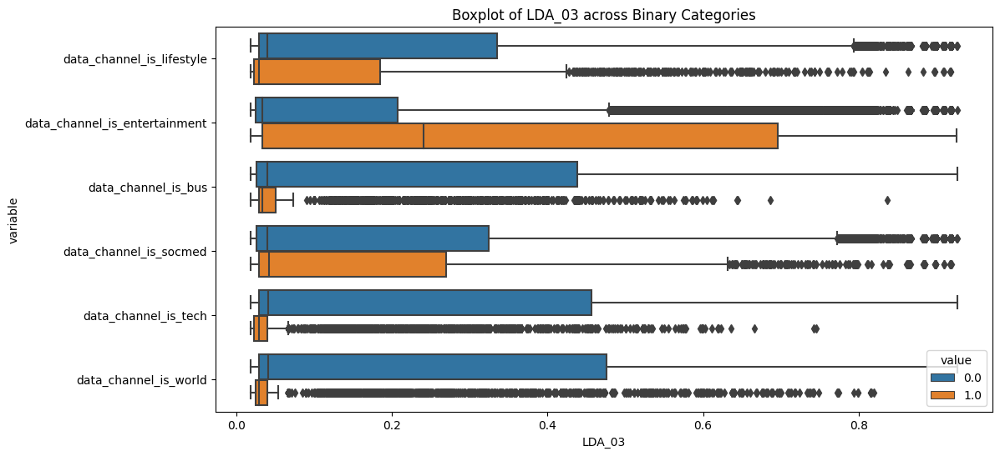

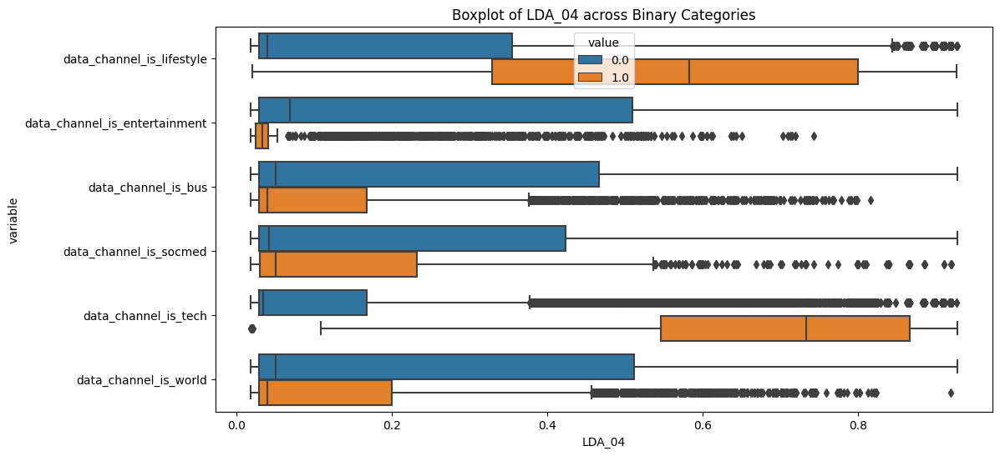

In [51]:
for lda_column in lda_columns:
    plt.figure(figsize=(12, 6))
    sns.boxplot(x=lda_column, y="variable", hue="value", data=pd.melt(df_channel_LDA, id_vars=[lda_column], value_vars=data_channel_columns))
    plt.title(f"Boxplot of {lda_column} across Binary Categories")
    plt.show()

<span style="font-size:16px;">These plots compare the distribution of LDAs for each data_channel. This supports the values of the correlation matrix. Reminder, LDAs' values are binary ==> [0,1]
For the last graph, we clearly see that LDA_04 is has a strong correlation between its distribution of "1" values and the distribution of "1" for data_channel_is_tech, which means that were an article is about data_channel_is_tech, it is also often the case for LDA_04.

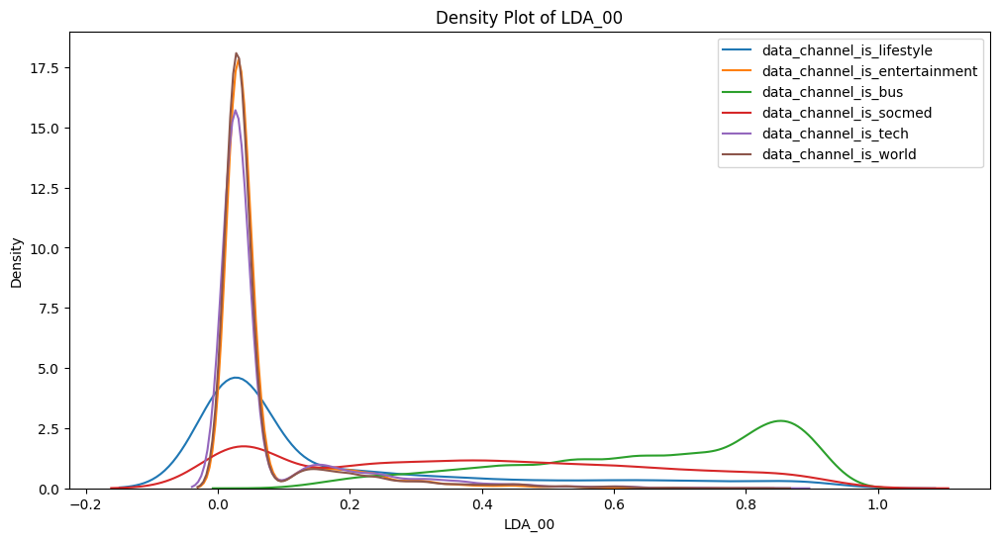

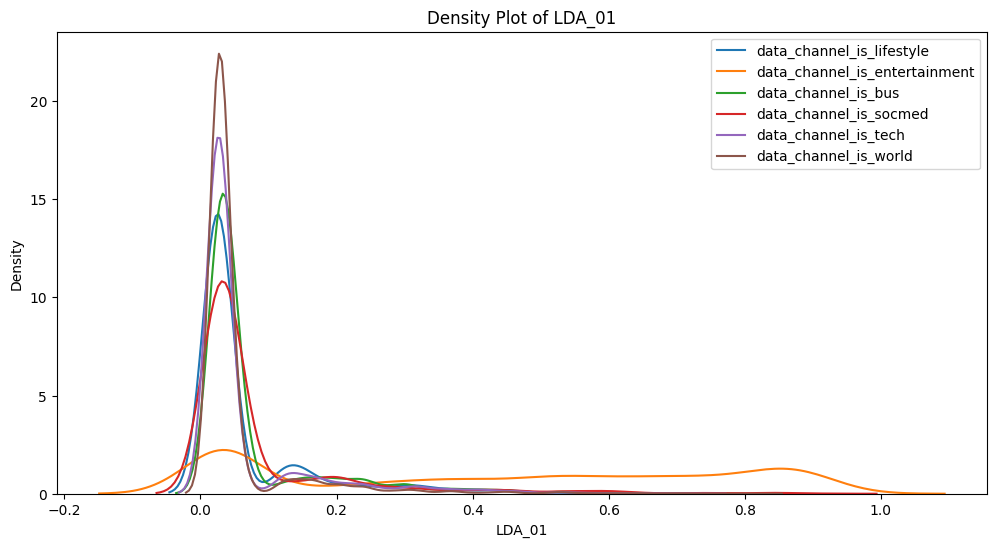

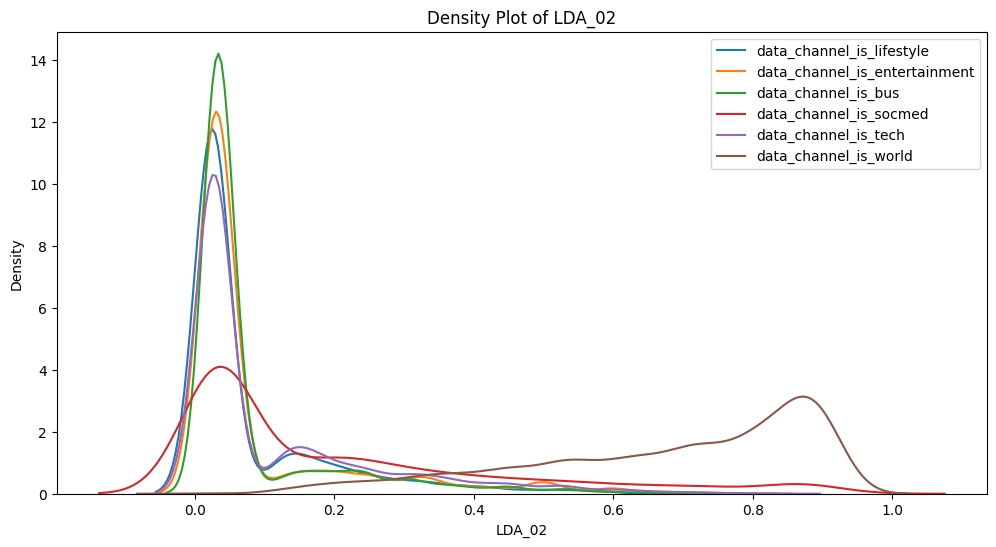

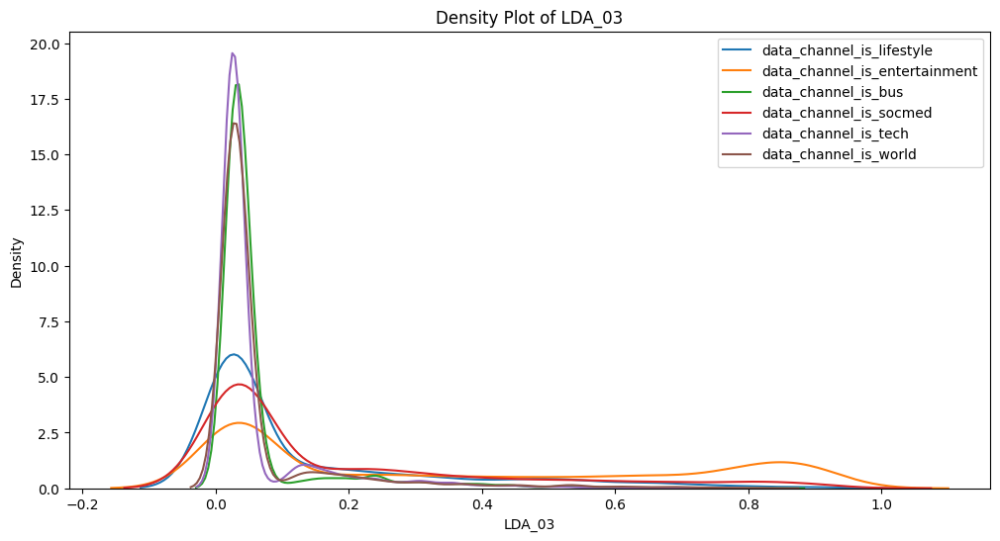

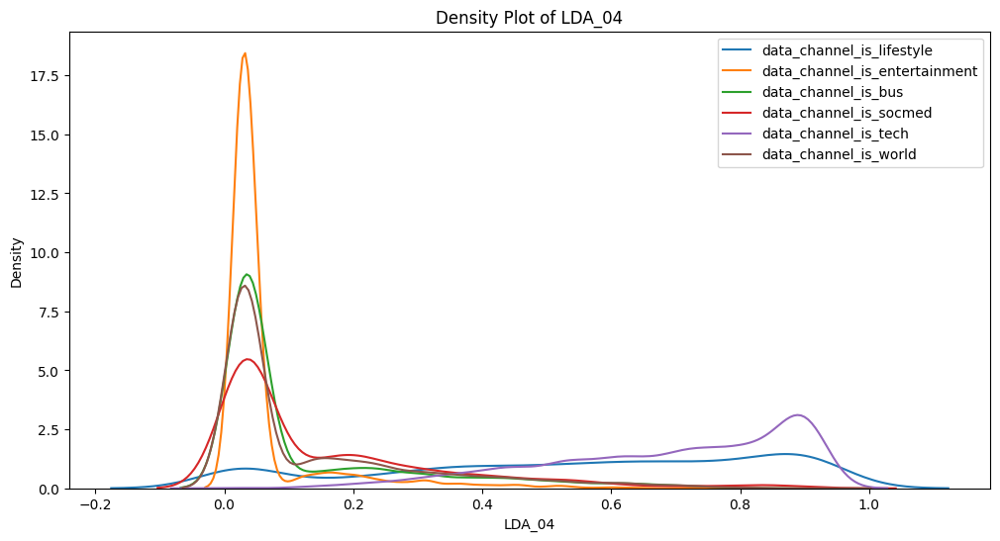

In [52]:
for lda_column in lda_columns:
    plt.figure(figsize=(12, 6))
    for data_channel in data_channel_columns:
        sns.kdeplot(df_channel_LDA[df_channel_LDA[data_channel] == 1][lda_column], label=data_channel)
    plt.title(f"Density Plot of {lda_column}")
    plt.legend()
    plt.show()

<span style="font-size:16px;">As we can see, LDAs and data_channels seem to be correlated, and indeed, they're supposed to because LDA is a result from an unsupervised model that returns the association scores of each article with the themes identified in the article corpus with a score between 0 and 1. But we have 5 LDAs and 6 themes, so it miss a LDA, and because they are strongly correlated, we will only keep the data channels columns.

In [53]:
DropColumn(data, lda_columns)

In [54]:
print(data.shape)
data.head()

(35103, 53)


,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,731.0,12.0,219.0,0.663594,4.0,2.0,1.0,0.0,4.680365,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,496.0,496.0,496.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,731.0,9.0,255.0,0.604743,3.0,1.0,1.0,0.0,4.913725,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.341246,0.148948,0.043137,0.015686,0.733333,0.266667,0.286915,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,731.0,9.0,211.0,0.575130,3.0,1.0,1.0,0.0,4.393365,6.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,918.0,918.0,918.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.702222,0.323333,0.056872,0.009479,0.857143,0.142857,0.495833,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,731.0,9.0,531.0,0.503788,9.0,0.0,1.0,0.0,4.404896,7.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.429850,0.100705,0.041431,0.020716,0.666667,0.333333,0.385965,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,731.0,13.0,1072.0,0.415646,19.0,19.0,20.0,0.0,4.682836,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,545.0,16000.0,3151.157895,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.513502,0.281003,0.074627,0.012127,0.860215,0.139785,0.411127,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


<span style="font-size:16px;">**Finally, because we have dropped the LDAs columns, we now only have to merge the Data Channels columns between them.**

In [55]:
data["theme"] = "Other"

for index, col in enumerate(data_channel_columns):
    for i in range(len(data)):
        if data[col].iloc[i]==1:
            data["theme"].iloc[i]=col[16::].capitalize()


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [56]:
filter_data_channel_theme = ['data_channel_is_lifestyle', 'data_channel_is_entertainment', 'data_channel_is_bus',
'data_channel_is_socmed', 'data_channel_is_tech', 'data_channel_is_world', 'theme']
data[filter_data_channel_theme].head(10)

,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,theme
0,0.0,1.0,0.0,0.0,0.0,0.0,Entertainment
1,0.0,0.0,1.0,0.0,0.0,0.0,Bus
2,0.0,0.0,1.0,0.0,0.0,0.0,Bus
3,0.0,1.0,0.0,0.0,0.0,0.0,Entertainment
4,0.0,0.0,0.0,0.0,1.0,0.0,Tech
5,0.0,0.0,0.0,0.0,1.0,0.0,Tech
6,1.0,0.0,0.0,0.0,0.0,0.0,Lifestyle
7,0.0,0.0,0.0,0.0,1.0,0.0,Tech
8,0.0,0.0,0.0,0.0,1.0,0.0,Tech
9,0.0,0.0,0.0,0.0,0.0,1.0,World


In [57]:
DropColumn(data,data_channel_columns)
print(data.shape)
data.head()

(35103, 48)


,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares,theme
0,731.0,12.0,219.0,0.663594,4.0,2.0,1.0,0.0,4.680365,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,496.0,496.0,496.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593,Entertainment
1,731.0,9.0,255.0,0.604743,3.0,1.0,1.0,0.0,4.913725,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.341246,0.148948,0.043137,0.015686,0.733333,0.266667,0.286915,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711,Bus
2,731.0,9.0,211.0,0.575130,3.0,1.0,1.0,0.0,4.393365,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,918.0,918.0,918.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.702222,0.323333,0.056872,0.009479,0.857143,0.142857,0.495833,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500,Bus
3,731.0,9.0,531.0,0.503788,9.0,0.0,1.0,0.0,4.404896,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.429850,0.100705,0.041431,0.020716,0.666667,0.333333,0.385965,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200,Entertainment
4,731.0,13.0,1072.0,0.415646,19.0,19.0,20.0,0.0,4.682836,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,545.0,16000.0,3151.157895,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.513502,0.281003,0.074627,0.012127,0.860215,0.139785,0.411127,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505,Tech


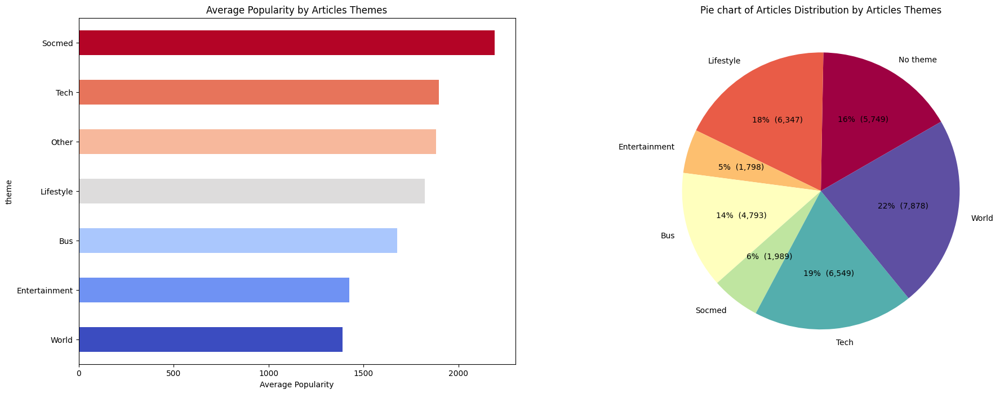

In [58]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(22,8))

num_themes = data['theme'].nunique()
colors_gradient = [plt.cm.coolwarm(i / float(num_themes - 1)) for i in range(num_themes)]
theme_group = data.groupby('theme')['shares'].mean().sort_values(ascending=True)
theme_group.plot(kind='barh', color=colors_gradient, ax=ax1)
ax1.set_xlabel('Average Popularity')
ax1.set_title('Average Popularity by Articles Themes')

theme_counts = data['theme'].value_counts().sort_index()
ax2.pie(theme_counts, labels=['No theme', 'Lifestyle', 'Entertainment', 'Bus', 'Socmed', 'Tech', 'World'],
        autopct=lambda p: '{:.0f}%  ({:,.0f})'.format(p, p * sum(theme_counts) / 100),
        startangle=30, colors=plt.cm.Spectral(np.linspace(0, 1, data['theme'].nunique())))
ax2.set_title('Pie chart of Articles Distribution by Articles Themes')

plt.show()

<span style="font-size:16px;">Here we clearly see that the Social Media theme has the most shares on average, followed by Tech and Lifestyle. But be careful because as the pie shows, Social Media is also one of the less representative theme among all the news that we have, it represents only 5%.
    
<span style="font-size:16px;">We find the theme of the World in last place.

## **Keywords Columns**

In [59]:
keyword_columns = ['kw_min_min', 'kw_max_min', 'kw_avg_min',
                    'kw_min_max', 'kw_max_max', 'kw_avg_max',
                    'kw_min_avg', 'kw_max_avg', 'kw_avg_avg',
                    'num_keywords']
data[keyword_columns].describe()

,kw_min_min,kw_max_min,kw_avg_min,kw_min_max,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,kw_avg_avg,num_keywords
count,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000
mean,26.227758,1121.656082,306.713224,13355.270718,751072.791499,256557.562416,1087.880379,5460.246489,3055.375204,7.199385
std,69.777677,3531.709537,562.447968,57972.540327,216275.867467,133850.741969,1112.085528,5606.053659,1229.135369,1.916833
min,-1.000000,0.000000,-1.000000,0.000000,0.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,-1.000000,444.000000,140.732222,0.000000,843300.000000,171815.476191,0.000000,3530.699709,2351.233028,6.000000
50%,-1.000000,654.000000,234.285714,1400.000000,843300.000000,241825.000000,1002.000000,4230.133333,2815.495983,7.000000
75%,4.000000,1000.000000,355.285714,7400.000000,843300.000000,327461.904762,1991.985437,5851.933367,3489.782146,9.000000
max,377.000000,298400.000000,39979.000000,843300.000000,843300.000000,843300.000000,3610.124972,298400.000000,37607.521654,10.000000


<span style="font-size:16px;">We can see some stange values at the min value : -1

<span style="font-size:16px;">But, because these values (except 'num_keywords') represent 'shares', -1 value is impossible, so first, instead of replacing all the '-1' value, let's think.

<span style="font-size:16px;">First, we see that at least 50% of 'kw_min_min' is at -1, so changing the value seems perfectly useless, and deleting the column seem more appropriate. But if we delete 'kw_min_min', what about 'kw_max_min', the maximum shares of the worst keyword ? Because they are direclty linked. We also see that kw_max_min contains outliers because its maximum value is 298 400 shares that we have treated before.

<span style="font-size:16px;">Secondly, we also see many outliers for kw_max_max, with at leats 75% of 843 300 shares. kw_avg_max has also many outliers, so we can suppose that both are pretty correlated. But globally, the distribution is pretty weird.

<span style="font-size:16px;">Ok, we continue and will see. Let's dive into the correlation matrix to see if we can do something.

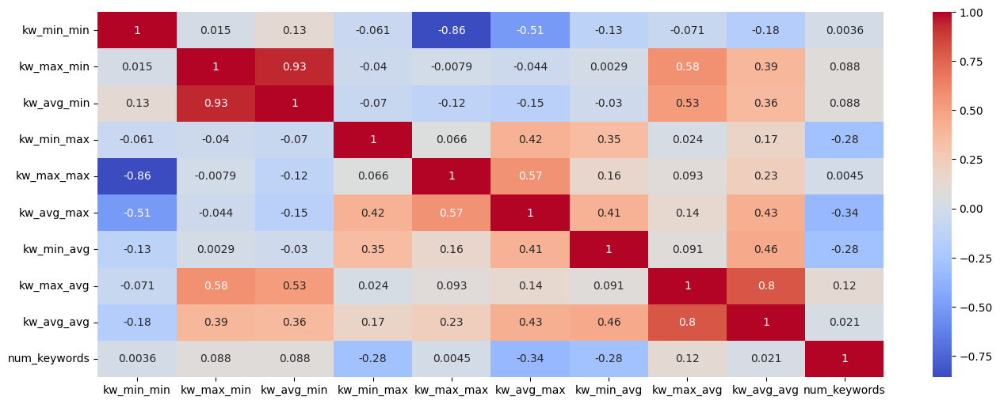

In [60]:
plt.figure(figsize=(16,6))
sns.heatmap(data[keyword_columns].corr(),cmap="coolwarm",annot=True)
plt.show()

**The greatest correlations :**

<span style="font-size:16px;">~~kw_min_min~~ - kw_max_max : -0.86


<span style="font-size:16px;">~~kw_max_min~~ - kw_avg_min : 0.93 && ~~kw_max_min~~ - kw_max_avg : 0.58 (which is pretty high)

<span style="font-size:16px;">~~kw_max_max~~ - kw_avg_max : 0.57

<span style="font-size:16px;">kw_max_avg - kw_max_min : 0.58 && kw_max_avg - kw_avg_avg : 0.8

<span style="font-size:16px;">Because kw_min_min is a largely false, unusable column, we decide to delete it.
<span style="font-size:16px;">Then, kw_max_min is highly correlated to kw_avg_min, so by logic, if we delete the min component, we are not going to delete the avg component to keep the max, we prefer to keep the avg component that is a mix of min and max, so it contains both (theorically). So we delete kw_max_min.


<span style="font-size:16px;">Then, if we keep the same logic, kw_max_max is also unexploitable, there are too many outliers, so by default we want to delete it, we see that its pretty correlated with its avg component (0.57), so we delete it, and kw_min_max is 0.42 correlated with the avg component, and 0.35 with the kw_min_avg, the average of all min component, and by the same logic as before, the avg component is supposed to contain both information about min and max. We delete kw_min_max.

<span style="font-size:16px;">Now, we are facing an issue. For both the best and worst keywords, it was always the maximum component which was most correlated with that of the average. Now, it is the same for the average keyword, but the correlation is very high (0.8), and if we subsequently want to make regression models for example, which are sensitive to multicollinearity, we must make a choice and delete a component :

> <span style="font-size:16px;">kw_avg_avg - kw_max_avg : 0.8 && kw_avg_avg - kw_min_avg : 0.46

> <span style="font-size:16px;">kw_max_avg - kw_avg_avg : 0.8 && kw_max_avg - kw_min_avg : 0.091

In [61]:
cols_kw_to_drop=['kw_min_min','kw_max_min','kw_min_max','kw_max_max']
DropColumn(data,cols_kw_to_drop)

In [62]:
keyword_columns = list(set(keyword_columns) - set(cols_kw_to_drop))
IQRparameters = IQRrule(keyword_columns)

For 'kw_avg_min' :
Lower limit : -181
Upper limit : 677
The upper quantile for 'upper_lim' : 94.87223314246646 %
The upper quantile for 'lower_lim' : 0.0 %

For 'kw_min_avg' :
Lower limit : -2988
Upper limit : 4980
The upper quantile for 'upper_lim' : 100.0 %
The upper quantile for 'lower_lim' : 0.0 %

For 'num_keywords' :
Lower limit : 1
Upper limit : 14
The upper quantile for 'upper_lim' : 100.0 %
The upper quantile for 'lower_lim' : 0.0 %

For 'kw_avg_max' :
Lower limit : -61654
Upper limit : 560932
The upper quantile for 'upper_lim' : 97.51588183346152 %
The upper quantile for 'lower_lim' : 0.0 %

For 'kw_max_avg' :
Lower limit : 48
Upper limit : 9334
The upper quantile for 'upper_lim' : 94.07173176081817 %
The upper quantile for 'lower_lim' : 0.21080819303193457 %

For 'kw_avg_avg' :
Lower limit : 644
Upper limit : 5198
The upper quantile for 'upper_lim' : 95.85790388285902 %
The upper quantile for 'lower_lim' : 0.2307495085890095 %



<span style="font-size:16px;">As we said above, 'kw_avg_max' has many outliers.
> **Remember that these columns' values are like 'shares' values. So, if we want to remain consistent, you shouldn't go for the upper limit of each column from IQR rule, but we should follow the limits that we used to treat the outliers of 'shares'**

In [63]:
print("Upper limit for 'shares' :",upper_lim_shares)
rows_count_avgmax_beyond_upperlimshares = data[data['kw_avg_max']>upper_lim_shares].shape[0]
print("Number of rows where 'kw_avg_max' is beyond the upper limit of 'shares' :",rows_count_avgmax_beyond_upperlimshares)
print("Which represent",100*rows_count_avgmax_beyond_upperlimshares/len(data),"% of the dataset.\n")
rows_count_maxavg_beyond_upperlimshares = data[data['kw_max_avg']>upper_lim_shares].shape[0]
print("Number of rows where 'kw_max_avg' is beyond the upper limit of 'shares' :",rows_count_maxavg_beyond_upperlimshares)
print("Which represent",100*rows_count_maxavg_beyond_upperlimshares/len(data),"% of the dataset.\n")

Upper limit for 'shares' : 5581.0
Number of rows where 'kw_avg_max' is beyond the upper limit of 'shares' : 34980
Which represent 99.64960259806854 % of the dataset.

Number of rows where 'kw_max_avg' is beyond the upper limit of 'shares' : 9992
Which represent 28.464803578041764 % of the dataset.



<span style="font-size:16px;">We can see that almost all values of the dataset for the column 'kw_avg_max' are wrong. We can't treat the outliers so the only solution is to delete the column.

<span style="font-size:16px;">But, if we delete all the information about the best keywords, does it make sense to keep the average shares of the worst keywords ? I think that in this case, you should only keep the Average Keyword

In [64]:
DropColumn(data, ['kw_avg_max', 'kw_avg_min'])
keyword_columns.remove('kw_avg_max')
keyword_columns.remove('kw_avg_min')

In [65]:
data['kw_min_avg'].replace(-1, 0, inplace=True)

## **References Columns**

7: num_hrefs:                     Number of links

8: num_self_hrefs:                Number of links to other articles published by Mashable

28: self_reference_min_shares:     Min. shares of referenced articles in Mashable

29: self_reference_max_shares:     Max. shares of referenced articles in  Mashable

30: self_reference_avg_sharess:    Avg. shares of referenced articles in Mashable


In [66]:
reference_columns =  ['num_hrefs','num_self_hrefs','self_reference_min_shares','self_reference_max_shares','self_reference_avg_sharess']

In [67]:
data[reference_columns].describe()

,num_hrefs,num_self_hrefs,self_reference_min_shares,self_reference_max_shares,self_reference_avg_sharess
count,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000
mean,10.584423,3.297126,3609.750298,9563.299056,5861.762346
std,10.771551,3.847926,19058.826160,39430.352206,23389.533674
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.000000,1.000000,622.000000,1000.000000,952.250000
50%,7.000000,3.000000,1200.000000,2700.000000,2100.000000
75%,13.000000,4.000000,2400.000000,7400.000000,4753.954545
max,187.000000,116.000000,843300.000000,843300.000000,843300.000000


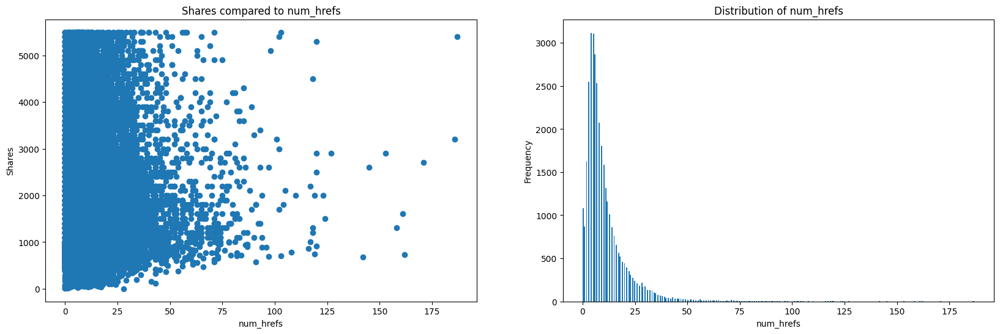

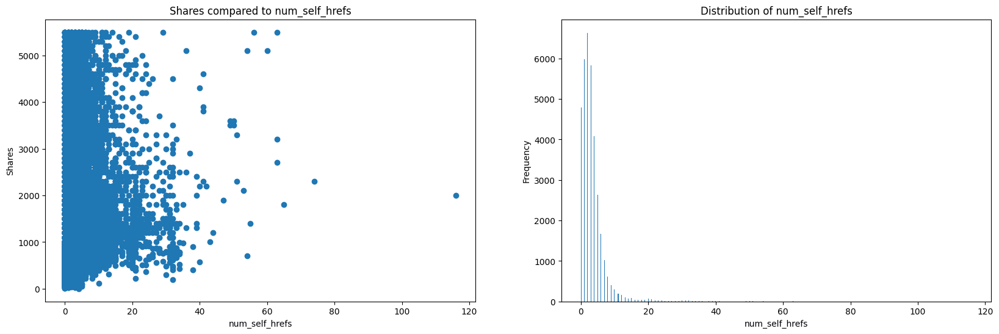

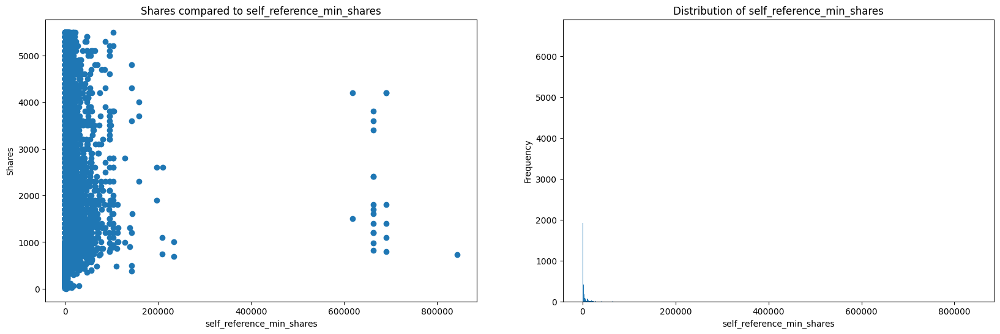

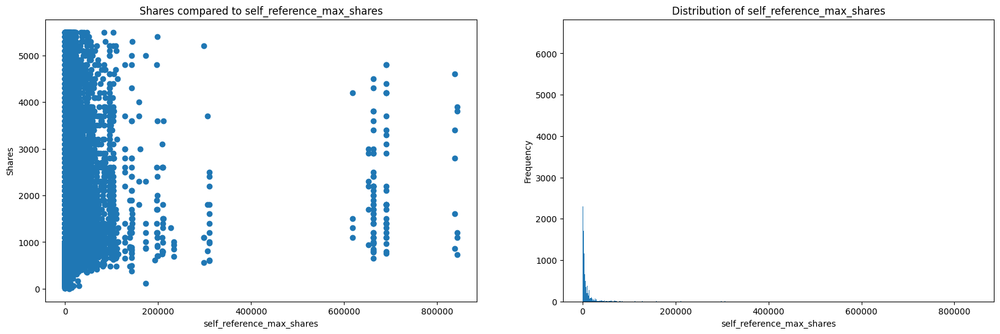

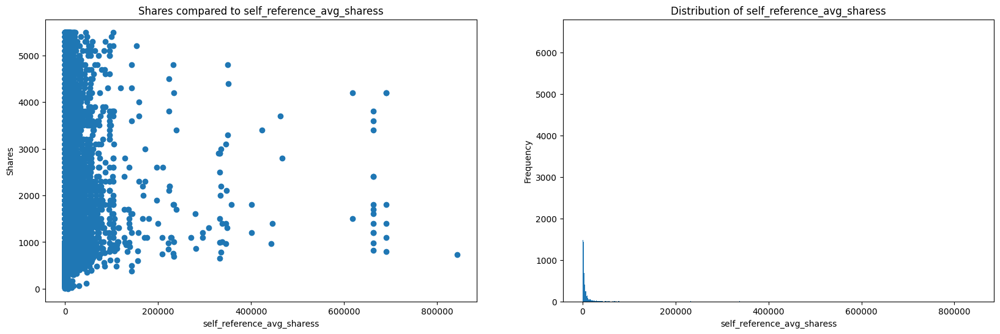

In [68]:
for col in reference_columns:
    fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
    ax1.scatter(data[col],data["shares"])
    ax2.hist(data[col],bins='auto')
    ax1.set_xlabel(col)
    ax1.set_ylabel("Shares")
    ax1.set_title(f"Shares compared to {col}")
    ax2.set_xlabel(col)
    ax2.set_ylabel("Frequency")
    ax2.set_title(f"Distribution of {col}")
    plt.show()


<span style="font-size:16px;">We can see that evry column has many outliers. We will fix that later.

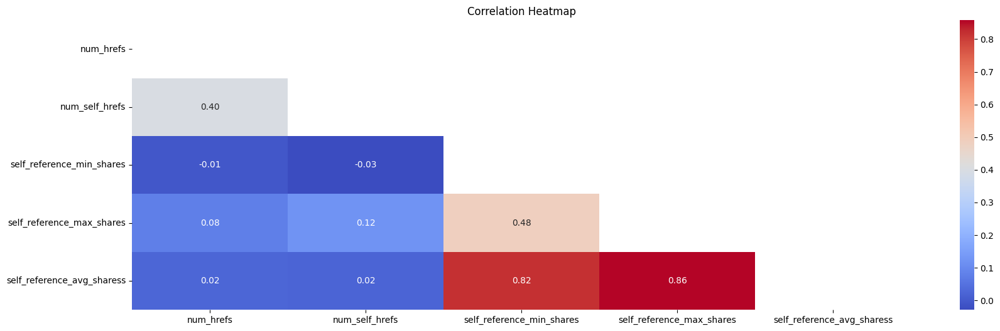

In [69]:
corr_self_references = data[reference_columns].corr()

plt.figure(figsize=(20, 6))
mask = np.triu(np.ones_like(corr_self_references, dtype=bool))
ax = sns.heatmap(corr_self_references, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, mask=mask)

ax.set_title('Correlation Heatmap')

plt.show()

<span style="font-size:16px;">Ok, we clearly see that self_reference_avg is highly correlated with self_reference_min and self_reference_max. So we decide to delete the min and max components of self_reference.

In [70]:
DropColumn(data,['self_reference_max_shares','self_reference_min_shares'])
reference_columns.remove('self_reference_max_shares')
reference_columns.remove('self_reference_min_shares')

In [71]:
IQRparameters = IQRrule(reference_columns)
IQR_num_hrefs = IQRparameters['num_hrefs']
IQR_num_self_href = IQRparameters['num_self_hrefs']
IQR_refs_avg = IQRparameters['self_reference_avg_sharess']

For 'num_hrefs' :
Lower limit : -10
Upper limit : 27
The upper quantile for 'upper_lim' : 93.8039483804803 %
The upper quantile for 'lower_lim' : 0.0 %

For 'num_self_hrefs' :
Lower limit : -4
Upper limit : 9
The upper quantile for 'upper_lim' : 95.94336666381791 %
The upper quantile for 'lower_lim' : 0.0 %

For 'self_reference_avg_sharess' :
Lower limit : -4750
Upper limit : 10457
The upper quantile for 'upper_lim' : 89.53935561063157 %
The upper quantile for 'lower_lim' : 0.0 %



## **Remarging the "weekday" columns**

<span style="font-size:16px;">As before with Data Channels, the news publication date are also binary columns, and the 'is_weekend' column even duplicates Saturday and Sunday.

<span style="font-size:16px;">We will finally delete it, and collect the days of the week in a single column, which also has the advantage of improving the readability of the data because we initially start with 61 columns.

In [72]:
weekday_columns = ['weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday',
       'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday',
       'weekday_is_sunday']

for weekday in weekday_columns:
    print(f"{weekday} :",data[weekday].unique(), "unique values.")

weekday_is_monday : [1. 0.] unique values.
weekday_is_tuesday : [0. 1.] unique values.
weekday_is_wednesday : [0. 1.] unique values.
weekday_is_thursday : [0. 1.] unique values.
weekday_is_friday : [0. 1.] unique values.
weekday_is_saturday : [0. 1.] unique values.
weekday_is_sunday : [0. 1.] unique values.


In [73]:
count=0
for col in weekday_columns:
  count+=data[col].value_counts()[1]
if count == data.shape[0]: print("Every article has a signle day")
else: print("Some articles are based on multiple days.")

Every article has a signle day


<span style="font-size:16px;">The dataset has an useless column 'is_weekend' that is redundant with the sunday and saturday. Moreover, we have 7 columns from Monday to Sunday which are all binary. So we can easily merge those 7 columns into only one because every article is assigned to a single day.

In [74]:
data["weekday"] = 0

for index, col in enumerate(weekday_columns):
    for i in range(len(data)):
        if data[col].iloc[i]==1:
            data["weekday"].iloc[i]=index+1


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [75]:
filter_weekdays = ['weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday',
       'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday',
       'weekday_is_sunday', "weekday"]
for weekday in filter_weekdays:
    print(f"{weekday} :\n",data[weekday].value_counts())

weekday_is_monday :
 0.0    29239
1.0     5864
Name: weekday_is_monday, dtype: int64
weekday_is_tuesday :
 0.0    28527
1.0     6576
Name: weekday_is_tuesday, dtype: int64
weekday_is_wednesday :
 0.0    28466
1.0     6637
Name: weekday_is_wednesday, dtype: int64
weekday_is_thursday :
 0.0    28602
1.0     6501
Name: weekday_is_thursday, dtype: int64
weekday_is_friday :
 0.0    30027
1.0     5076
Name: weekday_is_friday, dtype: int64
weekday_is_saturday :
 0.0    32990
1.0     2113
Name: weekday_is_saturday, dtype: int64
weekday_is_sunday :
 0.0    32767
1.0     2336
Name: weekday_is_sunday, dtype: int64
weekday :
 3    6637
2    6576
4    6501
1    5864
5    5076
7    2336
6    2113
Name: weekday, dtype: int64


In [76]:
weekdays_to_drop = ['weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday',
       'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday',
       'weekday_is_sunday', "is_weekend"]
data.drop(weekdays_to_drop, axis=1, inplace=True)
print(data.shape)
data.head()

(35103, 33)


,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,kw_min_avg,kw_max_avg,kw_avg_avg,self_reference_avg_sharess,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares,theme,weekday
0,731.0,12.0,219.0,0.663594,4.0,2.0,1.0,0.0,4.680365,5.0,0.0,0.0,0.0,496.000000,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593,Entertainment,1
1,731.0,9.0,255.0,0.604743,3.0,1.0,1.0,0.0,4.913725,4.0,0.0,0.0,0.0,0.000000,0.341246,0.148948,0.043137,0.015686,0.733333,0.266667,0.286915,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711,Bus,1
2,731.0,9.0,211.0,0.575130,3.0,1.0,1.0,0.0,4.393365,6.0,0.0,0.0,0.0,918.000000,0.702222,0.323333,0.056872,0.009479,0.857143,0.142857,0.495833,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500,Bus,1
3,731.0,9.0,531.0,0.503788,9.0,0.0,1.0,0.0,4.404896,7.0,0.0,0.0,0.0,0.000000,0.429850,0.100705,0.041431,0.020716,0.666667,0.333333,0.385965,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200,Entertainment,1
4,731.0,13.0,1072.0,0.415646,19.0,19.0,20.0,0.0,4.682836,7.0,0.0,0.0,0.0,3151.157895,0.513502,0.281003,0.074627,0.012127,0.860215,0.139785,0.411127,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505,Tech,1


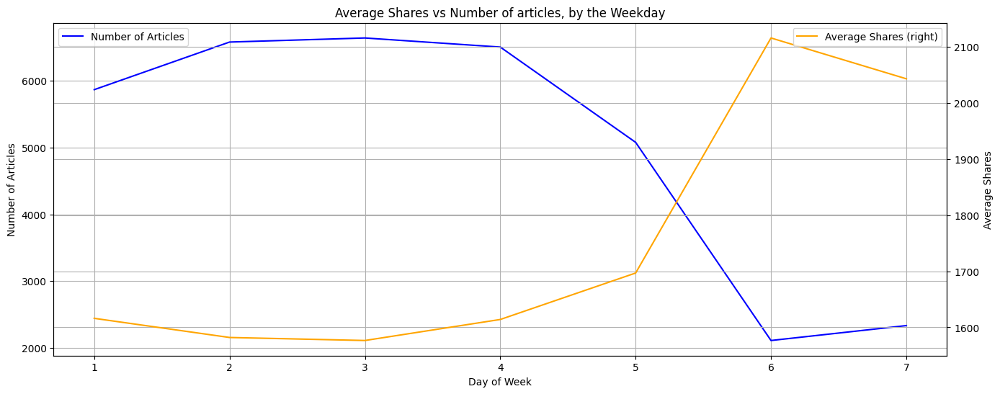

In [77]:
grouped_data = data.groupby('weekday').agg({'shares': 'mean'}).rename(columns={'shares': 'avg_shares'})
grouped_data['num_articles'] = data['weekday'].value_counts().sort_index()

plt.figure(figsize=(16, 6))
ax1 = grouped_data['num_articles'].plot(kind='line', color='blue', grid=True, label='Number of Articles')
ax2 = grouped_data['avg_shares'].plot(kind='line', color='orange', grid=True, secondary_y=True, label='Average Shares')

ax1.set_xlabel('Day of Week')
ax1.set_ylabel('Number of Articles')
ax2.set_ylabel('Average Shares')

plt.title('Average Shares vs Number of articles, by the Weekday')
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')

plt.show()


<span style="font-size:16px;">Here we clearly see that the majority of the articles are published during the week because it is often during the week that we work, and therefore journalists too, so they are obviously many more articles published during the week, and very less during the week-end.

<span style="font-size:16px;">However, However, the advantage is at the weekend which largely outperforms the week in terms of average shares. From Monday to Thursday, the average shares are around 1400, when Friday ups to 1500 so **+7%**, and we reach the peak at a little bit more than 1800 average shares the Saturday so about **+28,5% shares in average, for about x3 less publications**.

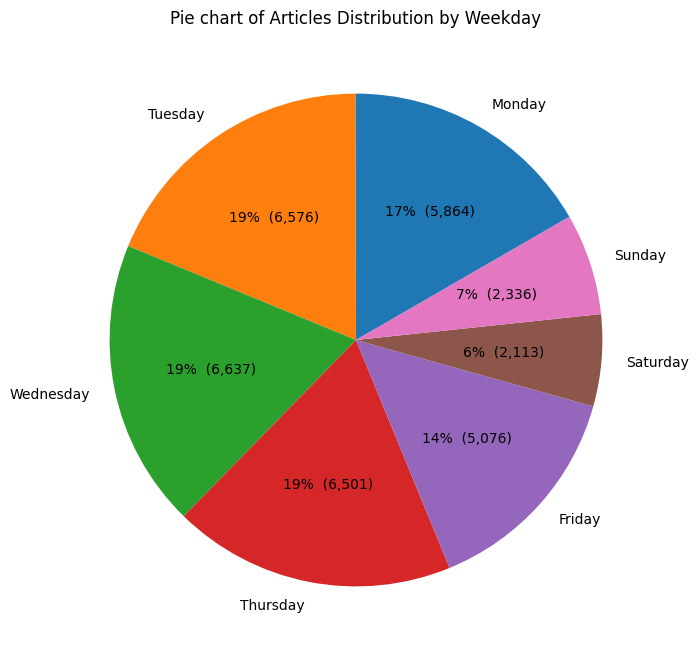

In [78]:
weekday_counts = data['weekday'].value_counts().sort_index()

plt.figure(figsize=(8, 8))
plt.pie(weekday_counts, labels=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
        autopct=lambda p: '{:.0f}%  ({:,.0f})'.format(p, p * sum(weekday_counts) / 100),
        startangle=30)

plt.title('Pie chart of Articles Distribution by Weekday')
plt.show()

## **Positive/Negative Words Rate Columns**

46. global_rate_positive_words:    Rate of positive words in the content
47. global_rate_negative_words:    Rate of negative words in the content
48. rate_positive_words:           Rate of positive words among non-neutral tokens
49. rate_negative_words:           Rate of negative words among non-neutral tokens

In [79]:
rate_columns = ['global_rate_positive_words','global_rate_negative_words','rate_positive_words','rate_negative_words']

In [80]:
data[rate_columns].describe()

,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words
count,35103.000000,35103.000000,35103.000000,35103.000000
mean,0.039583,0.016562,0.683849,0.288404
std,0.017330,0.010739,0.187994,0.156106
min,0.000000,0.000000,0.000000,0.000000
25%,0.028322,0.009595,0.600000,0.185880
50%,0.038922,0.015306,0.710526,0.280000
75%,0.050247,0.021692,0.800000,0.384615
max,0.155488,0.162037,1.000000,1.000000


<span style="font-size:16px;">We observe that rate_positive_words and rate_negatives_words sum is 1. It's what is expected because these two columns don't take neutral world in consideration.

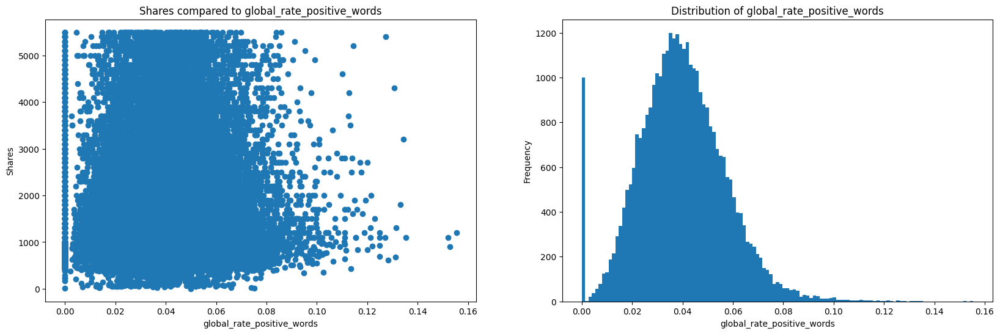

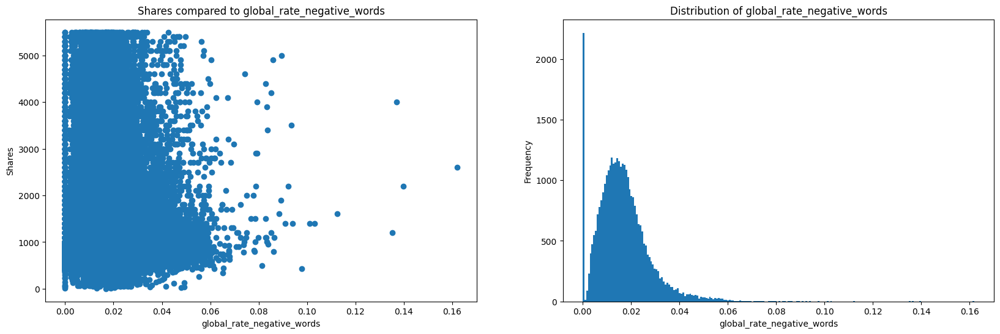

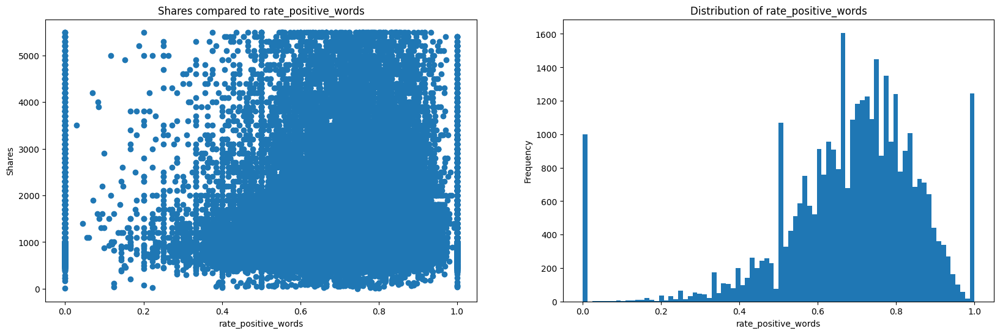

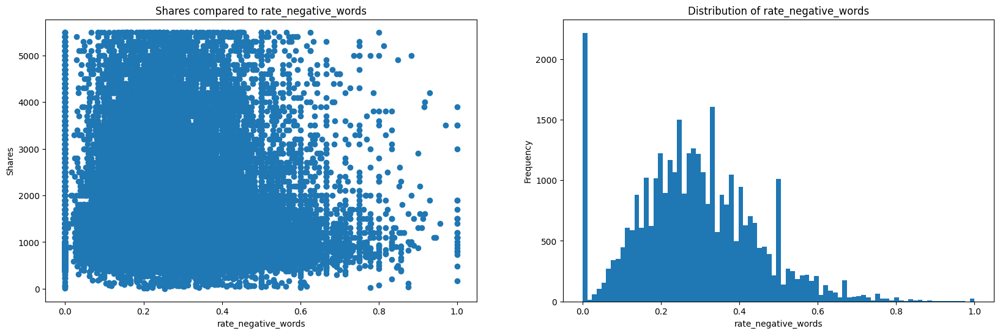

In [81]:
for col in rate_columns:
    fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
    ax1.scatter(data[col],data["shares"])
    ax2.hist(data[col],bins='auto')
    ax1.set_xlabel(col)
    ax1.set_ylabel("Shares")
    ax1.set_title(f"Shares compared to {col}")
    ax2.set_xlabel(col)
    ax2.set_ylabel("Frequency")
    ax2.set_title(f"Distribution of {col}")
    plt.show()

<span style="font-size:16px;">All 4 columns are rates between 0 and 1. There is no need to remove or cap values.

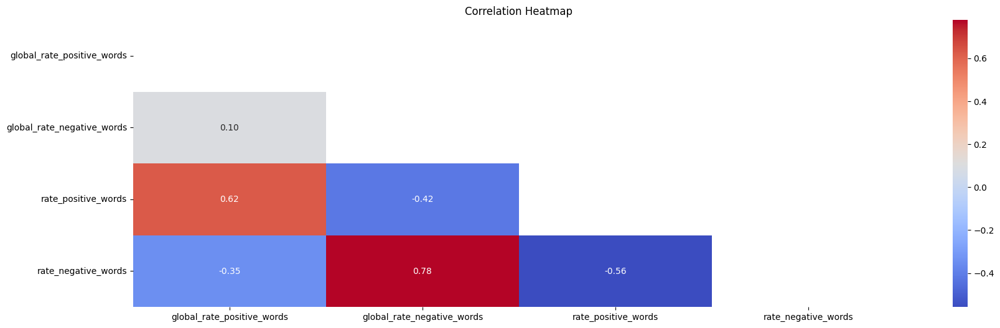

In [82]:
corr_rate = data[rate_columns].corr()

plt.figure(figsize=(20, 6))
mask = np.triu(np.ones_like(corr_rate, dtype=bool))
ax = sns.heatmap(corr_rate, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, mask=mask)

ax.set_title('Correlation Heatmap')

plt.show()

<span style="font-size:16px;">As we can see, 'rate_positive_words' is pretty correlated with 'global_rate_positive_words' which contains it, and same for 'rate_negative_words' with 'global_rate_negative_words'. Even the rate_negative/positive are well correlated with each other so we delete them.

In [83]:
DropColumn(data,['rate_positive_words','rate_negative_words'])
rate_columns = list(set(rate_columns) - set(['rate_positive_words','rate_negative_words']))

## **Polarity Columns**

In [84]:
polarity_columns = ['global_sentiment_polarity','avg_positive_polarity','min_positive_polarity','max_positive_polarity','avg_negative_polarity', 'min_negative_polarity','max_negative_polarity','title_sentiment_polarity', 'abs_title_sentiment_polarity']

In [85]:
data[polarity_columns].describe()

,global_sentiment_polarity,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_sentiment_polarity,abs_title_sentiment_polarity
count,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000,35103.000000
mean,0.118899,0.352883,0.095213,0.755122,-0.257774,-0.519271,-0.106909,0.068607,0.151987
std,0.095983,0.102511,0.070615,0.245383,0.126191,0.289376,0.094034,0.260124,0.221970
min,-0.393750,0.000000,0.000000,0.000000,-1.000000,-1.000000,-1.000000,-1.000000,0.000000
25%,0.057623,0.305553,0.050000,0.600000,-0.325469,-0.700000,-0.125000,0.000000,0.000000
50%,0.118554,0.357435,0.100000,0.800000,-0.251157,-0.500000,-0.100000,0.000000,0.000000
75%,0.177140,0.409334,0.100000,1.000000,-0.185542,-0.300000,-0.050000,0.136364,0.250000
max,0.727841,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000


<span style="font-size:16px;">All values are a score between -1 and 1 that represents the polarity of the article. There are no outliers. global_sentiment, average_positive, average_negative and title_sentiment columns are more representative than the others.

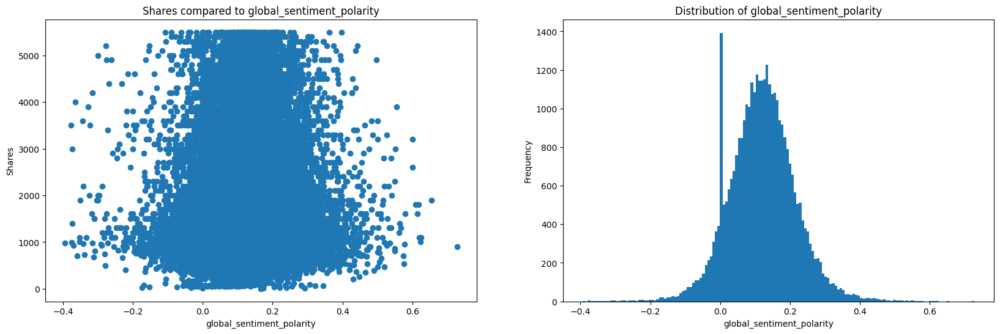

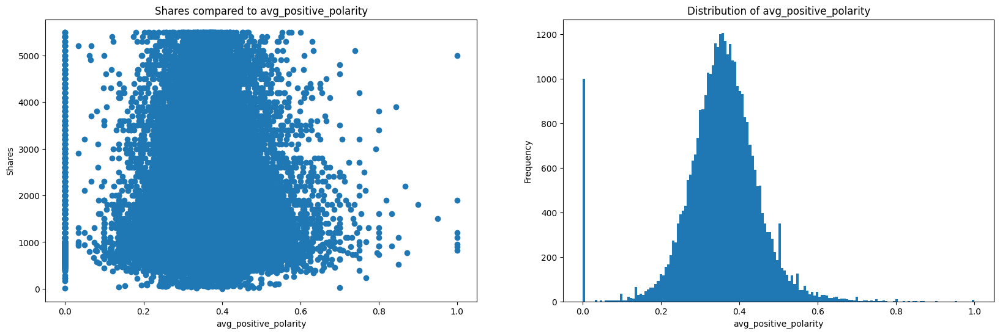

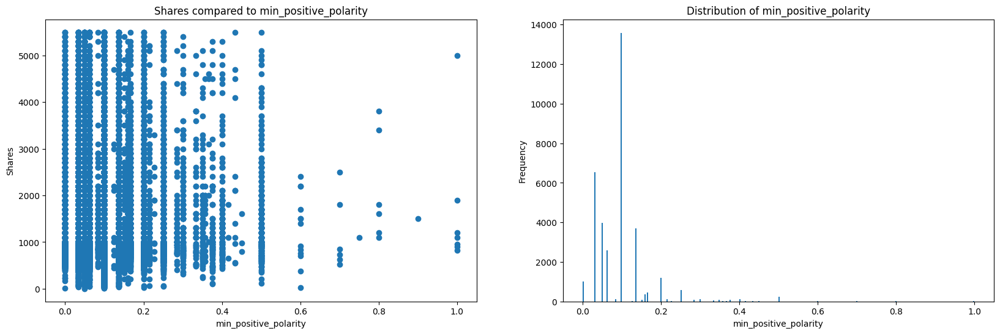

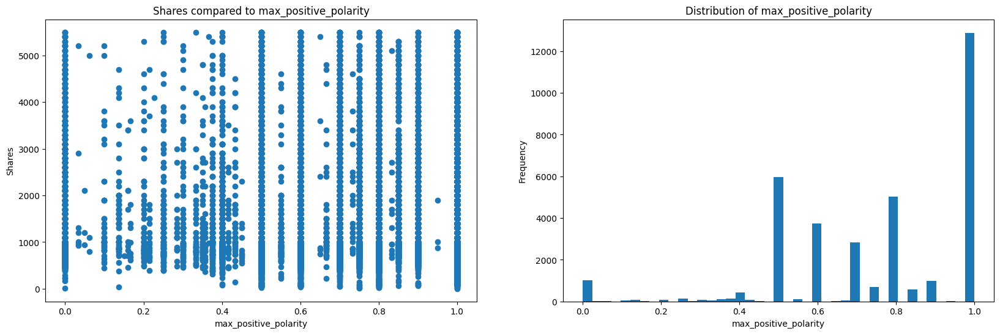

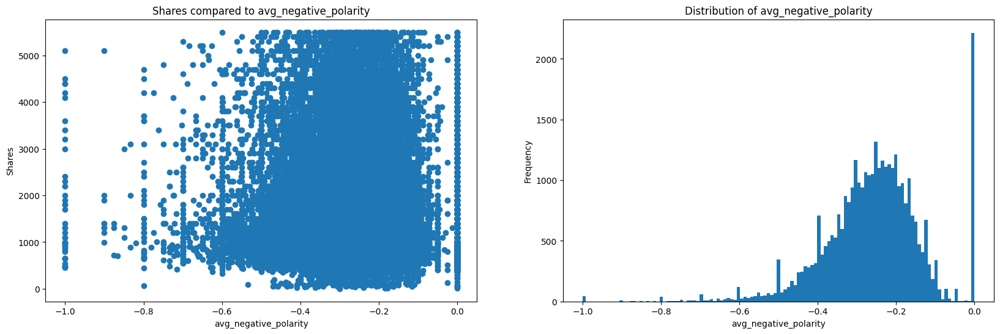

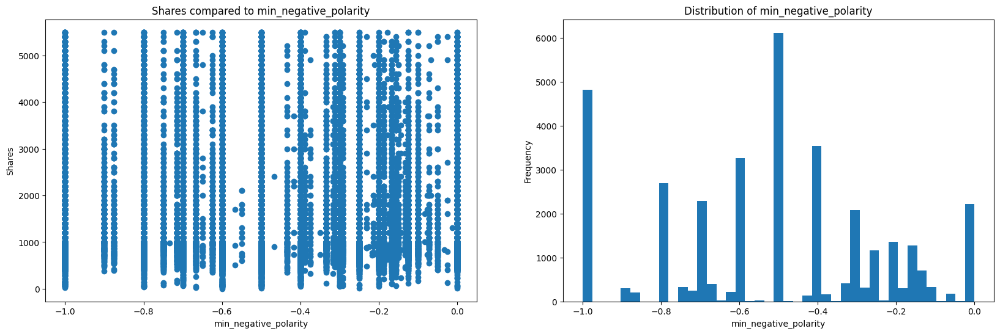

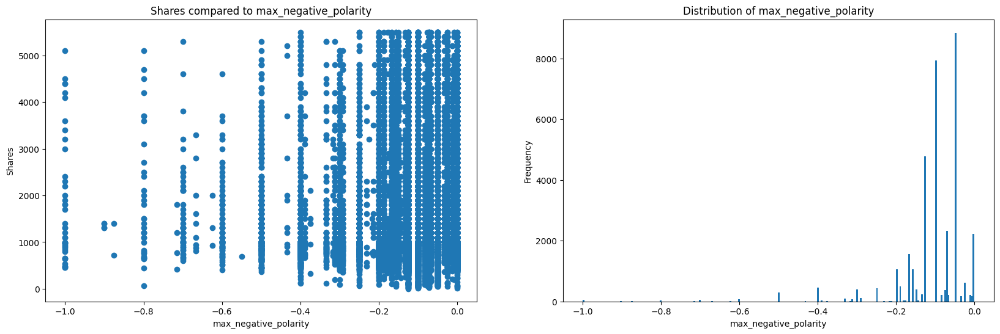

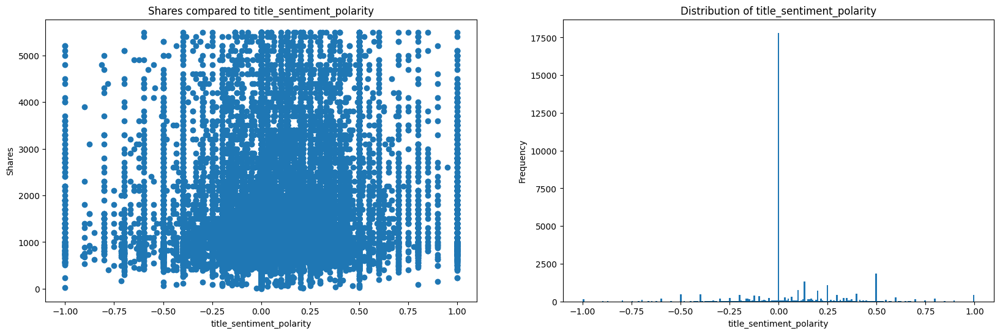

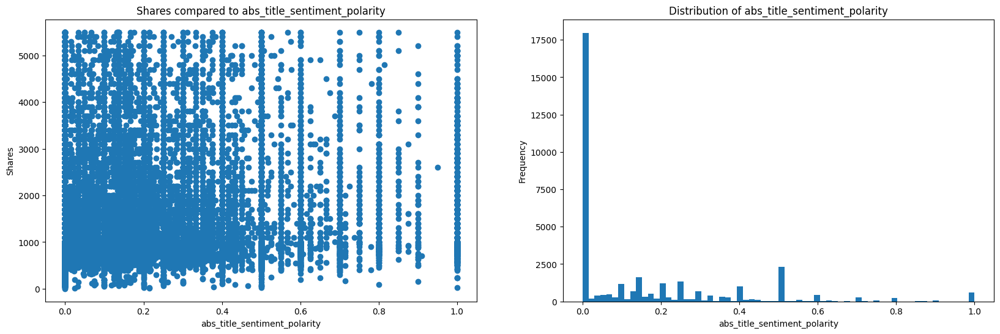

In [86]:
for col in polarity_columns:
    fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
    ax1.scatter(data[col],data["shares"])
    ax2.hist(data[col],bins='auto')
    ax1.set_xlabel(col)
    ax1.set_ylabel("Shares")
    ax1.set_title(f"Shares compared to {col}")
    ax2.set_xlabel(col)
    ax2.set_ylabel("Frequency")
    ax2.set_title(f"Distribution of {col}")
    plt.show()

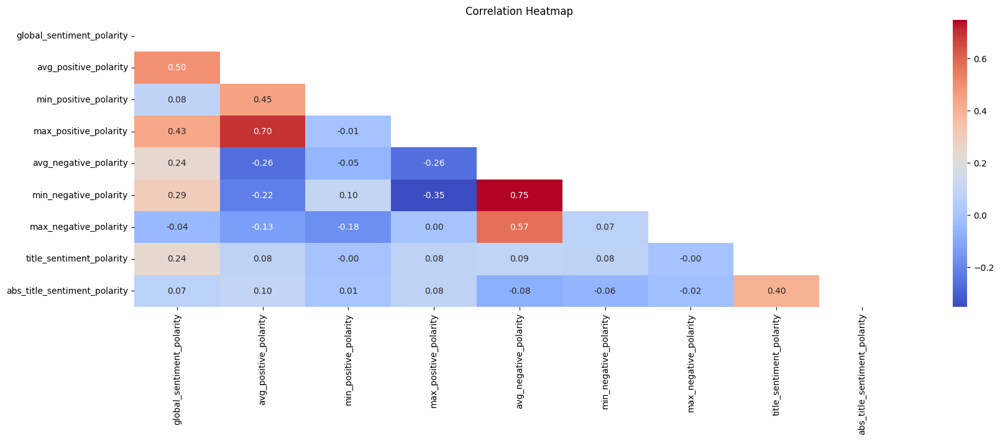

In [87]:
corr_polarity = data[polarity_columns].corr()

plt.figure(figsize=(20, 6))
mask = np.triu(np.ones_like(corr_polarity, dtype=bool))
ax = sns.heatmap(corr_polarity, annot=True, fmt='.2f', cmap='coolwarm', cbar=True, mask=mask)

ax.set_title('Correlation Heatmap')

plt.show()

<span style="font-size:16px;">The variables represent common concepts
> <span style="font-size:16px;">avg_positive/negative_polarity columns indicate the degree of positivity/negativity associated with positive/negative words, respectively

<span style="font-size:16px;">and min_negative is correlated at 0.75 with avg_negative and a correlation greater than 0.7 (Pearson's coefficient) is considered high (too high). By removing min_negative, we are also logically tempted to also remove max_negative correlated at 0.57 with avg_negative, which remains a good correlation. Moreover, in its context, avg_negative is directly linked with min/max_negative so here it remains reasonable to remove them.

<span style="font-size:16px;">The exact same reasoning for min/max_positive_polarity.

<span style="font-size:16px;">Moreover, we decide to delete 'abs_title_sentiment_polarity' as it is a duplicate for us, and that doesn't add much. We can even see that it turns out that this feature is correlated more than 0.7 with 'title_subjectivity' 

In [88]:
polarities_to_delete=["min_positive_polarity","max_positive_polarity","min_negative_polarity","max_negative_polarity","abs_title_sentiment_polarity"]
DropColumn(data,polarities_to_delete)

## **Subjectivity Columns**

In [89]:
subjectivity_columns = ['global_subjectivity','title_subjectivity','abs_title_subjectivity']

In [90]:
data[subjectivity_columns].describe()

,global_subjectivity,title_subjectivity,abs_title_subjectivity
count,35103.000000,35103.000000,35103.000000
mean,0.441416,0.276916,0.341979
std,0.114151,0.320946,0.189265
min,0.000000,0.000000,0.000000
25%,0.393946,0.000000,0.166667
50%,0.450878,0.125000,0.500000
75%,0.505298,0.500000,0.500000
max,1.000000,1.000000,0.500000


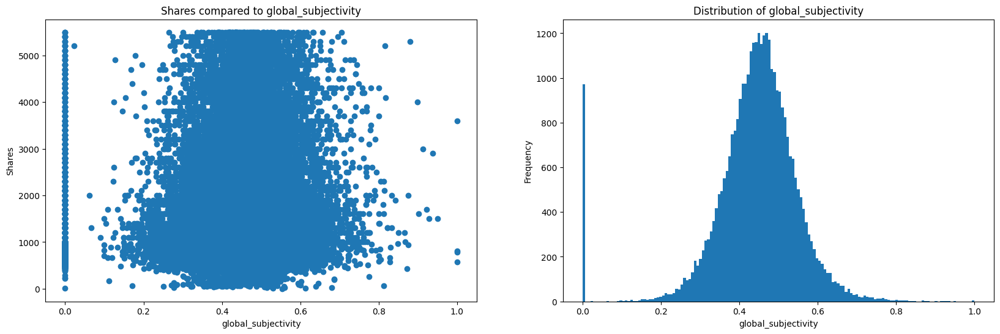

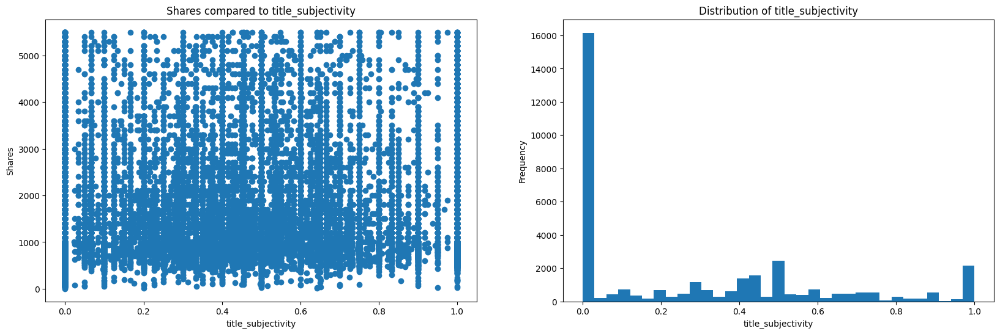

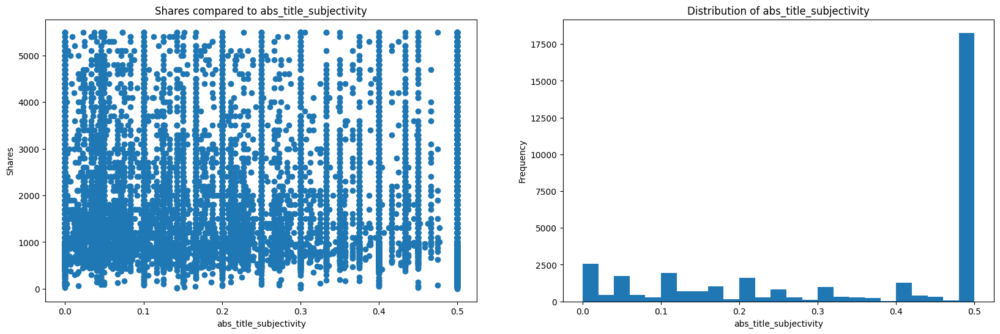

In [91]:
for col in subjectivity_columns:
    fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,6))
    ax1.scatter(data[col],data["shares"])
    ax2.hist(data[col],bins='auto')
    ax1.set_xlabel(col)
    ax1.set_ylabel("Shares")
    ax1.set_title(f"Shares compared to {col}")
    ax2.set_xlabel(col)
    ax2.set_ylabel("Frequency")
    ax2.set_title(f"Distribution of {col}")
    plt.show()

<span style="font-size:16px;">These 3 columns are just a score between 0 and 1. There are no outliers

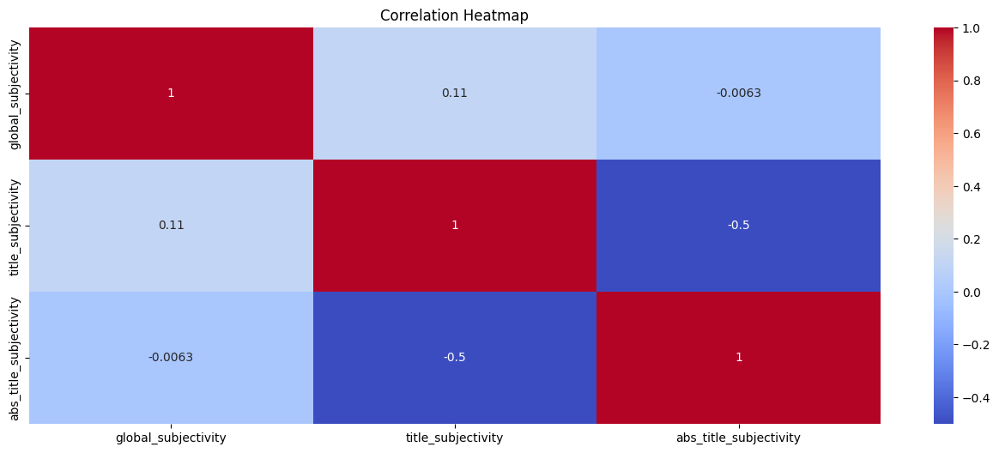

In [92]:
plt.figure(figsize=(16,6))
sns.heatmap(data[subjectivity_columns].corr(),cmap="coolwarm",annot=True)
plt.title('Correlation Heatmap')
plt.show()

<span style="font-size:16px;">As we can see abs_title_subjectivity is correlated with title_subjectivity at 50% since it must represent the absolute value. **We can drop the absolute value column.**

In [93]:
DropColumn(data,["abs_title_subjectivity"])

# **Creating two DataFrame : capped one & cleaned one**

<span style="font-size:20px;">Now, we decide to create two dataframes :
- <span style="font-size:16px;">**'data_capped'** : first one is with the outliers that are capped to the IQR limits. This prevent from cutting too much rows of the dataset and of some important features. But obviously, there is some bias.
- <span style="font-size:16px;">**'data_quality'** : the second one is deleting the outliers out of the IQR's limits. This approach ensures that a certain quality of data is preserved

In [94]:
print(data.shape)

(35103, 25)


In [95]:
data_capped = data.copy() #Cap the outliers to the IQR's limits
data_quality = data.copy() #Deleting the outliers out of the IQR's limits

In [96]:
#TOKENS
data_capped.loc[data_capped['n_tokens_title'] > IQR_n_tokens_title[0], 'n_tokens_title'] = IQR_n_tokens_title[0]
data_capped.loc[data_capped['n_tokens_title'] < IQR_n_tokens_title[1], 'n_tokens_title'] = IQR_n_tokens_title[1]
data_capped.loc[data_capped['n_tokens_content'] > IQR_n_tokens_content[0], 'n_tokens_content'] = IQR_n_tokens_content[0]
data_capped.loc[data_capped['average_token_length'] > IQR_avg_token_length[0], 'average_token_length'] = IQR_avg_token_length[0]
data_capped.loc[data_capped['average_token_length'] < IQR_avg_token_length[1], 'average_token_length'] = IQR_avg_token_length[1]

data_quality = data_quality[data_quality['n_tokens_title']<=IQR_n_tokens_title[0]]
data_quality = data_quality[data_quality['n_tokens_title']>=IQR_n_tokens_title[1]]
data_quality = data_quality[data_quality['n_tokens_content']<=IQR_n_tokens_content[0]]
data_quality = data_quality[data_quality['average_token_length']<=IQR_avg_token_length[0]]
data_quality = data_quality[data_quality['average_token_length']>=IQR_avg_token_length[1]]

#IMAGES & VIDS (here we use our results from the webscrapping!)
data_capped.loc[data_capped['num_videos'] > IQR_vids[0], 'num_videos'] = 2 #The mean of the webscrapping
data_capped.loc[data_capped['num_imgs'] > IQR_imgs[0], 'num_imgs'] = 0 #The mean of the webscrapping

data_quality = data_quality[data_quality ['num_videos']<=IQR_vids[0]]
data_quality = data_quality[data_quality['num_imgs']<=IQR_imgs[0]]

#KEYWORDS
data_capped.loc[data_capped['kw_avg_avg'] > upper_lim_shares, 'kw_avg_avg'] = upper_lim_shares
data_capped.loc[data_capped['kw_avg_avg'] < lower_lim_shares, 'kw_avg_avg'] = lower_lim_shares
data_capped.loc[data_capped['kw_max_avg'] > upper_lim_shares, 'kw_max_avg'] = upper_lim_shares
data_capped.loc[data_capped['kw_max_avg'] < lower_lim_shares, 'kw_max_avg'] = lower_lim_shares

data_quality = data_quality[data_quality['kw_avg_avg']<=upper_lim_shares]
data_quality = data_quality[data_quality['kw_max_avg']<=upper_lim_shares]
data_quality = data_quality[data_quality['kw_avg_avg']>=lower_lim_shares]
data_quality = data_quality[data_quality['kw_max_avg']>=lower_lim_shares]

#REFERENCES
data_capped.loc[data_capped["self_reference_avg_sharess"] > IQR_refs_avg[0], "self_reference_avg_sharess"] = IQR_refs_avg[0]
data_capped.loc[data_capped["num_self_hrefs"] > IQR_num_self_href[0], "num_self_hrefs"] = IQR_num_self_href[0]
data_capped.loc[data_capped["num_hrefs"] > IQR_num_hrefs[0], "num_hrefs"] = IQR_num_hrefs[0]

data_quality = data_quality[data_quality['self_reference_avg_sharess']<=IQR_refs_avg[0]]
data_quality = data_quality[data_quality['num_self_hrefs']<=IQR_num_self_href[0]]
data_quality = data_quality[data_quality['num_hrefs']<=IQR_num_hrefs[0]]

print("'data_quality' shape:",data_quality.shape,"\nIt represents",round(100*data_quality.shape[0]/len(data),2),"% compared to the dataset without 'shares' outliers only.")

'data_quality' shape: (15111, 25) 
It represents 43.05 % compared to the dataset without 'shares' outliers only.


In [97]:
df = data_quality.copy()  #for the data visulisations after

## **Correlations of each features with 'shares' (target) for both DataFrames**

<span style="font-size:16px;">Now, let's see the preview that our two dataframes give us with the correlation of each feature according to the target

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.


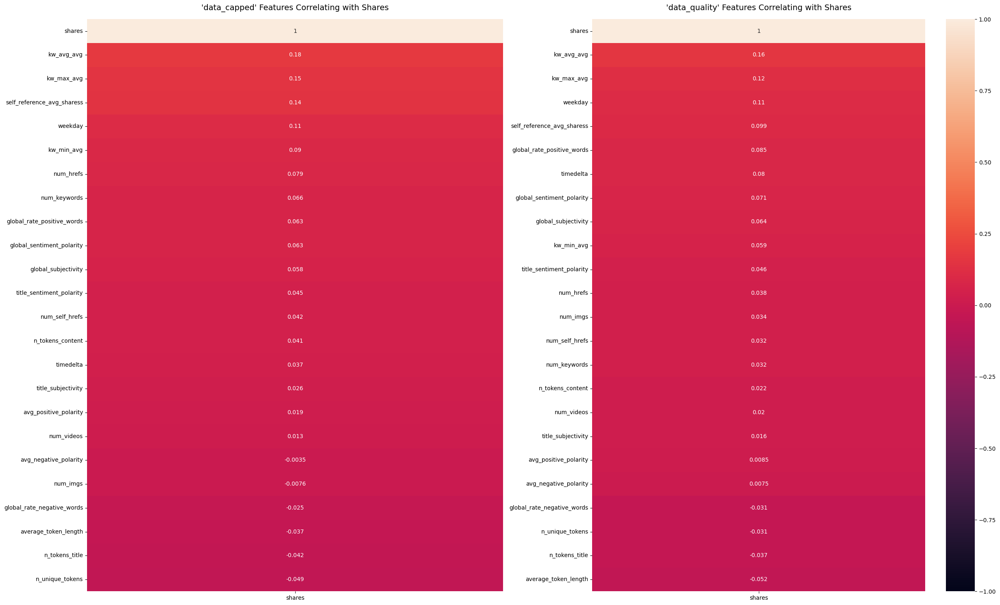

In [98]:
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(25, 15))

heatmap_capped = sns.heatmap(data_capped.corr()[['shares']].sort_values(by='shares', ascending=False), vmin=-1, vmax=1, annot=True, cbar=None, ax=ax1)
heatmap_capped.set_title("'data_capped' Features Correlating with Shares", fontdict={'fontsize':14}, pad=16);

heatmap_quality = sns.heatmap(data_quality.corr()[['shares']].sort_values(by='shares', ascending=False), vmin=-1, vmax=1, annot=True, ax=ax2)
heatmap_quality.set_title("'data_quality' Features Correlating with Shares", fontdict={'fontsize':14}, pad=16);

plt.tight_layout()
plt.show()

## **Correlations Matrixes of both DataFrames**

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.


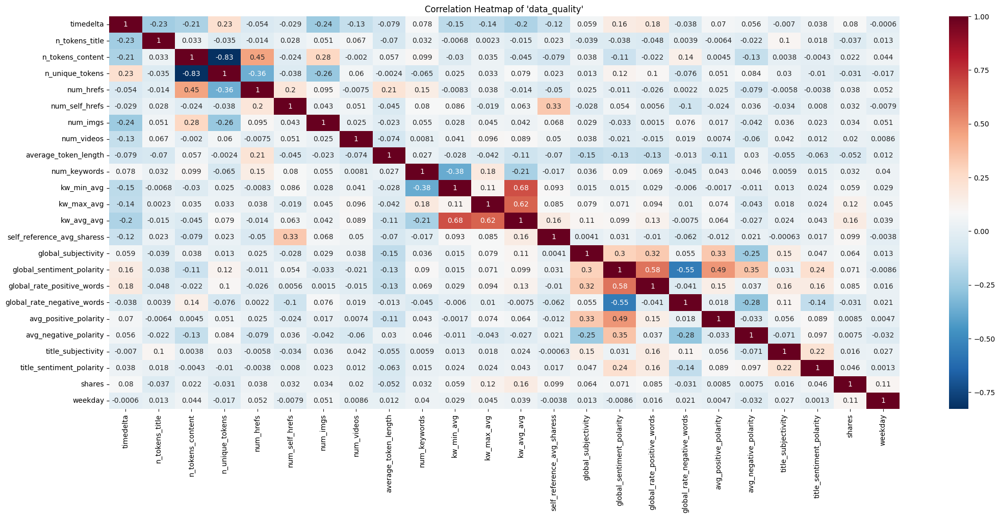

In [99]:
plt.figure(figsize=(25,10))
sns.heatmap(data_quality.corr(), cmap='RdBu_r', annot=True)
plt.title("Correlation Heatmap of 'data_quality'")
plt.show()

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.


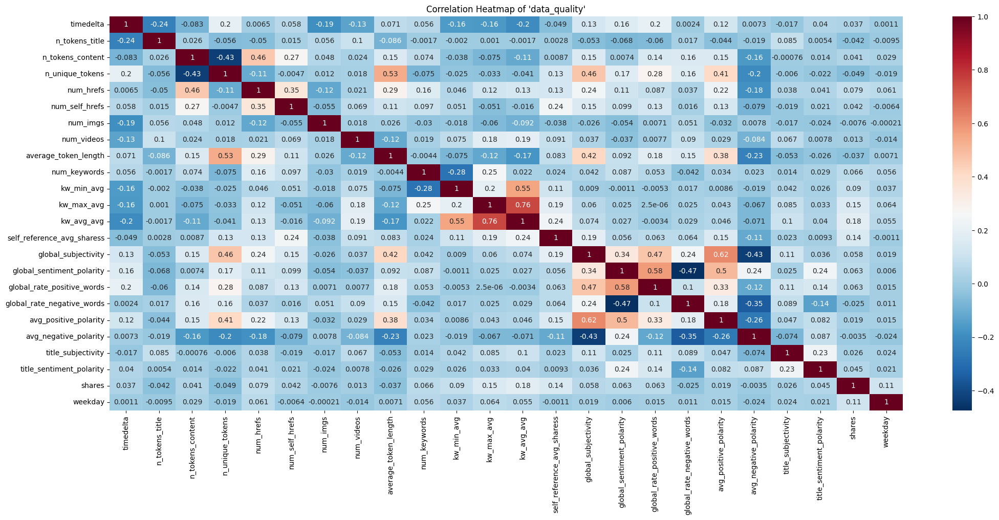

In [100]:
plt.figure(figsize=(25,10))
sns.heatmap(data_capped.corr(),cmap='RdBu_r',annot=True)
plt.title("Correlation Heatmap of 'data_quality'")
plt.show()

## **Boxplots of each features for both DataFrames**

<span style="font-size:16px;">We do all the boxplots for both of the dataframes 'data_capped' and 'data_quality' in order to see the difference between the distribution of the capped columns and the clean columns, 
therefore theoretically of better quality :

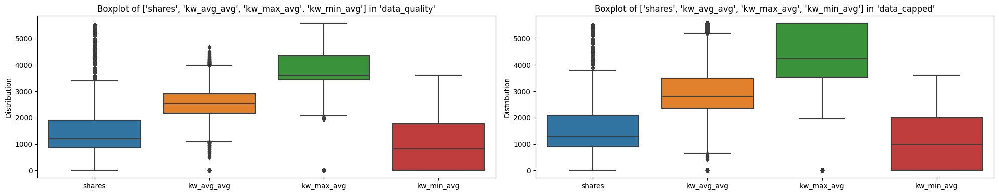

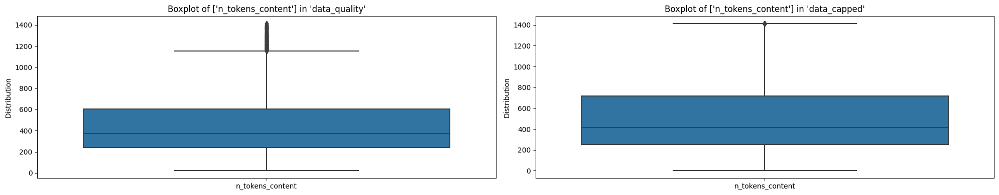

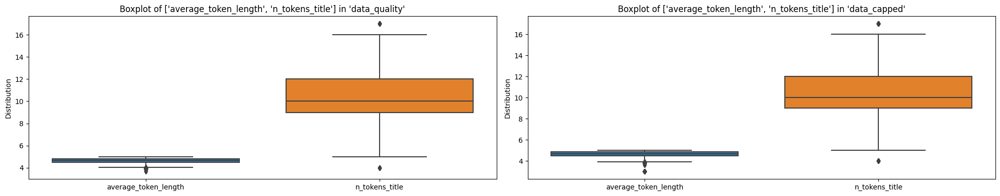

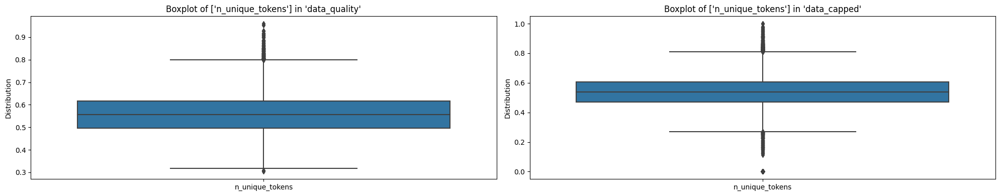

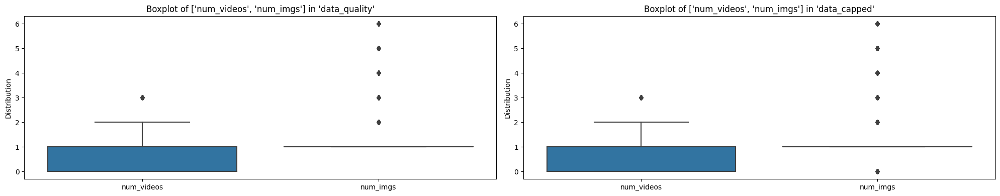

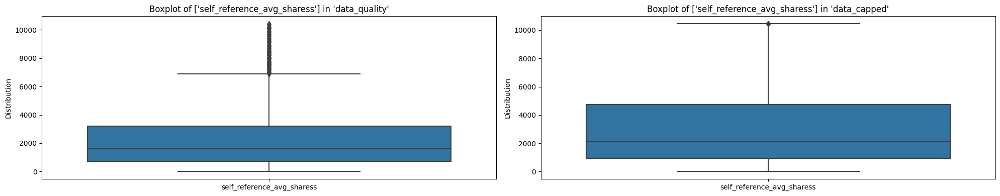

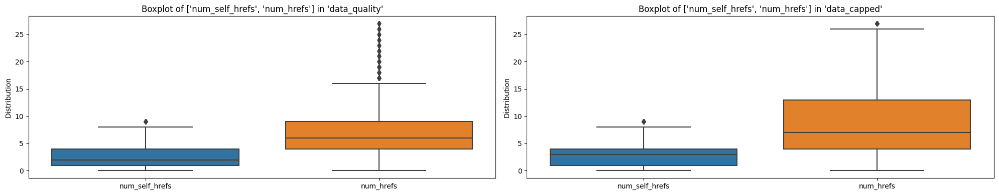

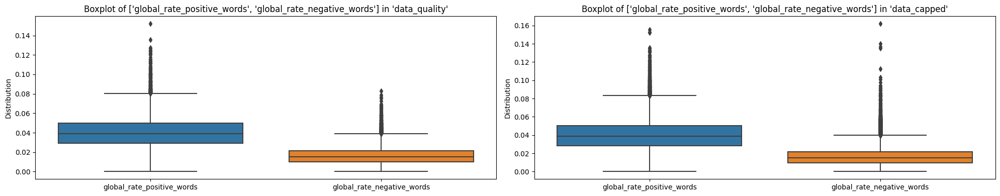

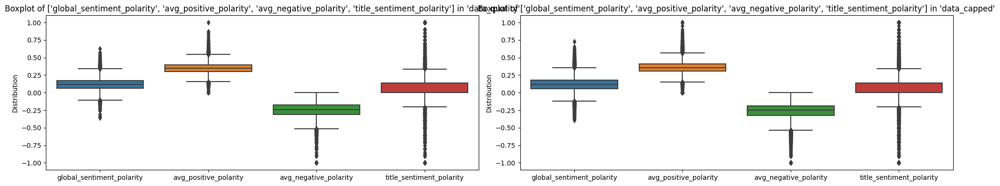

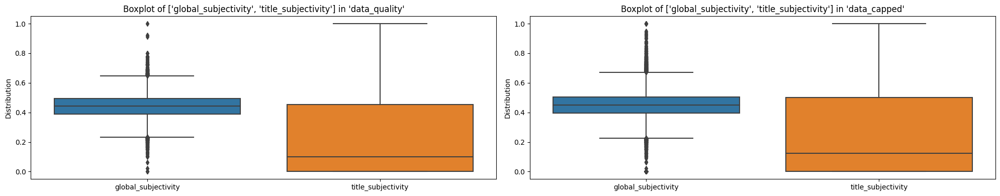

In [101]:
array_to_boxplot=[['shares','kw_avg_avg','kw_max_avg','kw_min_avg'],
['n_tokens_content'],
['average_token_length','n_tokens_title'],
['n_unique_tokens'],
['num_videos', 'num_imgs'],
['self_reference_avg_sharess'],
['num_self_hrefs','num_hrefs'],
['global_rate_positive_words','global_rate_negative_words'],
['global_sentiment_polarity','avg_positive_polarity','avg_negative_polarity','title_sentiment_polarity'],
['global_subjectivity','title_subjectivity']]

for category in array_to_boxplot:
    fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,4))
    sns.boxplot(data_quality[category],ax=ax1)
    sns.boxplot(data_capped[category],ax=ax2)
    ax1.set_ylabel("Distribution")
    ax1.set_title(f"Boxplot of {category} in 'data_quality'")
    ax2.set_ylabel("Distribution")
    ax2.set_title(f"Boxplot of {category} in 'data_capped'")
    plt.tight_layout()
    plt.show()

> <span style="font-size:16px;">Finally, we see that the **distribution of both the dataframes are not very different**, and both seem quite close as a result. Therefore, we decide to **keep only the clean data with 'data_quality' to create models**, as the results are likely to be substantially similar for both dataframes. We prefer to **prioritize a "high-quality" dataset**, and the fact that there is less data will also allow us to run our models more quickly on our small portable machines."

<span style="font-size:16px;">We encode the only non-numeric column which is 'theme' because we will need to later for our models, because only numerical values are understood by the algorithms.

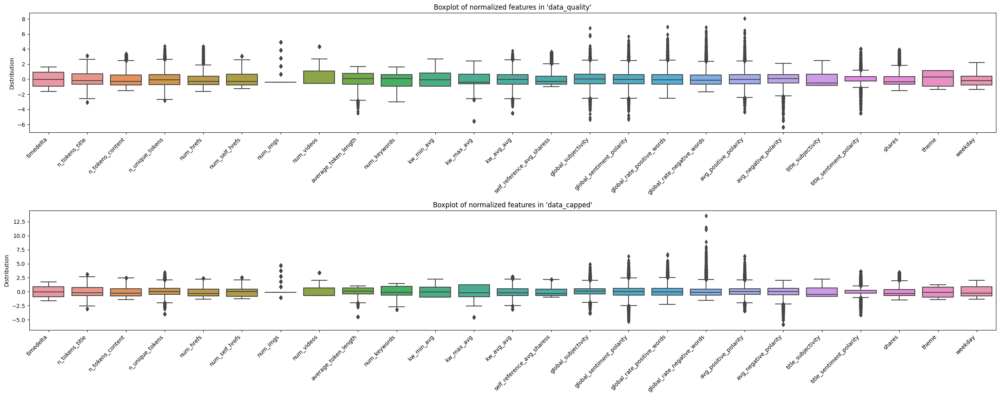

In [102]:
le = LabelEncoder()
data_quality['theme'] = le.fit_transform(data_quality['theme'])
data_capped['theme'] = le.fit_transform(data_capped['theme'])

normalized_data_quality = data_quality.copy()
normalized_data_capped = data_capped.copy()

sc = StandardScaler()
normalized_data_quality = sc.fit_transform(normalized_data_quality)
normalized_data_capped = sc.fit_transform(normalized_data_capped)

fig, (ax1,ax2) = plt.subplots(2,1,figsize=(25,10))
sns.boxplot(normalized_data_quality,ax=ax1)
sns.boxplot(normalized_data_capped,ax=ax2)
ax1.set_ylabel("Distribution")
ax1.set_title(f"Boxplot of normalized features in 'data_quality'")
ax2.set_ylabel("Distribution")
ax2.set_title(f"Boxplot of normalized features in 'data_capped'")
ax1.set_xticklabels(data_quality.columns, rotation=45, ha='right')
ax2.set_xticklabels(data_capped.columns, rotation=45, ha='right')
plt.tight_layout()
plt.show()

<span style="font-size:16px;">Same for the standardized data, the distribution are very close.

# **Predictive Models with 'data_quality'**

<span style="font-size:20px;">In this section, we tend to predict the number of shares that a news can make, depending on the various variables that we have retained. The aim is to predict the success of a news in the most precise way!

- <span style="font-size:18px;">First, we will try different **Regression** algorithms which are part of the classics, and we will compare the results.
- <span style="font-size:18px;">Secondly, we will explore the **Classification** through binary labels and multi-labels, which are going to represent the degree of popularity of a news, based on its shares.

<span style="font-size:18px;">Later, we will do a **Deep Learning** approach with neural networks for the best means of predictions that we will determine on our data.

In [103]:
def SplitAndScaler(df, testSize, classifierModel):
    y = df['shares']
    X= df.drop('shares', axis=1)
    if classifierModel == True:
      X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=testSize ,random_state =42, stratify=y)
      #'stratify=y' maintains the same proportion of each class of 'shares' in the test and train sets.
    else :
      X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=testSize ,random_state =42)

    sc = StandardScaler()
    X_train = sc.fit_transform(X_train)
    X_test = sc.transform(X_test)
    return X_train, X_test, y_train, y_test

## Regression

In [104]:
X_train, X_test, y_train, y_test = SplitAndScaler(data_quality, 0.3, False)

### LinearRegression

In [105]:
lr_model_quality = LinearRegression()
lr_model_quality.fit(X_train, y_train)

cv_lr_quality = cross_val_score(estimator = lr_model_quality, X = X_train, y = y_train, cv = 6)

y_pred_lr_quality_train = lr_model_quality.predict(X_train)
r2_score_lr_quality_train = r2_score(y_train, y_pred_lr_quality_train)

y_pred_lr_quality_test = lr_model_quality.predict(X_test)
r2_score_lr_quality_test = r2_score(y_test, y_pred_lr_quality_test)

rmse_lr_quality = (np.sqrt(mean_squared_error(y_test, y_pred_lr_quality_test)))
print("CV: ", cv_lr_quality.mean())
print('R2_score (train): ', r2_score_lr_quality_train)
print('R2_score (test): ', r2_score_lr_quality_test)
print("RMSE: ", rmse_lr_quality)

CV:  0.0651662169400634
R2_score (train):  0.07163107420126569
R2_score (test):  0.07992582117395641
RMSE:  967.4855132806035


### LassoRegressor

In [106]:
lasso_pipe_quality = Lasso(random_state = 42, max_iter=3000)
lasso_pipe_quality.fit(X_train, y_train)

cv_lasso_quality = cross_val_score(estimator = lasso_pipe_quality, X = X_train, y = y_train, cv = 6)

y_pred_lasso_quality_train = lasso_pipe_quality.predict(X_train)
r2_score_lasso_quality_train = r2_score(y_train, y_pred_lasso_quality_train)

y_pred_lasso_quality_test = lasso_pipe_quality.predict(X_test)
r2_score_lasso_quality_test = r2_score(y_test, y_pred_lasso_quality_test)

rmse_lasso_quality = (np.sqrt(mean_squared_error(y_test, y_pred_lasso_quality_test)))
print('CV: ', cv_lasso_quality.mean())
print('R2_score (train): ', r2_score_lasso_quality_train)
print('R2_score (test): ', r2_score_lasso_quality_test)
print("RMSE: ", rmse_lasso_quality)

CV:  0.06532596076230629
R2_score (train):  0.07158671947429718
R2_score (test):  0.07983313321346641
RMSE:  967.5342441344675


### DecisionTreeRegressor

In [107]:
dt_quality = DecisionTreeRegressor(random_state = 42)
dt_quality.fit(X_train, y_train)

cv_dt_quality = cross_val_score(estimator = dt_quality, X = X_train, y = y_train, cv = 6)

y_pred_dt_quality_train = dt_quality.predict(X_train)
r2_score_dt_quality_train = r2_score(y_train, y_pred_dt_quality_train)

y_pred_dt_quality_test = dt_quality.predict(X_test)
r2_score_dt_quality_test = r2_score(y_test, y_pred_dt_quality_test)

rmse_dt_quality = (np.sqrt(mean_squared_error(y_test, y_pred_dt_quality_test)))
print('CV: ', cv_dt_quality.mean())
print('R2_score (train): ', r2_score_dt_quality_train)
print('R2_score (test): ', r2_score_dt_quality_test)
print("RMSE: ", rmse_dt_quality)

CV:  -0.8102815714278028
R2_score (train):  1.0
R2_score (test):  -0.8059407649082078
RMSE:  1355.4540516554207


### RandomForestRegressor

In [108]:
rf_quality = RandomForestRegressor(random_state = 42)
rf_quality.fit(X_train, y_train)

cv_rf_quality = cross_val_score(estimator = rf_quality,  X = X_train, y = y_train, cv = 6)

y_pred_rf_quality_train = rf_quality.predict(X_train)
r2_score_rf_quality_train = r2_score(y_train, y_pred_rf_quality_train)

y_pred_rf_quality_test = rf_quality.predict(X_test)
r2_score_rf_quality_test = r2_score(y_test, y_pred_rf_quality_test)

rmse_rf_quality = (np.sqrt(mean_squared_error(y_test, y_pred_rf_quality_test)))
print('CV: ', cv_rf_quality.mean())
print('R2_score (train): ', r2_score_rf_quality_train)
print('R2_score (test): ', r2_score_rf_quality_test)
print("RMSE: ", rmse_rf_quality)

CV:  0.09582454966349652
R2_score (train):  0.8758170232396529
R2_score (test):  0.10015705669721842
RMSE:  956.7895140975413


### SupportVectorRegressor

In [109]:
svr_quality = SVR(kernel = 'rbf', gamma = 'scale')
svr_quality.fit(X_train, y_train)

cv_svr_quality = cross_val_score(estimator = svr_quality, X = X_train, y = y_train, cv = 6)

y_pred_svr_quality_train = svr_quality.predict(X_train)
r2_score_svr_quality_train = r2_score(y_train, y_pred_svr_quality_train)

y_pred_svr_quality_test = svr_quality.predict(X_test)
r2_score_svr_quality_test = r2_score(y_test, y_pred_svr_quality_test)

rmse_svr_quality = (np.sqrt(mean_squared_error(y_test, y_pred_svr_quality_test)))
print('CV: ', cv_svr_quality.mean())
print('R2_score (train): ', r2_score_svr_quality_train)
print('R2_score (test): ', r2_score_svr_quality_test)
print("RMSE: ", rmse_svr_quality)

CV:  -0.09777559538790152
R2_score (train):  -0.09285435713221912
R2_score (test):  -0.08015088050758346
RMSE:  1048.2750793447285


### Evaluation of models

In [110]:
modelsReg_quality = [('Linear Regression', rmse_lr_quality, r2_score_lr_quality_train, r2_score_lr_quality_test, cv_lr_quality.mean()),
          ('Lasso Regression', rmse_lasso_quality, r2_score_lasso_quality_train, r2_score_lasso_quality_test, cv_lasso_quality.mean()),
          ('Decision Tree Regression', rmse_dt_quality, r2_score_dt_quality_train, r2_score_dt_quality_test, cv_dt_quality.mean()),
          ('Random Forest Regression', rmse_rf_quality, r2_score_rf_quality_train, r2_score_rf_quality_test, cv_rf_quality.mean()),
          ('Support Vector Regression', rmse_svr_quality, r2_score_svr_quality_train, r2_score_svr_quality_test, cv_svr_quality.mean())
         ]

In [111]:
predictions_reg_quality = pd.DataFrame(data = modelsReg_quality, columns=['Model', 'RMSE', 'R2_Score(training)', 'R2_Score(test)', 'Cross-Validation'])
predictions_reg_quality

,Model,RMSE,R2_Score(training),R2_Score(test),Cross-Validation
0,Linear Regression,967.485513,0.071631,0.079926,0.065166
1,Lasso Regression,967.534244,0.071587,0.079833,0.065326
2,Decision Tree Regression,1355.454052,1.000000,-0.805941,-0.810282
3,Random Forest Regression,956.789514,0.875817,0.100157,0.095825
4,Support Vector Regression,1048.275079,-0.092854,-0.080151,-0.097776


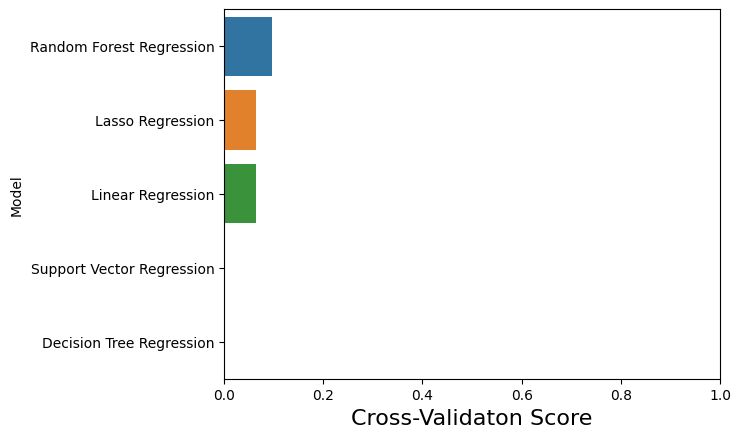

In [112]:
plt.figsize=(16,6)
predictions_reg_quality.sort_values(by=['Cross-Validation'], ascending=False, inplace=True)

sns.barplot(x='Cross-Validation', y='Model', data = predictions_reg_quality)
plt.xlabel('Cross-Validaton Score', size=16)
plt.ylabel('Model')
plt.xlim(0,1.0)
plt.show()

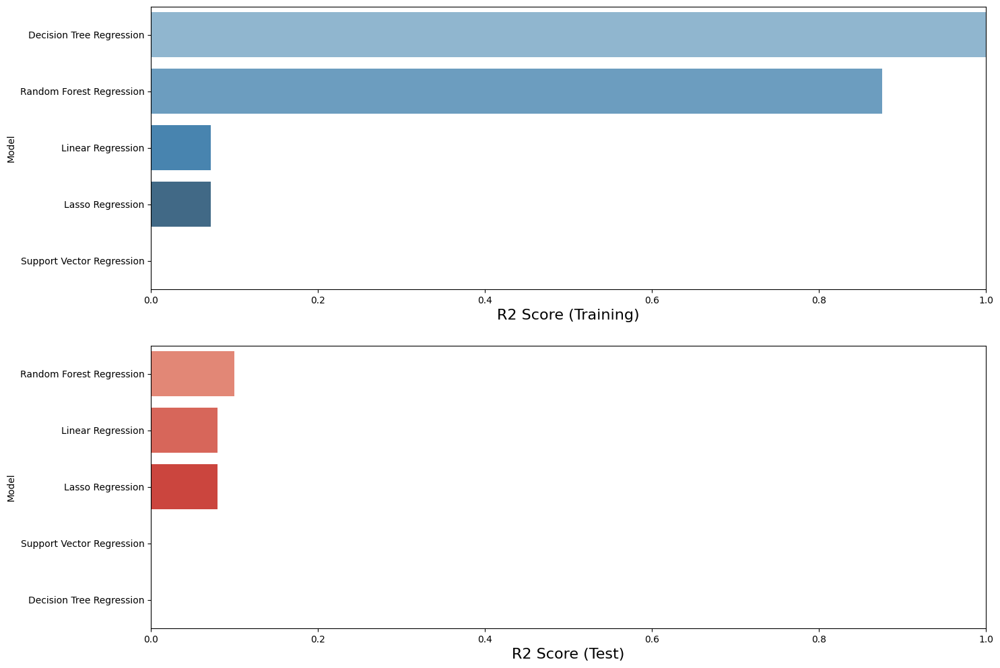

In [113]:
f, axes = plt.subplots(2,1, figsize=(16,12))

predictions_reg_quality.sort_values(by=['R2_Score(training)'], ascending=False, inplace=True)

sns.barplot(x='R2_Score(training)', y='Model', data = predictions_reg_quality, palette='Blues_d', ax = axes[0])
axes[0].set_xlabel('R2 Score (Training)', size=16)
axes[0].set_ylabel('Model')
axes[0].set_xlim(0,1.0)

predictions_reg_quality.sort_values(by=['R2_Score(test)'], ascending=False, inplace=True)

sns.barplot(x='R2_Score(test)', y='Model', data = predictions_reg_quality, palette='Reds_d', ax = axes[1])
axes[1].set_xlabel('R2 Score (Test)', size=16)
axes[1].set_ylabel('Model')
axes[1].set_xlim(0,1.0)

plt.show()

<span style="font-size:16px;">Secondly, the R2 scores. R2 or R² or the coefficient of determination, is a measure to determine the performance of a regression-based machine learning model. More the R2 is high (100%), more the two variables are correlated (dependent and independent variables).
In an easier way, it tells you how good the data fit the regression model.

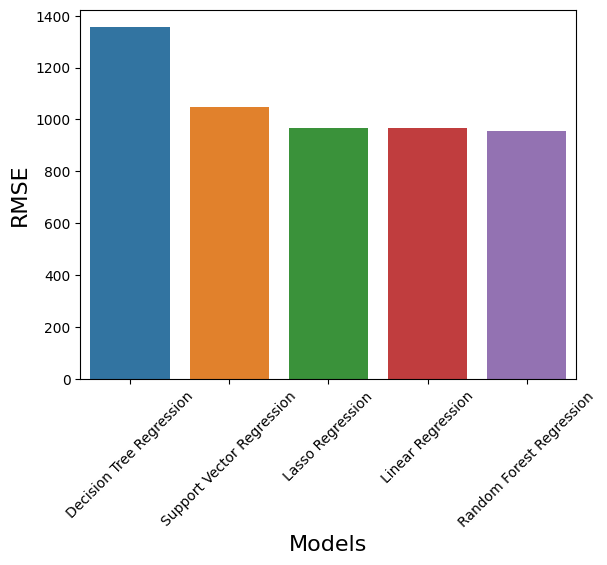

In [114]:
predictions_reg_quality.sort_values(by=['RMSE'], ascending=False, inplace=True)
plt.xticks(rotation=45)
sns.barplot(x='Model', y='RMSE', data=predictions_reg_quality)
plt.xlabel('Models', size=16)
plt.ylabel('RMSE', size=16)
plt.show()

<span style="font-size:16px;">To finish with the last metric : RMSE (Root Mean Square Error), it evaluates the quality of predicitons by showing how far the predicitons deviates from the true measured values.
It tells you the status of the fitting between model regression and values, if the observed datas are closer to the model's predicted values.
The measure is a distance, so, lower is the RMSE, better is the model.

#### Analysis of the models

<span style="font-size:18px;">**Linear Regression:**

- <span style="font-size:16px;">RMSE is high, suggesting significant prediction errors.
- <span style="font-size:16px;">R2 scores for training and test are very low, indicating poor model performance.
- <span style="font-size:16px;">Cross-Validation score is close to the test R2 score, suggesting that the model is consistent but generally performs poorly.

<span style="font-size:18px;">**Lasso Regression:**

- <span style="font-size:16px;">RMSE is similar to Linear Regression, which is still high.
- <span style="font-size:16px;">R2 scores are very similar to Linear Regression, remaining low.
- <span style="font-size:16px;">Cross-Validation score is slightly better than Linear Regression, but still poor performance.

<span style="font-size:18px;">**Decision Tree Regression:**

- <span style="font-size:16px;">RMSE is much higher than the other models, indicating more significant prediction errors.
- <span style="font-size:16px;">R2 score for training is perfect, which shows overfitting.
- <span style="font-size:16px;">R2 score for test is negative, and Cross-Validation is also negative, confirming that the model is overfitting and generalizes very poorly.

<span style="font-size:18px;">**Random Forest Regression:**

- <span style="font-size:16px;">Has a slightly lower RMSE than Linear and Lasso Regression, indicating better predictions.
- <span style="font-size:16px;">The R2 score for training shows the model fits well, but unlike the Decision Tree, it does not indicate extreme overfitting.
- <span style="font-size:16px;">R2 for test and Cross-Validation are the highest among the models, suggesting this model generalizes the best.

<span style="font-size:18px;">**Support Vector Regression (SVR):**

- <span style="font-size:16px;">RMSE is better than Decision Tree but worse than Linear and Lasso Regression.
- <span style="font-size:16px;">Negative R2 scores for both training and test, as well as a negative Cross-Validation score, indicate that the model is not performing well at all.

<span style="font-size:18px;">**Conclusion**
> <span style="font-size:16px;">The "better" regresion model is RandomForestRegressor, but globally regression models don't fit with our data, so let's take a look with classification.

### **Features Importances & Performance Visualisation of Random Forest Regressor**

In [115]:
df_rf_predictions = pd.DataFrame(rf_quality.predict(X_test[:1000]),list(y_test[:1000]))
df_rf_predictions.reset_index(level=0, inplace=True)
df_rf_predictions = df_rf_predictions.rename(index=str, columns={"index": "Actual shares", 0: "Predicted shares"})
df_rf_predictions.head()

,Actual shares,Predicted shares
0,1000,1636.53
1,723,1772.85
2,684,1007.76
3,1300,1240.48
4,1100,2044.48


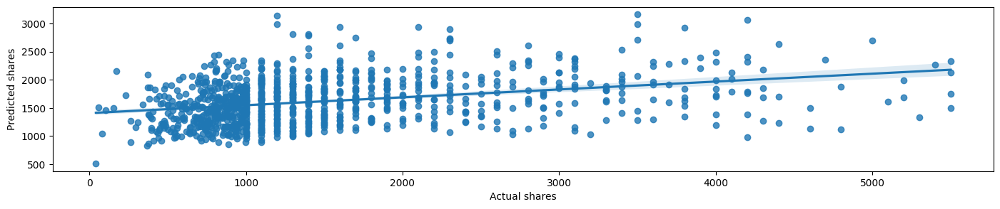

In [116]:
f, ax = plt.subplots(figsize=(17, 3))
sns.regplot(x=df_rf_predictions["Actual shares"], y=df_rf_predictions["Predicted shares"])
plt.show()

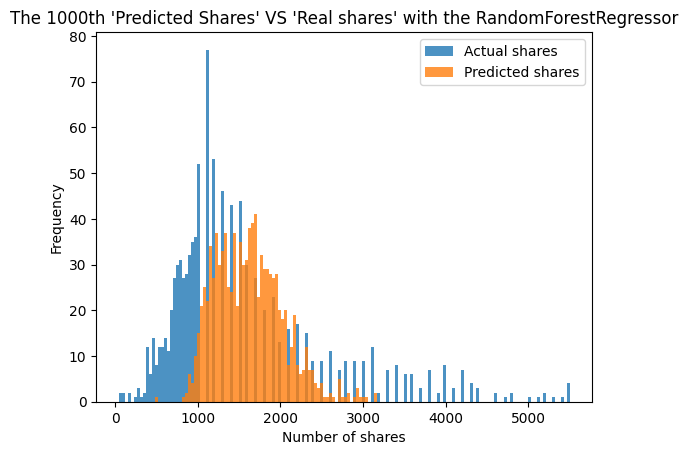

In [117]:
plt.figsize=(25,8)
df_rf_predictions.plot(bins=150, kind='hist', alpha=0.8)
plt.title("The 1000th 'Predicted Shares' VS 'Real shares' with the RandomForestRegressor")
plt.xlabel('Number of shares')
plt.show()

<span style="font-size:16px;">It is another verification that show that regression is not adapted to our data, and that even if the outliers are cut and not capped, the difference is so minimal that the dataset is in reality not necessarily of better quality even by removing the articles which had outliers.

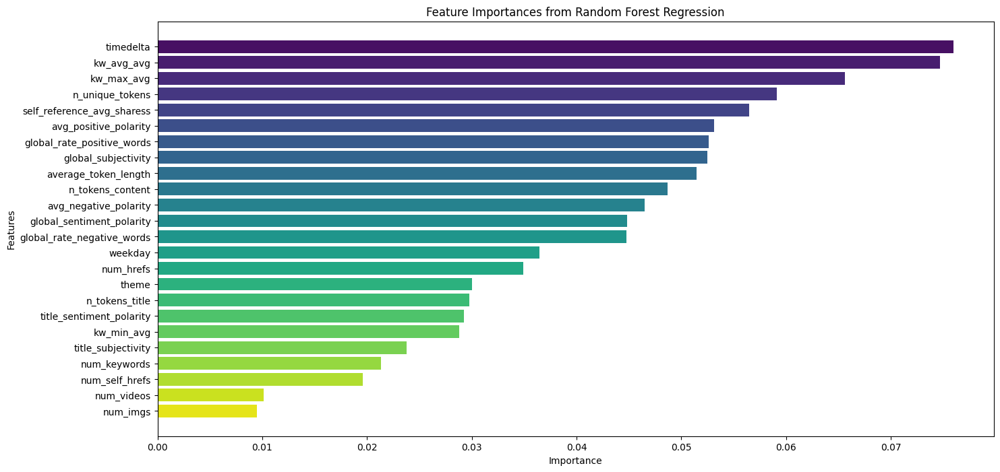

In [118]:
feature_importances = rf_quality.feature_importances_
feature_names = data_quality.drop(['shares'], axis=1).columns
sorted_indices = np.argsort(feature_importances)[::-1]  # sort the features by their importance

palette = sns.color_palette("viridis", n_colors=len(feature_importances))
plt.figure(figsize=(16, 8))
plt.title("Feature Importances from Random Forest Regression")
plt.barh(range(len(feature_importances)), feature_importances[sorted_indices], color=palette)
plt.yticks(range(len(feature_importances)), feature_names[sorted_indices])
plt.xlabel('Importance')
plt.ylabel('Features')
plt.gca().invert_yaxis()
plt.show()

In [119]:
new_features_rfr = feature_names[sorted_indices][:15].append(pd.Index(['shares']))
X_train_topfeatures, X_test_topfeatures, y_train_topfeatures, y_test_topfeatures = SplitAndScaler(data_quality[new_features_rfr], 0.3, False)

rfr_top15 = RandomForestRegressor(random_state=42)
rfr_top15.fit(X_train_topfeatures, y_train_topfeatures)

cv_rfr_top15 = cross_val_score(estimator = rfr_top15, X = X_train_topfeatures, y = y_train_topfeatures, cv = 6)

y_pred_rfr_top15_train = rfr_top15.predict(X_train_topfeatures)
r2_score_rfr_top15_train = r2_score(y_train_topfeatures, y_pred_rfr_top15_train)

y_pred_rfr_top15_test = rfr_top15.predict(X_test_topfeatures)
r2_score_rfr_top15_test = r2_score(y_test_topfeatures, y_pred_rfr_top15_test)

rmse_rfr_top15 = (np.sqrt(mean_squared_error(y_test_topfeatures, y_pred_rfr_top15_test)))
print('CV: ', cv_rf_quality.mean())
print('R2_score (train): ', r2_score_rfr_top15_train)
print('R2_score (test): ', r2_score_rfr_top15_test)
print("RMSE: ", rmse_rfr_top15)

CV:  0.09582454966349652
R2_score (train):  0.8720532477670312
R2_score (test):  0.062028696378859105
RMSE:  976.8498750774778


<span style="font-size:16px;"> As we can see, keeping only a tranche of the most important features **doesn't make the prediction better**, here, the model performs less well with only its 15 most important features, which proves that even the one having a little less importance ultimately plays a role in the overall performance

In [120]:
new_features_rfr = list(new_features_rfr.tolist())
new_features_rfr.remove("shares")

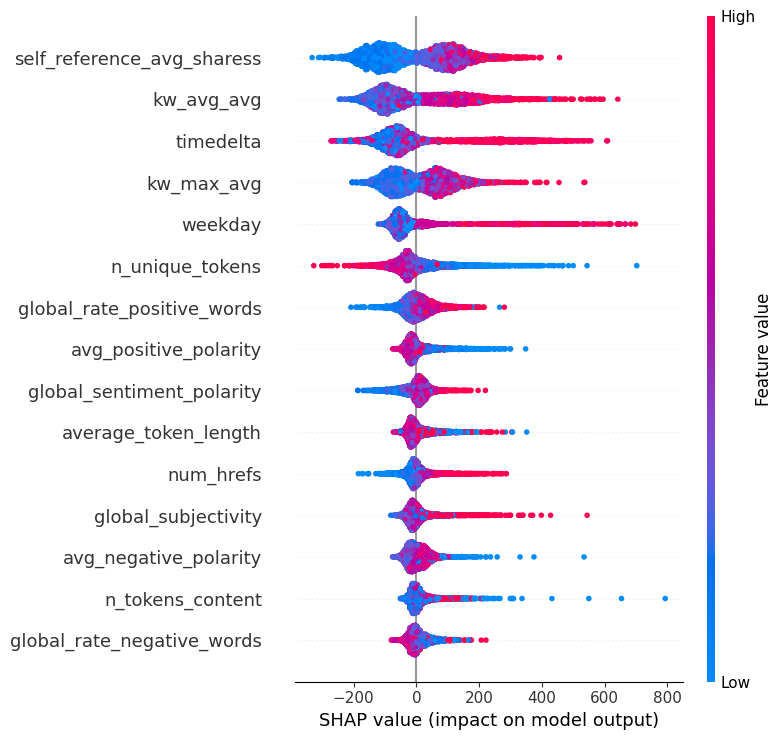

In [121]:
explainer_rfr = shap.TreeExplainer(rfr_top15)
shap_values_rfr = explainer_rfr.shap_values(X_test_topfeatures)
X_test_topfeatures_df = pd.DataFrame(X_test_topfeatures, columns=new_features_rfr)
shap.summary_plot(shap_values_rfr, X_test_topfeatures_df)

<span style="font-size:16px;">This SHAP graph shows the impact of features on the models according to their values. The datapoints points represent the impact of each feature on the model's predictions. The positives SHAP values indicate that the feature increases the model's prediction, while negative values indicate a decrease in the prediction.
- <span style="font-size:16px;">**Self Reference Avg Shares** : high value increase the models prediction
- <span style="font-size:16px;">**kw_avg_avg** : high values increase the model's prediction
- <span style="font-size:16px;">**Timedelta** : high values increase the model's prediction
- <span style="font-size:16px;">**Weekday** : high values increase the model's prediction
- <span style="font-size:16px;">**kw_max_avg** : high values increase the model's prediction
- <span style="font-size:16px;">**n_unique_tokens** : low values increase the model's prediction
- <span style="font-size:16px;">**Global Rate Positive Words** : high values increase the model's prediction
- <span style="font-size:16px;">**avg_positive_polarity** : low valuse increase the model's prediction
- <span style="font-size:16px;">etc...

<span style="font-size:16px;">The distribution of points shows how the impact of the feature varies across different predictions. For example, a wide dispersion of points on the horizontal axis for a specific feature suggests that this feature has a variable impact on the model's prediction.

<span style="font-size:16px;">The order of features on the vertical axis is generally sorted by importance, with the most influential feature at the top.

## **Classification**

### **Binary Classification (Not popular/Popular)**

In [122]:
data_quality_binary_classes = data_quality.copy()

In [123]:
print(data_quality_binary_classes['shares'].mean())
popular=data_quality_binary_classes['shares']>=data_quality_binary_classes['shares'].mean()
unpopular=data_quality_binary_classes['shares']<data_quality_binary_classes['shares'].mean()
data_quality_binary_classes.loc[popular,'shares']=1
data_quality_binary_classes.loc[unpopular,'shares']=0
data_quality_binary_classes['shares'].value_counts()

1540.7552114353782


0    9996
1    5115
Name: shares, dtype: int64

In [124]:
X_train, X_test, y_train, y_test = SplitAndScaler(data_quality_binary_classes, 0.3, True)

#### DecisionTreeClassifier

In [125]:
def DecisionTreeClassifierModel(X_train, y_train):
    dtclassifier_quality = DecisionTreeClassifier(criterion = 'entropy', random_state = 0)
    dtclassifier_quality.fit(X_train, y_train)

    cv_dt_class_quality = cross_val_score(estimator = dtclassifier_quality, X = X_train, y = y_train, n_jobs=-1, cv=6)

    y_pred_dtclassifier_quality_train = dtclassifier_quality.predict(X_train)
    f1_score_dtclassifier_quality_train = f1_score(y_train, y_pred_dtclassifier_quality_train, average='micro')

    y_pred_dtclassifier_quality_test = dtclassifier_quality.predict(X_test)
    f1_score_dtclassifier_quality_test = f1_score(y_test, y_pred_dtclassifier_quality_test, average='micro')

    accuracy_dtclassifier_quality = accuracy_score(y_test, y_pred_dtclassifier_quality_test)
    print("Accuracy dt_class:", accuracy_dtclassifier_quality)
    print('f1_score dt_class(train): ', f1_score_dtclassifier_quality_train)
    print('f1_score dt_class(test): ', f1_score_dtclassifier_quality_test)
    return accuracy_dtclassifier_quality, f1_score_dtclassifier_quality_train, f1_score_dtclassifier_quality_test, cv_dt_class_quality, y_pred_dtclassifier_quality_test

#### K Nearest Neighbors

In [126]:
def KNNClassifierModel(X_train, y_train):
    KNNclassifier_quality = KNeighborsClassifier(n_neighbors = 25)
    KNNclassifier_quality.fit(X_train, y_train)

    cv_knn_class_quality = cross_val_score(estimator = KNNclassifier_quality, X = X_train, y = y_train, n_jobs=-1, cv=6)

    y_pred_knnclassifier_quality_train = KNNclassifier_quality.predict(X_train)
    f1_score_knnclassifier_quality_train = f1_score(y_train, y_pred_knnclassifier_quality_train, average='micro')

    y_pred_knnclassifier_quality_test = KNNclassifier_quality.predict(X_test)
    f1_score_knnclassifier_quality_test = f1_score(y_test, y_pred_knnclassifier_quality_test, average='micro')

    accuracy_knnclassifier_quality = accuracy_score(y_test, y_pred_knnclassifier_quality_test)
    print("Accuracy KNN_class: ", accuracy_knnclassifier_quality)
    print('f1_score KNN_class(train): ', f1_score_knnclassifier_quality_train)
    print('f1_score KNN_class(test): ', f1_score_knnclassifier_quality_test)
    return accuracy_knnclassifier_quality, f1_score_knnclassifier_quality_train, f1_score_knnclassifier_quality_test, cv_knn_class_quality, y_pred_knnclassifier_quality_test

#### Naive Bayes Classifier

In [127]:
def NaiveBayesClassifierModel(X_train, y_train):
    NBclassifier_quality = GaussianNB()
    NBclassifier_quality.fit(X_train, y_train)

    cv_nb_class_quality = cross_val_score(estimator = NBclassifier_quality, X = X_train, y = y_train, cv = 6)

    y_pred_nbclassifier_quality_train = NBclassifier_quality.predict(X_train)
    f1_score_nbclassifier_quality_train = f1_score(y_train, y_pred_nbclassifier_quality_train, average='micro')

    y_pred_nbclassifier_quality_test = NBclassifier_quality.predict(X_test)
    f1_score_nbclassifier_quality_test = f1_score(y_test, y_pred_nbclassifier_quality_test, average='micro')

    # Metrics results
    accuracy_nbclassifier_quality = accuracy_score(y_test, y_pred_nbclassifier_quality_test)
    print("Accuracy NB_class: ", accuracy_nbclassifier_quality)
    print('f1_score NB_class(train): ', f1_score_nbclassifier_quality_train)
    print('f1_score NB_class(test): ', f1_score_nbclassifier_quality_test)
    return accuracy_nbclassifier_quality, f1_score_nbclassifier_quality_train, f1_score_nbclassifier_quality_test, cv_nb_class_quality, y_pred_nbclassifier_quality_test

#### RandomForestClassifier

In [128]:
def RandomForestClassifierModel(X_train, y_train, param_grid):
    if param_grid== None:
        rfclassifier_quality = RandomForestClassifier(random_state = 42)
    else :
        rfclassifier_quality = RandomForestClassifier(
        n_estimators=param_grid['n_estimators'],
        max_depth=param_grid['max_depth'],
        min_samples_split=param_grid['min_samples_split'],
        min_samples_leaf=param_grid['min_samples_leaf'],
        random_state=param_grid['random_state']
        )

    rfclassifier_quality.fit(X_train, y_train)

    cv_rf_class_quality = cross_val_score(estimator = rfclassifier_quality, X = X_train, y = y_train, cv = 6)

    y_pred_rfclassifier_quality_train = rfclassifier_quality.predict(X_train)
    f1_score_rfclassifier_quality_train = f1_score(y_train, y_pred_rfclassifier_quality_train, average='micro')

    y_pred_rfclassifier_quality_test = rfclassifier_quality.predict(X_test)
    f1_score_rfclassifier_quality_test = f1_score(y_test, y_pred_rfclassifier_quality_test, average='micro')

    accuracy_rfclassifier_quality=accuracy_score(y_test, y_pred_rfclassifier_quality_test)
    print("Accuracy rf_class: ", accuracy_rfclassifier_quality)
    print('f1_score rf_class(train): ', f1_score_rfclassifier_quality_train)
    print('f1_score rf_class(test): ', f1_score_rfclassifier_quality_test)
    return rfclassifier_quality, accuracy_rfclassifier_quality, f1_score_rfclassifier_quality_train, f1_score_rfclassifier_quality_test, cv_rf_class_quality,y_pred_rfclassifier_quality_test

#### Evaluation of models

In [129]:
accuracy_dtclassifier_quality, f1_score_dtclassifier_quality_train, f1_score_dtclassifier_quality_test, cv_dt_class_quality, y_pred_dtclassifier_quality_test = DecisionTreeClassifierModel(X_train, y_train)
print("--------------------------------------")
accuracy_knnclassifier_quality, f1_score_knnclassifier_quality_train, f1_score_knnclassifier_quality_test, cv_knn_class_quality, y_pred_knnclassifier_quality_test = KNNClassifierModel(X_train, y_train)
print("--------------------------------------")
accuracy_nbclassifier_quality, f1_score_nbclassifier_quality_train, f1_score_nbclassifier_quality_test, cv_nb_class_quality, y_pred_nbclassifier_quality_test = NaiveBayesClassifierModel(X_train, y_train)
print("--------------------------------------")
rfclassifier_quality, accuracy_rfclassifier_quality, f1_score_rfclassifier_quality_train, f1_score_rfclassifier_quality_test, cv_rf_class_quality, y_pred_rfclassifier_quality_test = RandomForestClassifierModel(X_train, y_train, None)

Accuracy dt_class: 0.6054256726951919
f1_score dt_class(train):  1.0
f1_score dt_class(test):  0.6054256726951919
--------------------------------------
Accuracy KNN_class:  0.6777679752977503
f1_score KNN_class(train):  0.6965112980996502
f1_score KNN_class(test):  0.6777679752977503
--------------------------------------
Accuracy NB_class:  0.6799735333039258
f1_score NB_class(train):  0.6603006523588919
f1_score NB_class(test):  0.6799735333039258
--------------------------------------
Accuracy rf_class:  0.7051168945743274
f1_score rf_class(train):  1.0
f1_score rf_class(test):  0.7051168945743274


In [130]:
modelsClass_quality = [('Decision Tree Classification', accuracy_dtclassifier_quality, f1_score_dtclassifier_quality_train, f1_score_dtclassifier_quality_test, cv_dt_class_quality.mean() ),
          ('K Nearest Neighbors Classification', accuracy_knnclassifier_quality, f1_score_knnclassifier_quality_train, f1_score_knnclassifier_quality_test, cv_knn_class_quality.mean()),
          ('Naive Bayes', accuracy_nbclassifier_quality, f1_score_nbclassifier_quality_train, f1_score_nbclassifier_quality_test, cv_nb_class_quality.mean()),
          ('Random Forest Classification', accuracy_rfclassifier_quality, f1_score_rfclassifier_quality_train, f1_score_rfclassifier_quality_test, cv_rf_class_quality.mean())
         ]

In [131]:
predictions_class_quality = pd.DataFrame(data = modelsClass_quality, columns=['Model', 'Accuracy', 'F1_Score(training)', 'F1_Score(test)', 'Cross-Validation'])
predictions_class_quality

,Model,Accuracy,F1_Score(training),F1_Score(test),Cross-Validation
0,Decision Tree Classification,0.605426,1.000000,0.605426,0.606602
1,K Nearest Neighbors Classification,0.677768,0.696511,0.677768,0.672026
2,Naive Bayes,0.679974,0.660301,0.679974,0.654819
3,Random Forest Classification,0.705117,1.000000,0.705117,0.693392


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


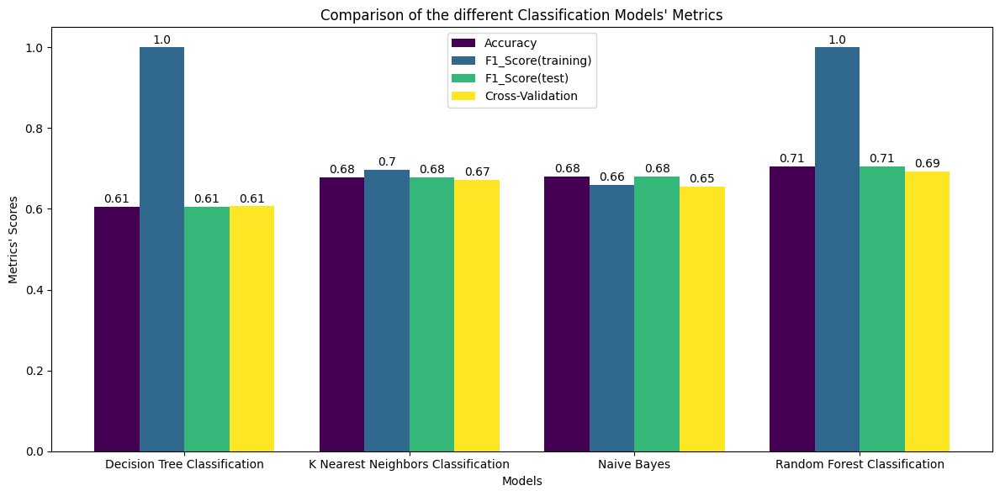

In [132]:
metrics = ['Accuracy', 'F1_Score(training)', 'F1_Score(test)', 'Cross-Validation']
scores = {metric: [model[i+1] for model in modelsClass_quality] for i, metric in enumerate(metrics)}
models_binaryclassification_list = [model[0] for model in modelsClass_quality]
index = np.arange(len(models_binaryclassification_list))

bar_width = 0.2
plt.figure(figsize=(12, 6))
colors = cm.get_cmap('viridis')(np.linspace(0, 1, len(metrics)))

for i, metric in enumerate(metrics):
    plt.bar(index + i * bar_width, scores[metric], bar_width, label=metric, color=colors[i])
    for j, score in enumerate(scores[metric]):
        plt.text(index[j] + i * bar_width, score + 0.01, round(score, 2), ha='center')

plt.xlabel("Models")
plt.ylabel("Metrics' Scores")
plt.title("Comparison of the different Classification Models' Metrics")
plt.xticks(index + bar_width*1.5, models_binaryclassification_list)
plt.legend()
plt.tight_layout()
plt.show()

##### Analysis of the models

<span style="font-size:18px;">**Decision Tree Classification:**

- <span style="font-size:16px;">Has relatively lower accuracy compared to the other models.
- <span style="font-size:16px;">The F1 Score for the training set is perfect (1.0), which suggests overfitting as it does not match the F1 Score for the test set.
- <span style="font-size:16px;">The F1 Score for the test set and the cross-validation score are the same and relatively low, indicating the model does not generalize well.

<span style="font-size:18px;">**K Nearest Neighbors (KNN) Classification:**

- <span style="font-size:16px;">Shows better accuracy than the decision tree but not the highest among the models.
- <span style="font-size:16px;">The F1 Score for the training set is reasonable, but it's not that good for the test set.
- <span style="font-size:16px;">The cross-validation score is close to the test F1 Score, indicating some consistency in the model's performance.

<span style="font-size:18px;">**Naive Bayes Classification:**

- <span style="font-size:16px;">Has the highest accuracy among all the models (by a little).
- <span style="font-size:16px;">The F1 Score is consistent between training and testing, suggesting good generalization without overfitting.
- <span style="font-size:16px;">The cross-validation score is close to the test F1 Scores, reinforcing the idea that the model generalizes well.

<span style="font-size:18px;">**Random Forest Classification:**

- <span style="font-size:16px;">Has ALMOST the same accuracy as Naive Bayes model.
- <span style="font-size:16px;">The F1 Score for training is very high, indicating potential slight overfitting, but not as severe as the decision tree.
- <span style="font-size:16px;">The cross-validation score is the highest among all models, suggesting good generalization.

<span style="font-size:18px;">**Conclusion:**
> <span style="font-size:16px;">Considering the metrics, the Random Forest Classifier model appears to offer the best generalization according to the cross-validation score, despite slight overfitting. However, the Naive Bayes model is very close, but we will go for Random Forest.

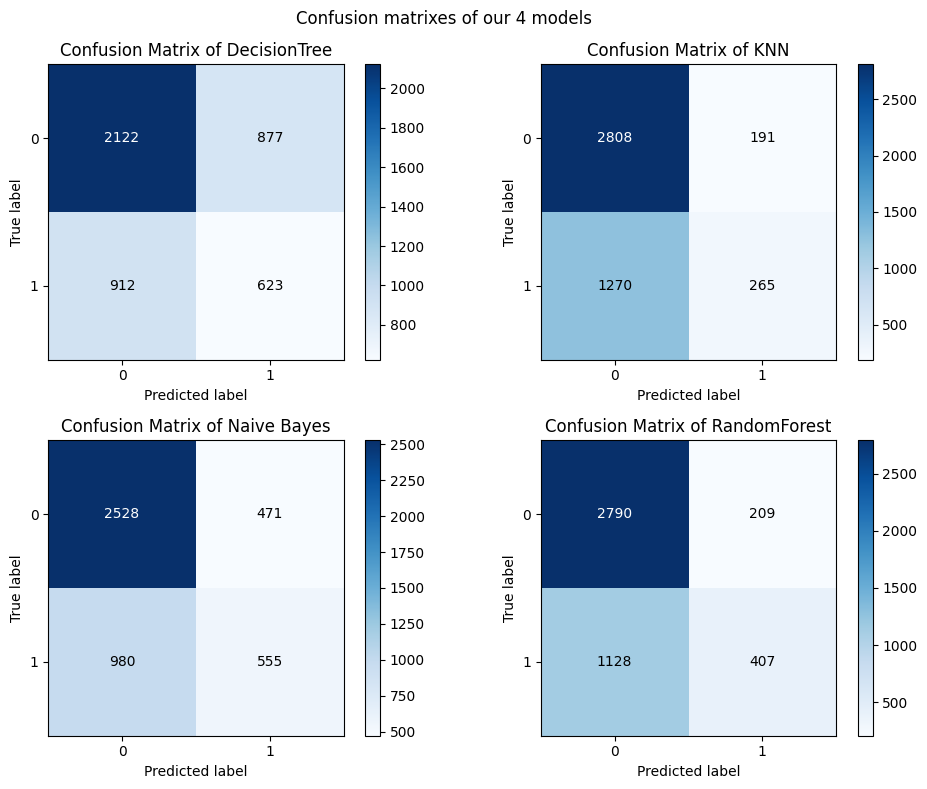

In [133]:
fig, axes = plt.subplots(2,2, figsize=(10,8))
skplt.metrics.plot_confusion_matrix(y_test, y_pred_dtclassifier_quality_test, normalize=False, title = 'Confusion Matrix of DecisionTree', ax=axes[0,0])
skplt.metrics.plot_confusion_matrix(y_test, y_pred_knnclassifier_quality_test, normalize=False, title = 'Confusion Matrix of KNN', ax=axes[0,1])
skplt.metrics.plot_confusion_matrix(y_test, y_pred_nbclassifier_quality_test, normalize=False, title = 'Confusion Matrix of Naive Bayes', ax=axes[1,0])
skplt.metrics.plot_confusion_matrix(y_test, y_pred_rfclassifier_quality_test, normalize=False, title = 'Confusion Matrix of RandomForest', ax=axes[1,1])
plt.suptitle("Confusion matrixes of our 4 models")
plt.tight_layout()
plt.show()

<span style="font-size:16px;">We can observe that the most part of the good predictions are for the unpopular articles. Popular articles are tough to predict, and for every model, we can see that the principal error is predicting that an article is unpopular even though it is in reality.

<span style="font-size:16px;">Let's try to optimize with GridSearch:

#### GridSearch

In [134]:
#This cell of code took about 40-45min
"""
param_grid = {
    'n_estimators': [10, 50, 100],
    'max_depth': [10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

grid_rfclass = RandomForestClassifier()
grid_search = GridSearchCV(estimator = grid_rfclass, param_grid = param_grid, cv = 5, n_jobs = -1)
grid_search.fit(X_train, y_train)

print("Best parameters found : ", grid_search.best_params_)
print("Best estimator found : ", grid_search.best_estimator_)

Outputs :
Best parameters found :  {'bootstrap': False, 'max_depth': 30, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 100}
Best estimator found :  RandomForestClassifier(bootstrap=False, max_depth=30, min_samples_leaf=4,
                       min_samples_split=10)
"""

'\nparam_grid = {\n    \'n_estimators\': [10, 50, 100],\n    \'max_depth\': [10, 20, 30],\n    \'min_samples_split\': [2, 5, 10],\n    \'min_samples_leaf\': [1, 2, 4],\n    \'bootstrap\': [True, False]\n}\n\ngrid_rfclass = RandomForestClassifier()\ngrid_search = GridSearchCV(estimator = grid_rfclass, param_grid = param_grid, cv = 5, n_jobs = -1)\ngrid_search.fit(X_train, y_train)\n\nprint("Best parameters found : ", grid_search.best_params_)\nprint("Best estimator found : ", grid_search.best_estimator_)\n\nOutputs :\nBest parameters found :  {\'bootstrap\': False, \'max_depth\': 30, \'min_samples_leaf\': 4, \'min_samples_split\': 10, \'n_estimators\': 100}\nBest estimator found :  RandomForestClassifier(bootstrap=False, max_depth=30, min_samples_leaf=4,\n                       min_samples_split=10)\n'

In [135]:
#This cell of code took about 30min
"""
param_grid = {
    'n_estimators': [100,200],
    'max_depth': [30,50],
    'min_samples_split': [10,20],
    'min_samples_leaf': [4,5],
}

grid_rfclass = RandomForestClassifier()
grid_search = GridSearchCV(estimator = grid_rfclass, param_grid = param_grid, cv = 5, n_jobs = -1)
grid_search.fit(X_train, y_train)

print("Best parameters found : ", grid_search.best_params_)
print("Best estimator found : ", grid_search.best_estimator_)
print("Score associated : ",grid_search.best_score_)

Outputs :
Best parameters found :  {'max_depth': 30, 'min_samples_leaf': 4, 'min_samples_split': 20, 'n_estimators': 200}
Best estimator found :  RandomForestClassifier(max_depth=30, min_samples_leaf=4, min_samples_split=20,
                       n_estimators=200)
Score associated :  0.688181619066665
"""

'\nparam_grid = {\n    \'n_estimators\': [100,200],\n    \'max_depth\': [30,50],\n    \'min_samples_split\': [10,20],\n    \'min_samples_leaf\': [4,5],\n}\n\ngrid_rfclass = RandomForestClassifier()\ngrid_search = GridSearchCV(estimator = grid_rfclass, param_grid = param_grid, cv = 5, n_jobs = -1)\ngrid_search.fit(X_train, y_train)\n\nprint("Best parameters found : ", grid_search.best_params_)\nprint("Best estimator found : ", grid_search.best_estimator_)\nprint("Score associated : ",grid_search.best_score_)\n\nOutputs :\nBest parameters found :  {\'max_depth\': 30, \'min_samples_leaf\': 4, \'min_samples_split\': 20, \'n_estimators\': 200}\nBest estimator found :  RandomForestClassifier(max_depth=30, min_samples_leaf=4, min_samples_split=20,\n                       n_estimators=200)\nScore associated :  0.688181619066665\n'

In [136]:
#param_grid = {
#    'n_estimators': [200,300],
#    'max_depth': [30],
#    'min_samples_split': [20,40],
#    'min_samples_leaf': [4]
#}

#grid_rfclass = RandomForestClassifier()
#grid_search = GridSearchCV(estimator = grid_rfclass, param_grid = param_grid, cv = 5, n_jobs = -1)
#grid_search.fit(X_train, y_train)

#print("Best parameters found : ", grid_search.best_params_)
#print("Best estimator found : ", grid_search.best_estimator_)
#print("Score associated : ",grid_search.best_score_)

"""
Output :
Best parameters found :  {'max_depth': 30, 'min_samples_leaf': 4, 'min_samples_split': 20, 'n_estimators': 200}
Best estimator found :  RandomForestClassifier(max_depth=30, min_samples_leaf=4, min_samples_split=20,
                       n_estimators=200)
Score associated :  0.6878970582938029
"""

"\nOutput :\nBest parameters found :  {'max_depth': 30, 'min_samples_leaf': 4, 'min_samples_split': 20, 'n_estimators': 200}\nBest estimator found :  RandomForestClassifier(max_depth=30, min_samples_leaf=4, min_samples_split=20,\n                       n_estimators=200)\nScore associated :  0.6878970582938029\n"

In [137]:
param_grid_rf = {
    'n_estimators': 200,
    'max_depth': 30,
    'min_samples_split': 20,
    'min_samples_leaf': 4,
    'random_state': 42
}

In [138]:
rfclassifier, accuracy_rfclassifier, f1_score_rfclassifier_train, f1_score_rfclassifier_test, cv_rf_class, y_pred_rfclassifier_test = RandomForestClassifierModel(X_train, y_train, param_grid_rf)

Accuracy rf_class:  0.7093074547860608
f1_score rf_class(train):  0.8828590337524818
f1_score rf_class(test):  0.7093074547860608


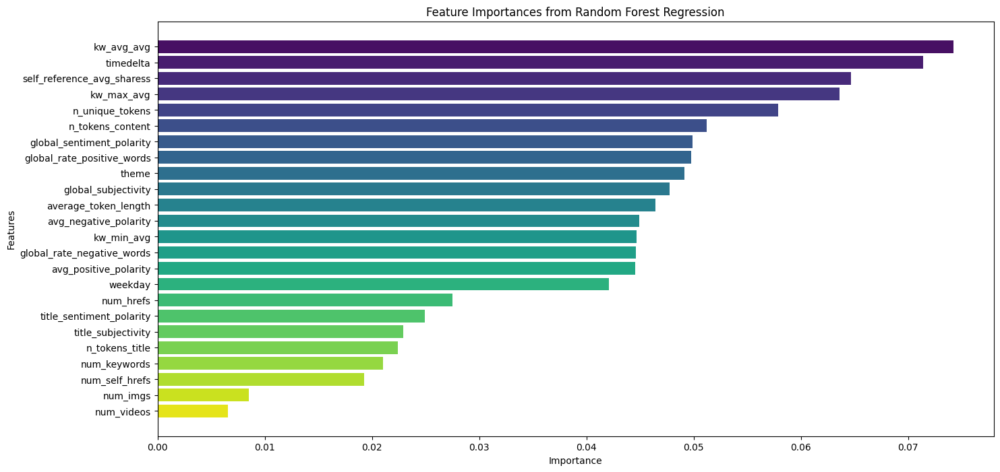

In [139]:
feature_importances = rfclassifier.feature_importances_
feature_names = data_quality.drop(['shares'], axis=1).columns
sorted_indices = np.argsort(feature_importances)[::-1]  # sort the features by their importance

palette = sns.color_palette("viridis", n_colors=len(feature_importances))
plt.figure(figsize=(16, 8))
plt.title("Feature Importances from Random Forest Regression")
plt.barh(range(len(feature_importances)), feature_importances[sorted_indices], color=palette)
plt.yticks(range(len(feature_importances)), feature_names[sorted_indices])
plt.xlabel('Importance')
plt.ylabel('Features')
plt.gca().invert_yaxis()
plt.show()

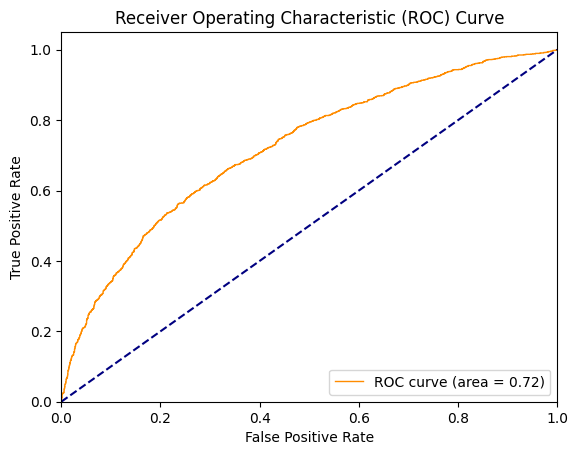

In [140]:
probas_rf = rfclassifier.predict_proba(X_test)
probas_rf = probas_rf[:,1] #keep the probabilities of the class positive only
fpr, tpr, thresholds = roc_curve(y_test, probas_rf)
roc_auc = auc(fpr, tpr)

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=1, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

#### Testing with Top 15 features

In [141]:
new_features = feature_names[sorted_indices][:15].append(pd.Index(['shares']))
X_train_topfeatures, X_test_topfeatures, y_train_topfeatures, y_test_topfeatures = SplitAndScaler(data_quality_binary_classes[new_features], 0.3, True)

In [142]:
"""
param_grid_top15 = {
    'n_estimators': [100,200],
    'max_depth': [30,50],
    'min_samples_split': [5,10],
    'min_samples_leaf': [4,5]
}

grid_rfclass_quality_top15 = RandomForestClassifier()
grid_search_top15 = GridSearchCV(estimator = grid_rfclass_quality_top15, param_grid = param_grid_top15, cv = 5, n_jobs = -1)
grid_search_top15.fit(X_train_topfeatures, y_train_topfeatures)

print("Best parameters found : ", grid_search_top15.best_params_)
print("Score associated : ",grid_search_top15.best_score_)

Output :
Best parameters found :  {'max_depth': 50, 'min_samples_leaf': 5, 'min_samples_split': 5, 'n_estimators': 200}
Score associated :  0.6893212367678287
"""

'\nparam_grid_top15 = {\n    \'n_estimators\': [100,200],\n    \'max_depth\': [30,50],\n    \'min_samples_split\': [5,10],\n    \'min_samples_leaf\': [4,5]\n}\n\ngrid_rfclass_quality_top15 = RandomForestClassifier()\ngrid_search_top15 = GridSearchCV(estimator = grid_rfclass_quality_top15, param_grid = param_grid_top15, cv = 5, n_jobs = -1)\ngrid_search_top15.fit(X_train_topfeatures, y_train_topfeatures)\n\nprint("Best parameters found : ", grid_search_top15.best_params_)\nprint("Score associated : ",grid_search_top15.best_score_)\n\nOutput :\nBest parameters found :  {\'max_depth\': 50, \'min_samples_leaf\': 5, \'min_samples_split\': 5, \'n_estimators\': 200}\nScore associated :  0.6893212367678287\n'

In [143]:
rfclass_quality_top15 = RandomForestClassifier(n_estimators=200,max_depth=50,min_samples_split=5,min_samples_leaf=5,random_state=42)
rfclass_quality_top15.fit(X_train_topfeatures, y_train_topfeatures)

cv_rfclass_quality_top15 = cross_val_score(estimator = rfclass_quality_top15, X = X_train_topfeatures, y = y_train_topfeatures, cv = 6)

y_pred_rfclass_quality_top15_train = rfclass_quality_top15.predict(X_train_topfeatures)
f1_score_rfclass_quality_top15_train = f1_score(y_train_topfeatures, y_pred_rfclass_quality_top15_train, average='micro')

y_pred_rfclass_quality_top15_test = rfclass_quality_top15.predict(X_test_topfeatures)
f1_score_rfclass_quality_top15_test = f1_score(y_test_topfeatures, y_pred_rfclass_quality_top15_test, average='micro')

accuracy_rfclass_quality_top15=accuracy_score(y_test_topfeatures, y_pred_rfclass_quality_top15_test)
print("Accuracy rf_class: ", accuracy_rfclass_quality_top15)
print('f1_score rf_class(train): ', f1_score_rfclass_quality_top15_train)
print('f1_score rf_class(test): ', f1_score_rfclass_quality_top15_test)

Accuracy rf_class:  0.7011468901632113
f1_score rf_class(train):  0.9191642242601872
f1_score rf_class(test):  0.7011468901632113


<span style="font-size:16px;">The accuracy is slightly worse, and the training a little better, but the most important thing remains the accuracy on the test set. So it doesn't have an importance, doesn't make improvement on the model to keep the 15 most important features.

<span style="font-size:16px;">However, binary classification is way better than regresion. Let's see if we could do better on **multi-labels classification**.

### **Multi-Labels**

In [144]:
data_quality_multi_classes = data_quality.copy()
data_quality_multi_classes_plot = data_quality.copy()
multi_labels, bins = pd.qcut(data_quality_multi_classes['shares'], q=5, labels=False, retbins=True)
data_quality_multi_classes['shares'] = multi_labels
data_quality_multi_classes_plot['popularity'] = multi_labels

In [145]:
X_train, X_test, y_train, y_test = SplitAndScaler(data_quality_multi_classes, 0.3, True)

In [146]:
accuracy_dtclassifier_quality, f1_score_dtclassifier_quality_train, f1_score_dtclassifier_quality_test, cv_dt_class_quality, y_pred_dtclassifier_quality_test = DecisionTreeClassifierModel(X_train, y_train)
print("--------------------------------------")
accuracy_knnclassifier_quality, f1_score_knnclassifier_quality_train, f1_score_knnclassifier_quality_test, cv_knn_class_quality, y_pred_knnclassifier_quality_test = KNNClassifierModel(X_train, y_train)
print("--------------------------------------")
accuracy_nbclassifier_quality, f1_score_nbclassifier_quality_train, f1_score_nbclassifier_quality_test, cv_nb_class_quality, y_pred_nbclassifier_quality_test = NaiveBayesClassifierModel(X_train, y_train)
print("--------------------------------------")
rfclassifier_quality, accuracy_rfclassifier_quality, f1_score_rfclassifier_quality_train, f1_score_rfclassifier_quality_test, cv_rf_class_quality, y_pred_rfclassifier_quality_test = RandomForestClassifierModel(X_train, y_train, None)

Accuracy dt_class: 0.2516541685046317
f1_score dt_class(train):  1.0
f1_score dt_class(test):  0.2516541685046317
--------------------------------------
Accuracy KNN_class:  0.27591530657256286
f1_score KNN_class(train):  0.3665500614540985
f1_score KNN_class(test):  0.27591530657256286
--------------------------------------
Accuracy NB_class:  0.30149977944419937
f1_score NB_class(train):  0.29857237401909803
f1_score NB_class(test):  0.30149977944419937
--------------------------------------
Accuracy rf_class:  0.3266431407146008
f1_score rf_class(train):  1.0
f1_score rf_class(test):  0.3266431407146008


In [147]:
modelsMultiClass_quality = [('Decision Tree Classification', accuracy_dtclassifier_quality, f1_score_dtclassifier_quality_train, f1_score_dtclassifier_quality_test, cv_dt_class_quality.mean() ),
          ('K Nearest Neighbors Classification', accuracy_knnclassifier_quality, f1_score_knnclassifier_quality_train, f1_score_knnclassifier_quality_test, cv_knn_class_quality.mean()),
          ('Naive Bayes', accuracy_nbclassifier_quality, f1_score_nbclassifier_quality_train, f1_score_nbclassifier_quality_test, cv_nb_class_quality.mean()),
          ('Random Forest Classification', accuracy_rfclassifier_quality, f1_score_rfclassifier_quality_train, f1_score_rfclassifier_quality_test, cv_rf_class_quality.mean())
         ]

In [148]:
predictions_multiclass_quality = pd.DataFrame(data = modelsMultiClass_quality, columns=['Model', 'Accuracy', 'F1_Score(training)', 'F1_Score(test)', 'Cross-Validation'])
predictions_multiclass_quality

,Model,Accuracy,F1_Score(training),F1_Score(test),Cross-Validation
0,Decision Tree Classification,0.251654,1.000000,0.251654,0.256122
1,K Nearest Neighbors Classification,0.275915,0.366550,0.275915,0.278813
2,Naive Bayes,0.301500,0.298572,0.301500,0.293088
3,Random Forest Classification,0.326643,1.000000,0.326643,0.329206


The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


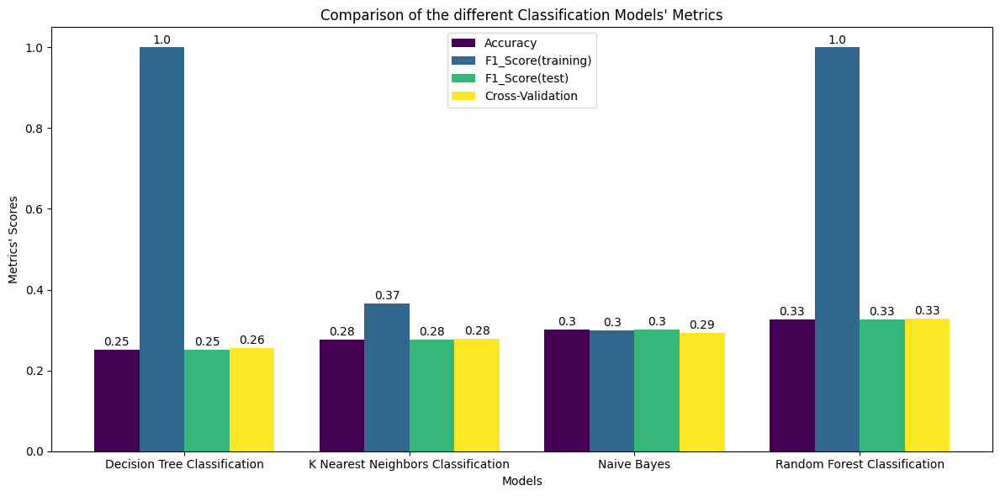

In [149]:
metrics = ['Accuracy', 'F1_Score(training)', 'F1_Score(test)', 'Cross-Validation']
scores = {metric: [model[i+1] for model in modelsMultiClass_quality] for i, metric in enumerate(metrics)}
models_multiclassification_list = [model[0] for model in modelsMultiClass_quality]
index = np.arange(len(models_multiclassification_list))

bar_width = 0.2
plt.figure(figsize=(12, 6))

colors = cm.get_cmap('viridis')(np.linspace(0, 1, len(metrics)))

for i, metric in enumerate(metrics):
    plt.bar(index + i * bar_width, scores[metric], bar_width, label=metric, color=colors[i])
    for j, score in enumerate(scores[metric]):
        plt.text(index[j] + i * bar_width, score + 0.01, round(score, 2), ha='center')

plt.xlabel("Models")
plt.ylabel("Metrics' Scores")
plt.title("Comparison of the different Classification Models' Metrics")
plt.xticks(index + bar_width*1.5, models_multiclassification_list)
plt.legend()
plt.tight_layout()
plt.show()

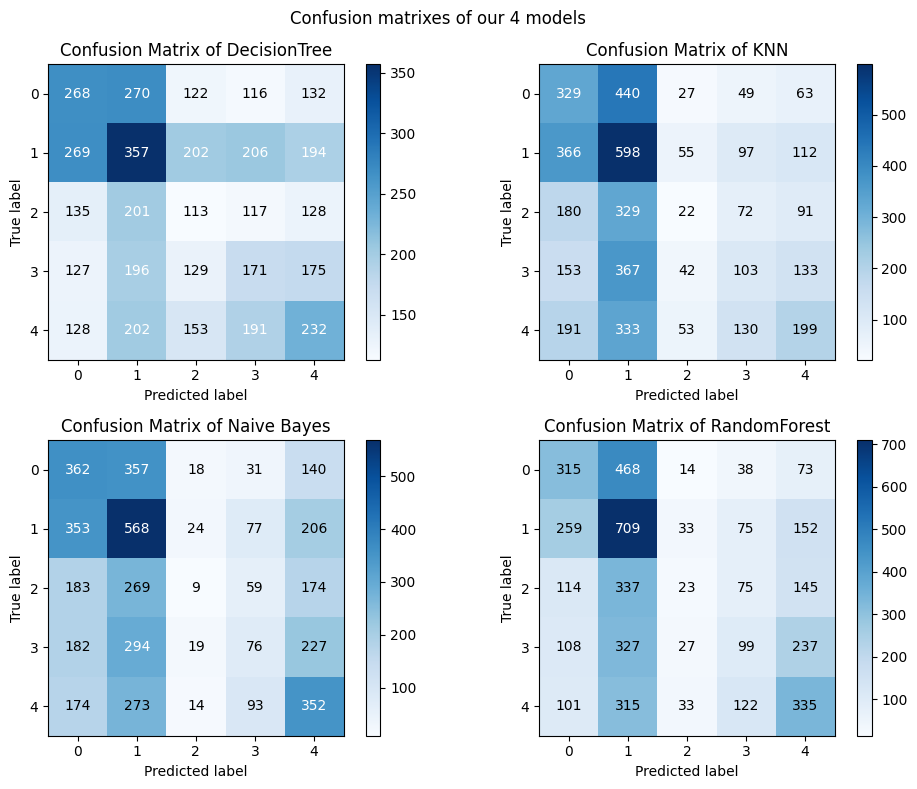

In [150]:
fig, axes = plt.subplots(2,2, figsize=(10,8))
skplt.metrics.plot_confusion_matrix(y_test, y_pred_dtclassifier_quality_test, normalize=False, title = 'Confusion Matrix of DecisionTree', ax=axes[0,0])
skplt.metrics.plot_confusion_matrix(y_test, y_pred_knnclassifier_quality_test, normalize=False, title = 'Confusion Matrix of KNN', ax=axes[0,1])
skplt.metrics.plot_confusion_matrix(y_test, y_pred_nbclassifier_quality_test, normalize=False, title = 'Confusion Matrix of Naive Bayes', ax=axes[1,0])
skplt.metrics.plot_confusion_matrix(y_test, y_pred_rfclassifier_quality_test, normalize=False, title = 'Confusion Matrix of RandomForest', ax=axes[1,1])
plt.suptitle("Confusion matrixes of our 4 models")
plt.tight_layout()
plt.show()

<span style="font-size:16px;">We are going to comment more on the multi classification, as the binary classification, the Random Forest is demonstrating the best results, but the accuracy has dropped a lot, 32% of accuracy is not that good..!

## **Deep Learning using TensorFlow**

<span style="font-size:18px;">So, the binary classification gave the best results, let's see if we can do better with a neural network based on Keras:

### **Binary classification**

In [151]:
data_quality_binary_classes = data_quality.copy()
print(data_quality_binary_classes['shares'].mean())
popular=data_quality_binary_classes['shares']>=data_quality_binary_classes['shares'].mean()
unpopular=data_quality_binary_classes['shares']<data_quality_binary_classes['shares'].mean()
data_quality_binary_classes.loc[popular,'shares']=1
data_quality_binary_classes.loc[unpopular,'shares']=0
data_quality_binary_classes['shares'].value_counts()

1540.7552114353782


0    9996
1    5115
Name: shares, dtype: int64

In [152]:
X_train, X_test, y_train, y_test = SplitAndScaler(data_quality_binary_classes, 0.2, True)
validation_size=int(X_test.shape[0])
X_val=X_train[:validation_size]
X_train=X_train[validation_size:]

y_val=y_train[:validation_size]
y_train=y_train[validation_size:]
print("X_val",X_val.shape)
print("X_test",X_test.shape)
print("y_val",y_val.shape)
print("y_test",y_test.shape)
print("X_train",X_train.shape)
print("y_train",y_train.shape)
print("train+set+val=",X_val.shape[0]+X_test.shape[0]+X_train.shape[0])
print("'data_quality_binary_classes' rows",data_quality_binary_classes.shape[0])

X_val (3023, 24)
X_test (3023, 24)
y_val (3023,)
y_test (3023,)
X_train (9065, 24)
y_train (9065,)
train+set+val= 15111
'data_quality_binary_classes' rows 15111


In [153]:
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)
y_val = to_categorical(y_val)

In [154]:
ann_binary = Sequential()

ann_binary.add(Dense(input_shape = (24,), units = 256, activation='relu'))
ann_binary.add(Dropout(0.3)) #we add Dropout because the model was overfitting
ann_binary.add(BatchNormalization())
ann_binary.add(Dense(units=128, activation='relu'))
ann_binary.add(Dropout(0.3))
ann_binary.add(Dense(units=64, activation='relu'))
ann_binary.add(Dropout(0.3))
ann_binary.add(Dense(units=32, activation='relu'))
ann_binary.add(Dense(units=2, activation='sigmoid'))

In [155]:
ann_binary.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])

early_stop = EarlyStopping(monitor='val_loss', patience=2)
history = ann_binary.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=20, callbacks=[early_stop])


Epoch 1/20


284/284 [==============================] - 3s 5ms/step - loss: 0.6418 - accuracy: 0.6491 - val_loss: 0.6175 - val_accuracy: 0.6619
Epoch 2/20
284/284 [==============================] - 1s 4ms/step - loss: 0.6121 - accuracy: 0.6726 - val_loss: 0.6063 - val_accuracy: 0.6705
Epoch 3/20
284/284 [==============================] - 1s 4ms/step - loss: 0.5990 - accuracy: 0.6834 - val_loss: 0.6024 - val_accuracy: 0.6755
Epoch 4/20
284/284 [==============================] - 1s 4ms/step - loss: 0.5978 - accuracy: 0.6845 - val_loss: 0.5989 - val_accuracy: 0.6775
Epoch 5/20
284/284 [==============================] - 1s 3ms/step - loss: 0.5918 - accuracy: 0.6887 - val_loss: 0.5991 - val_accuracy: 0.6742
Epoch 6/20
284/284 [==============================] - 1s 3ms/step - loss: 0.5883 - accuracy: 0.6927 - val_loss: 0.5968 - val_accuracy: 0.6768
Epoch 7/20
284/284 [==============================] - 1s 5ms/step - loss: 0.5832 - accuracy: 0.6928 - val_loss: 0.6025 - val_accuracy: 0.6742
Epo

In [156]:
ann_binary.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               6400      
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 batch_normalization (Batch  (None, 256)               1024      
 Normalization)                                                  
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                        

In [157]:
accuracy_train = ann_binary.evaluate(X_train, y_train, verbose=0)
accuracy_test = ann_binary.evaluate(X_test, y_test, verbose=0)
print(f"Binary Crossentropy Train : {round(accuracy_train[0],3)} || Accuracy Train : {round(accuracy_train[1],3)}")
print(f"Binary Crossentropy Test  : {round(accuracy_test[0],3)} || Accuracy Test : {round(accuracy_test[1],3)}")

Binary Crossentropy Train : 0.546 || Accuracy Train : 0.719
Binary Crossentropy Test  : 0.604 || Accuracy Test : 0.69


In [158]:
history.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

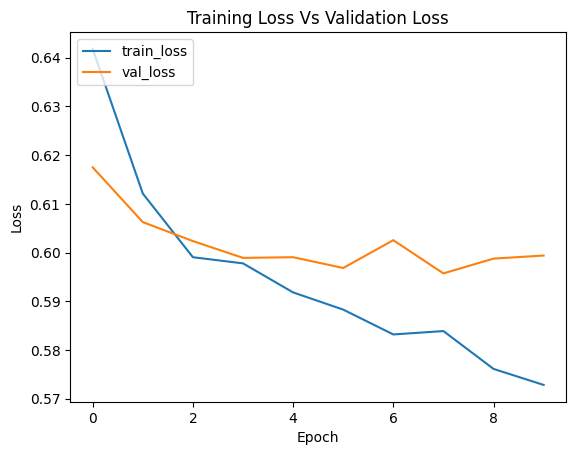

In [159]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Training Loss Vs Validation Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['train_loss', 'val_loss'], loc='upper left')
plt.show()

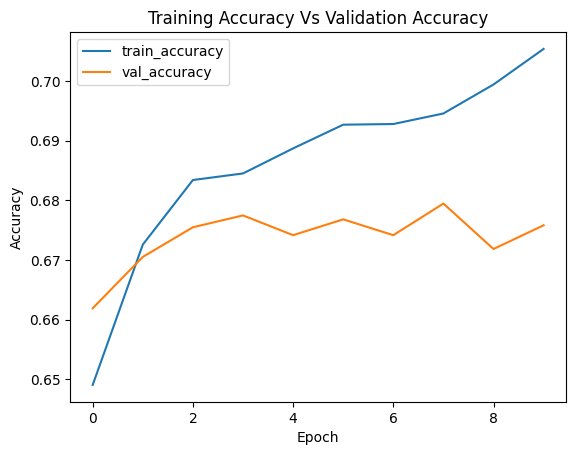

In [160]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Training Accuracy Vs Validation Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['train_accuracy', 'val_accuracy'], loc='upper left')
plt.show()

### **Multi-labels classification**

In [161]:
data_quality_multi_classes = data_quality.copy()
data_quality_multi_classes_plot = data_quality.copy()
multi_labels, bins = pd.qcut(data_quality_multi_classes['shares'], q=5, labels=False, retbins=True)
data_quality_multi_classes['shares'] = multi_labels
data_quality_multi_classes_plot['popularity'] = multi_labels

In [162]:
X_train, X_test, y_train, y_test = SplitAndScaler(data_quality_multi_classes, 0.3, True)
validation_size=int(X_test.shape[0])
X_val=X_train[:validation_size]
X_train=X_train[validation_size:]

y_val=y_train[:validation_size]
y_train=y_train[validation_size:]

In [163]:
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)
y_val = to_categorical(y_val)

In [164]:
ann_multi = Sequential()

ann_multi.add(Dense(input_shape = (24,), units = 256, activation='relu'))
ann_binary.add(Dropout(0.3))
ann_binary.add(BatchNormalization())
ann_binary.add(Dropout(0.3))
ann_multi.add(Dense(units=64, activation='relu'))
ann_binary.add(Dropout(0.3))
ann_multi.add(Dense(units = 5, activation='softmax'))

In [165]:
ann_multi.compile(loss = 'categorical_crossentropy', optimizer='adam', metrics = ['accuracy'])

ann_multi.summary()
early_stop = EarlyStopping(monitor='val_loss', patience=2)
history = ann_multi.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=20, callbacks=[early_stop])

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 256)               6400      
                                                                 
 dense_6 (Dense)             (None, 64)                16448     
                                                                 
 dense_7 (Dense)             (None, 5)                 325       
                                                                 
Total params: 23173 (90.52 KB)
Trainable params: 23173 (90.52 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
Epoch 1/20
189/189 [==============================] - 1s 3ms/step - loss: 1.5643 - accuracy: 0.2815 - val_loss: 1.5416 - val_accuracy: 0.3101
Epoch 2/20
189/189 [==============================] - 1s 3ms/step - loss: 1.5099 - accuracy: 0.3326 - val_loss: 1.5400 - val_accuracy: 0.316

In [166]:
multi_accuracy_train = ann_multi.evaluate(X_train, y_train, verbose=0)
multi_accuracy_test = ann_multi.evaluate(X_test, y_test, verbose=0)
print(f"Categorical Crossentropy Train : {round(multi_accuracy_train[0],3)} || Accuracy Train : {round(multi_accuracy_train[1],3)}")
print(f"Categorical Crossentropy Test  : {round(multi_accuracy_test[0],3)} || Accuracy Test : {round(multi_accuracy_test[1],3)}")

Categorical Crossentropy Train : 1.41 || Accuracy Train : 0.406
Categorical Crossentropy Test  : 1.548 || Accuracy Test : 0.299


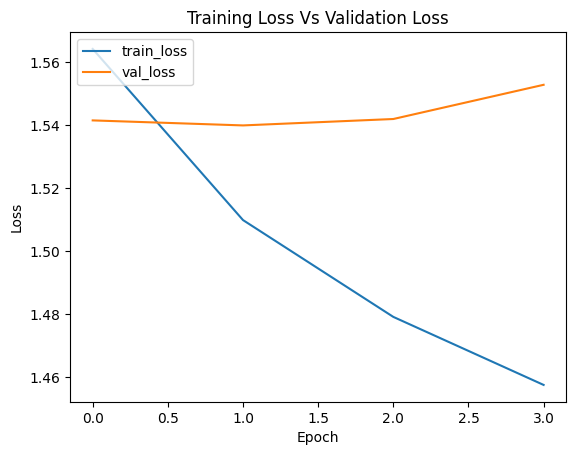

In [167]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Training Loss Vs Validation Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['train_loss', 'val_loss'], loc='upper left')
plt.show()

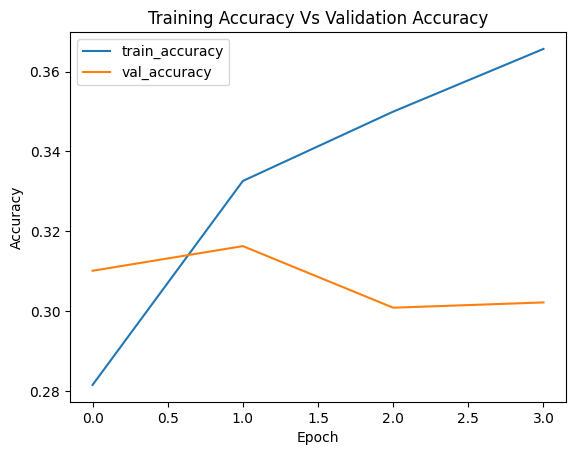

In [168]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Training Accuracy Vs Validation Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['train_accuracy', 'val_accuracy'], loc='upper left')
plt.show()

## **Total results**

<span style="font-size:20px;">Finally, we have seen that our data are <ins>not made for regression models</ins>. We have trained our data on several models of regression :
- <span style="font-size:16px;">LinearRegression
- <span style="font-size:16px;">Lasso
- <span style="font-size:16px;">Decision Tree
- <span style="font-size:16px;">Random Forest
- <span style="font-size:16px;">SVR
<span style="font-size:18px;">The best model was Random Forest with a **R²** on the test set of **10.0%**.
    
---

<span style="font-size:20px;">The <ins>classification is much more appropriate</ins>. The first approach was to split the dataset in two at the level of the average of 'shares', to make a **"Non-Popular"** part and a second **"Popular"** part.

<span style="font-size:20px;">The second classification approach was a distribution into **5 classes**:
- <span style="font-size:16px;">0: The lower bracket for **unpopular articles**
- <span style="font-size:16px;">1: Second installment for **less popular articles**
- <span style="font-size:16px;">2: Third tranche for **neutral articles**
- <span style="font-size:16px;">3: Fourth installment for **popular articles**
- <span style="font-size:16px;">4: The last high bracket for **very popular articles**.

<span style="font-size:18px;">We submitted these two classification tests to several Machine Learning models:
- <span style="font-size:16px;">Decision Tree
- <span style="font-size:16px;">K Nearest Neighbors
- <span style="font-size:16px;">Naive Bayes
- <span style="font-size:16px;">Random Forest

<span style="font-size:18px;">As for regression, the Random Forest Classifier came out with the best accuracy:
- <span style="font-size:16px;">**70.9%** for binary classification (<ins>with GridSearch</ins>) against
- <span style="font-size:16px;">**32.6%** for the 5-class classification

<span style="font-size:18px;">We also decided to push things a little further and take a step into Deep Learning with neural networks created using Keras and TensorFlow.
<span style="font-size:18px;">We had to add Dropouts because the model overfitted during the training phase. Ultimately, the results were as follows:
- <span style="font-size:16px;">**69.0%** for binary classification
- <span style="font-size:16px;">**29.8%** for the 5-class classification.

    
<span style="font-size:18px;">==> Finally, the best predictions are made by the **RandomForestClassifier**, so a Machine Learning model.

---    
    
<span style="font-size:20px;">We begin to consider a model as **“credible”** when it reaches **75% precision or explainability**. Here, we have not managed to achieve this performance in any case, so we think that there is still work and optimizations to be found to try to achieve this score.

# **Data analysis**

<span style="font-size:20px;">Now that the data cleaning is done, we will conduct an analysis through visualizations to understand and determine the factors that contribute to an article from being shared many times. All these articles were published by Mashable.

### **I) Title and content words**

<span style="font-size:20px;">In the first place, we will explore how the quantity and nature of words in both the title and content of an article can impact the article's shareability.

<span style="font-size:18px;">Relation with the number of words in the title and shares.

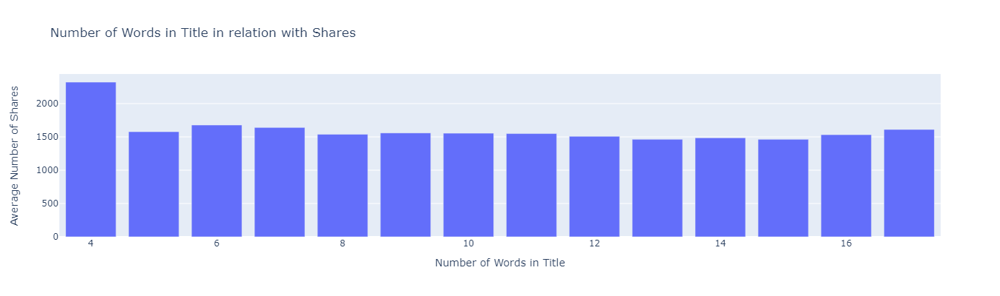

In [169]:
avg_shares_by_title_length = df.groupby('n_tokens_title')['shares'].mean().reset_index()

fig1 = px.bar(avg_shares_by_title_length, x='n_tokens_title', y='shares', title='Number of Words in Title in relation with Shares',
              labels={'n_tokens_title': 'Number of Words in Title', 'shares': 'Average Number of Shares'})

fig1.update_layout(autosize=False, width=600, height=400)
fig1.show()

<span style="font-size:16px;">We observe that a title with 4 words get the maximum average shares.

<span style="font-size:16px;">Relation with the number of words in the content and shares.

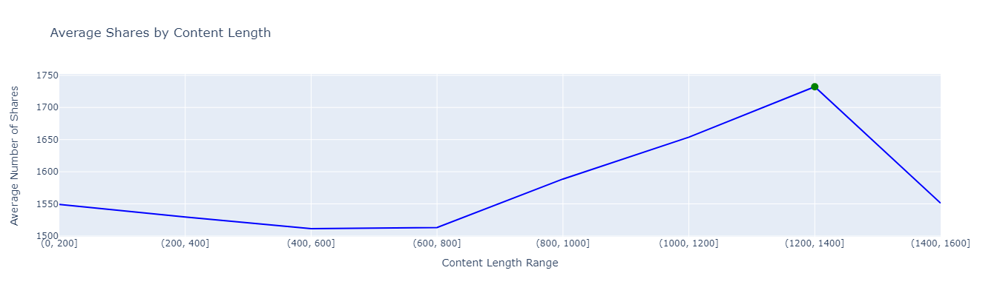

In [170]:
bins = list(range(0, 3500, 200))
df['content_length_bins'] = pd.cut(df['n_tokens_content'], bins=bins).astype(str)
order = [f'({bins[i]}, {bins[i+1]}]' for i in range(len(bins)-1)]

avg_shares_by_content_length = df.groupby('content_length_bins', as_index=False)['shares'].mean()
avg_shares_by_content_length['content_length_bins'] = pd.Categorical(avg_shares_by_content_length['content_length_bins'], categories=order, ordered=True)
avg_shares_by_content_length = avg_shares_by_content_length.sort_values(by='content_length_bins')

max_index = avg_shares_by_content_length['shares'].idxmax()

fig = px.line(avg_shares_by_content_length, x='content_length_bins', y='shares', title='Average Shares by Content Length',
              labels={'content_length_bins': 'Content Length Range', 'shares': 'Average Number of Shares'})

fig.update_traces(line=dict(color='blue', shape='linear'), marker=dict(color='green'), selector=dict(type='scatter'))

fig.add_scatter(x=[avg_shares_by_content_length.loc[max_index, 'content_length_bins']],
                y=[avg_shares_by_content_length.loc[max_index, 'shares']],
                mode='markers',
                marker=dict(color='green', size=10),
                showlegend=False)

fig.update_layout(autosize=False, width=800, height=400)
fig.show()

<span style="font-size:16px;">With this plot, we can see that shares are  slightly positively correlated with the number of words in the content. Here, the maximum of shares is attained for around 1200 to 1400 words in the content.

<span style="font-size:16px;">Now, we aim to conduct a more in-depth analysis of the words within the content.

<span style="font-size:16px;">Let's see how the number of unique words affects the shares. Unique words are words that appears only one time in the content.

C:\Users\sebmo\AppData\Local\Temp\ipykernel_676\984228224.py:5: MatplotlibDeprecationWarning:

The 'use_line_collection' parameter of stem() was deprecated in Matplotlib 3.6 and will be removed two minor releases later. If any parameter follows 'use_line_collection', they should be passed as keyword, not positionally.



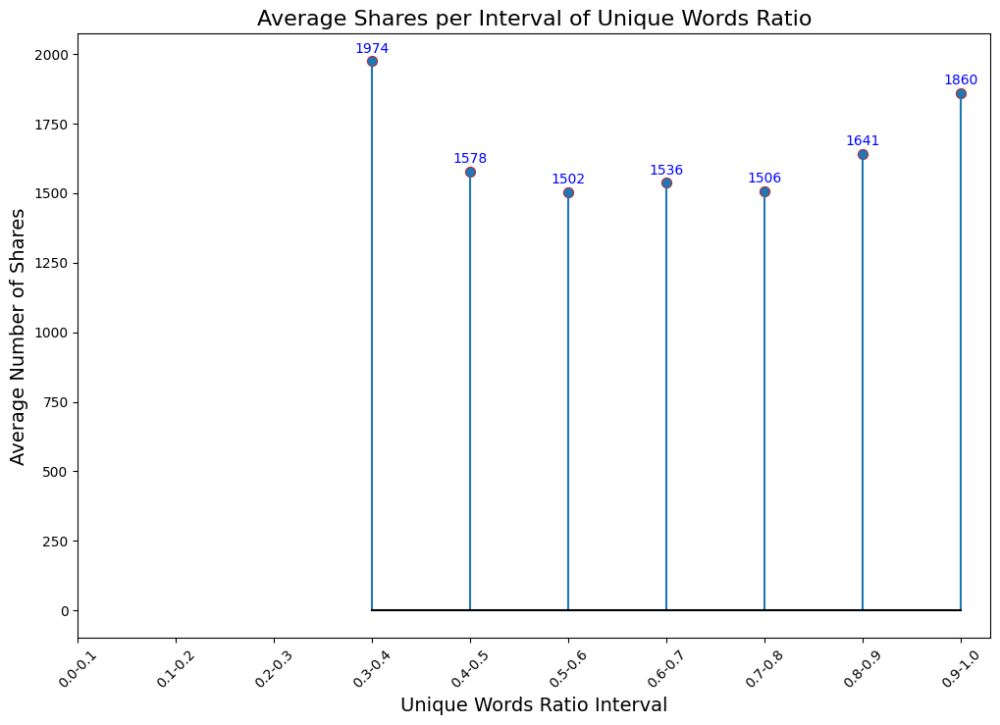

In [171]:
df['n_unique_tokens_bins'] = pd.cut(df['n_unique_tokens'], bins=np.linspace(0, 1, 11), labels=False) * 0.1
avg_shares_by_bins = df.groupby('n_unique_tokens_bins')['shares'].mean().reset_index()

plt.figure(figsize=(12, 8))
plt.stem(avg_shares_by_bins['n_unique_tokens_bins'], avg_shares_by_bins['shares'], basefmt='k-', use_line_collection=True)
plt.scatter(avg_shares_by_bins['n_unique_tokens_bins'], avg_shares_by_bins['shares'], color='red', s=50)
plt.title('Average Shares per Interval of Unique Words Ratio', fontsize=16)
plt.xlabel('Unique Words Ratio Interval', fontsize=14)
plt.ylabel('Average Number of Shares', fontsize=14)

plt.xticks(np.linspace(0, 0.9, 10), [f'{i:.1f}-{i+0.1:.1f}' for i in np.linspace(0, 0.9, 10)], rotation=45)

for i, txt in enumerate(avg_shares_by_bins['shares']):
    plt.text(avg_shares_by_bins['n_unique_tokens_bins'][i], txt + 20, f'{int(txt)}', ha='center', va='bottom', fontsize=10, color='blue')

plt.show()

<span style="font-size:16px;">We see that 30% to 40% of unique words give the best number of average shares. It may be linked to the observation that articles with a greater word count tend to have a higher occurrence of repeated words.

<span style="font-size:16px;">Next, we'll explore how the average word length in content may influence the number of shares.

In [172]:
df['average_token_length'].describe()

count    15111.000000
mean         4.635346
std          0.217294
min          3.653846
25%          4.492308
50%          4.657175
75%          4.805310
max          5.000000
Name: average_token_length, dtype: float64

In [173]:
df['average_token_length'] = df['average_token_length'].apply(lambda x: min(x, 8))

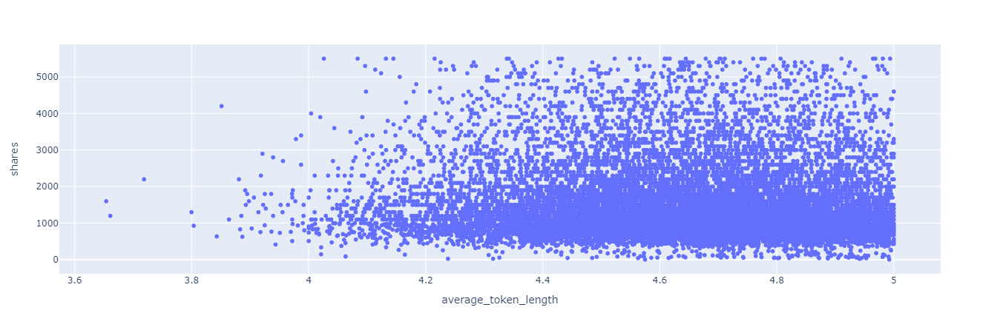

In [174]:
fig = px.scatter(df, x='average_token_length', y='shares')
fig.update_layout(
    width=1000,
    height=450
)
fig.show()

<span style="font-size:16px;">We can observe that content with an average word length between 4 has the highest number of average shares.

<span style="font-size:16px;">After exploring the quantity of words in the titles and content of the articles, we will delve into the quality of the words and their meanings.

<span style="font-size:16px;">Let's now move on the polarity of the words in the content of an article. The polarity of words refers to their emotional tone or sentiment, typically categorized as positive, negative, or neutral. It indicates the subjective feeling conveyed by a word. For example:

<span style="font-size:16px;">Positive Polarity: "Love," "Joy," "Success" |
<span style="font-size:16px;">Negative Polarity: "Hate," "Sadness," "Failure" |
<span style="font-size:16px;">Neutral Polarity: "Table," "Book," "Neutral"

<span style="font-size:16px;">Analyzing the polarity of words helps in sentiment analysis, determining the emotional context of text data.

<span style="font-size:18px;">Relation between words positive/negative global rate with shares

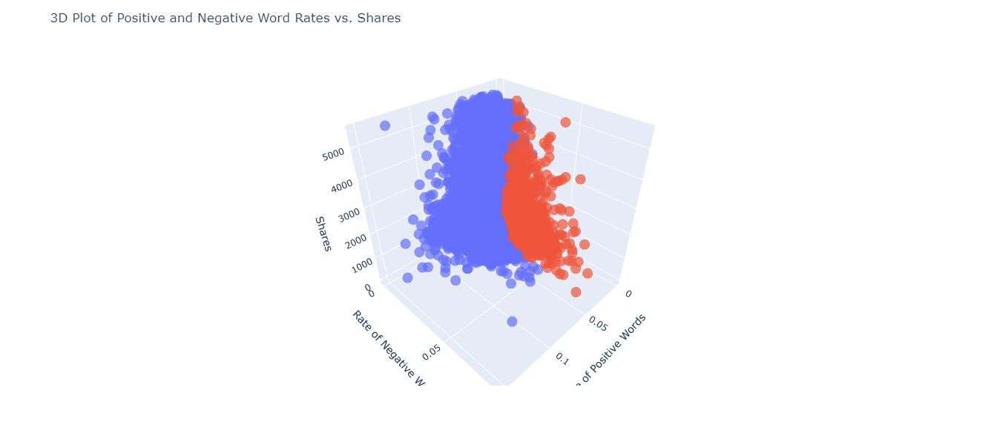

In [175]:
df['color'] = ['red' if neg > pos else 'blue' for neg, pos in zip(df['global_rate_negative_words'], df['global_rate_positive_words'])]

fig = px.scatter_3d(df, x='global_rate_positive_words', y='global_rate_negative_words', z='shares', color='color', size_max=30, opacity=0.7)

fig.update_layout(title='3D Plot of Positive and Negative Word Rates vs. Shares',
                  scene=dict(xaxis_title='Rate of Positive Words', yaxis_title='Rate of Negative Words', zaxis_title='Shares'),
                  showlegend=False, height=600)

fig.show()

<span style="font-size:16px;">With this plot, we see that content with more positive words than negative words seems to have more shares.

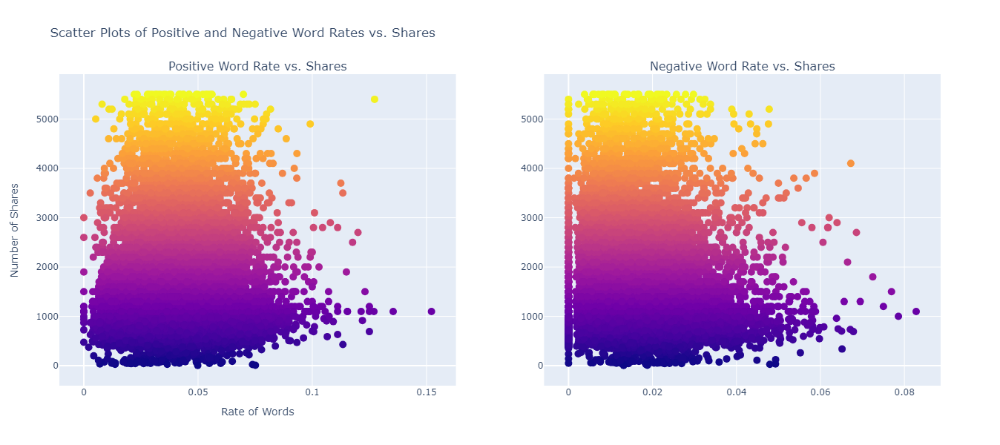

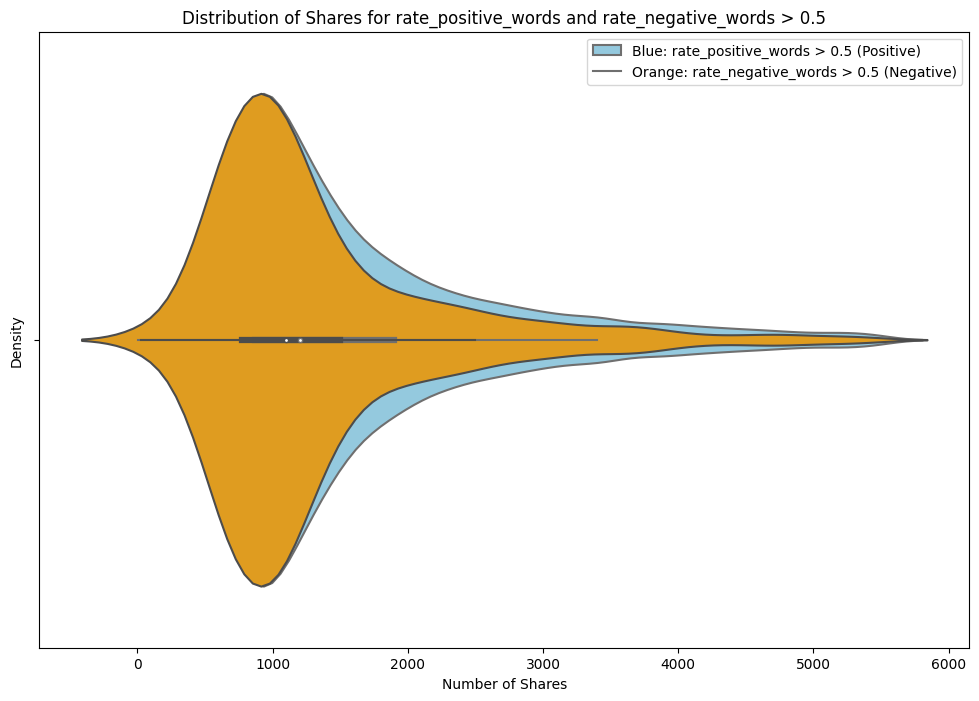

In [176]:
import seaborn as sns
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go


fig = make_subplots(rows=1, cols=2, subplot_titles=['Positive Word Rate vs. Shares', 'Negative Word Rate vs. Shares'])
scatter1 = go.Scatter(x=df['global_rate_positive_words'], y=df['shares'], mode='markers', marker=dict(color=df['shares'], size=10),
                      showlegend=False)
fig.add_trace(scatter1, row=1, col=1)
scatter2 = go.Scatter(x=df['global_rate_negative_words'], y=df['shares'], mode='markers', marker=dict(color=df['shares'], size=10),
                      showlegend=False)
fig.add_trace(scatter2, row=1, col=2)
fig.update_layout(title_text='Scatter Plots of Positive and Negative Word Rates vs. Shares',
                  xaxis=dict(title='Rate of Words'),
                  yaxis=dict(title='Number of Shares'),
                  showlegend=False,
                 height=600)
fig.show()

filtered_data_positive = df[df['global_rate_positive_words'] > df['global_rate_negative_words']]
filtered_data_negative = df[df['global_rate_negative_words'] > df['global_rate_positive_words']]

plt.figure(figsize=(12, 8))
sns.violinplot(x=filtered_data_positive['shares'], color='skyblue')
ax = sns.violinplot(x=filtered_data_negative['shares'], color='orange')
plt.title('Distribution of Shares for rate_positive_words and rate_negative_words > 0.5')
plt.xlabel('Number of Shares')
plt.ylabel('Density')
legend_labels = ['Blue: rate_positive_words > 0.5 (Positive)', 'Orange: rate_negative_words > 0.5 (Negative)']
ax.legend(labels=legend_labels)

plt.show()

<span style="font-size:16px;">With these plots we can see that content with a higher rate of positive words and a lower rate of negatives words get a higher number of shares. And in the opposite, a article with a high rate of negative words will not have as much shares.

<span style="font-size:16px;">But, when we look at the dataset, it's indicated that the polarity of a content is located in the global_sentiment_polarity column. Indeed, an article can have a positive global sentiment while having a rate of positive words lower than the rate of negative words. Like in this example :

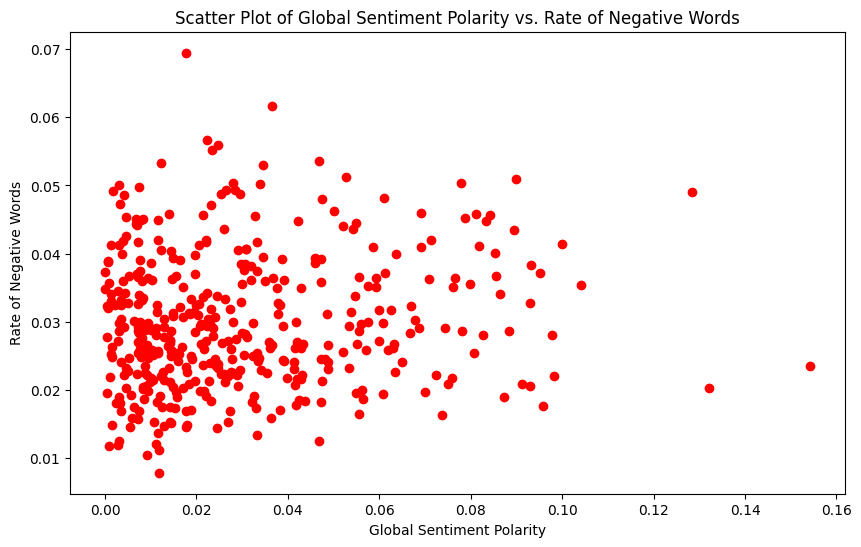

In [177]:
global_pos_rate_neg = df[(df['global_sentiment_polarity'] > 0) & (df['global_rate_negative_words'] > df['global_rate_positive_words'])]

plt.figure(figsize=(10, 6))
plt.scatter(global_pos_rate_neg['global_sentiment_polarity'], global_pos_rate_neg['global_rate_negative_words'],
            color='red', marker='o', label='Filtered Rows')

plt.title('Scatter Plot of Global Sentiment Polarity vs. Rate of Negative Words')
plt.xlabel('Global Sentiment Polarity')
plt.ylabel('Rate of Negative Words')
plt.show()

<span style="font-size:16px;">This plot illustrates, as previously explained, instances where content exhibits a positive global sentiment despite having a negative rate of words greater than 0.5. The explanation behind this is that the global sentiment considers not only the polarity rate but also the degree of polarity for positive and negative words. We will talk about the global_sentiment_polarity column later.

<span style="font-size:16px;">To delve even deeper, we will explore the degree of positive and negative polarities of words among content with more than 50% of positive words (because it means more average shares) to understand the relationship with shares.

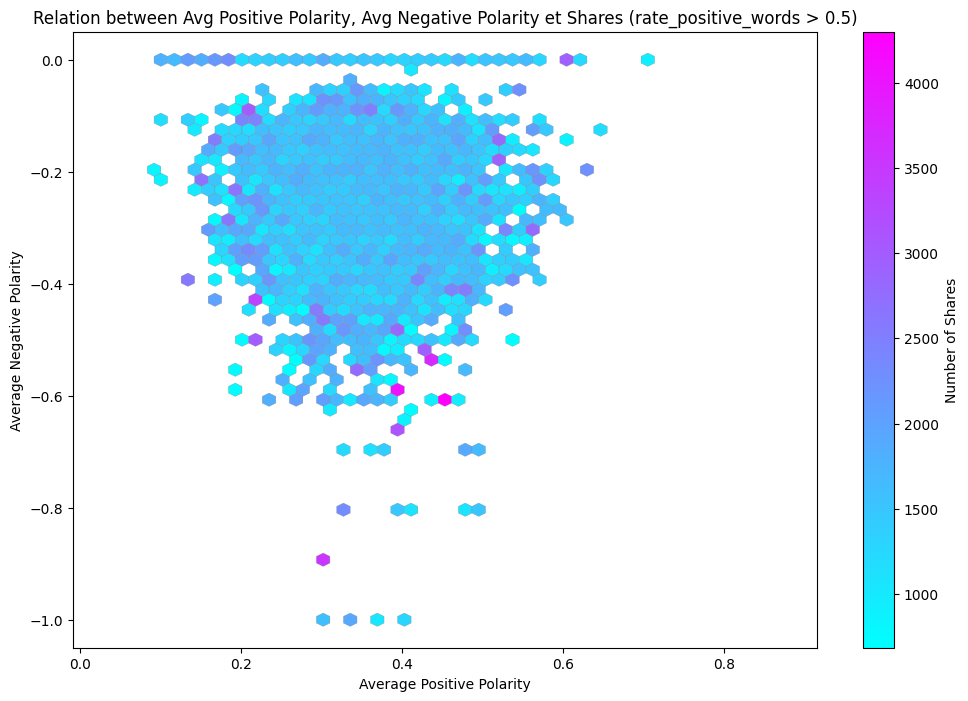

In [178]:
filtered_data_positive = df[df['global_rate_positive_words'] > df['global_rate_negative_words']]

point_size = filtered_data_positive['shares'] / filtered_data_positive['shares'].max() * 200

plt.figure(figsize=(12, 8))
hb = plt.hexbin(filtered_data_positive['avg_positive_polarity'], filtered_data_positive['avg_negative_polarity'],
                C=filtered_data_positive['shares'], gridsize=50, cmap='cool', mincnt=1, edgecolors='gray', linewidths=0.2)

plt.title('Relation between Avg Positive Polarity, Avg Negative Polarity et Shares (rate_positive_words > 0.5)')
plt.xlabel('Average Positive Polarity')
plt.ylabel('Average Negative Polarity')
plt.colorbar(hb, label='Number of Shares')
plt.show()

<span style="font-size:16px;">This plot illustrates that, in order to achieve a substantial number of shares (>2000), the polarity of positive words should be in the range of 20% to 60%, and the polarity of negative words should fall between -5% and -70%. So, even if negative words represent a lower propotion of total words, they can be negative and very negative and play a role in the global sentiment, we will se this in the next part.

<span style="font-size:16px;">Now that we have observed that attributes related to words can influence the number of shares, let's discuss how the understanding and emotions they convey can impact the sharing numbers.

<span style="font-size:16px;">Now that we have observed that attributes related to words can influence the number of shares, let's discuss how the understanding and emotions they convey can impact the sharing numbers.

### **II) Sentiment and subjectivity**

<span style="font-size:18px;">In this part, we're going to look at sentiment and subjectivity. These tell us about the feelings and opinions in the text. Let's see how these factors influence article sharing.

<span style="font-size:16px;">Relation bewteen content sentiment and shares :

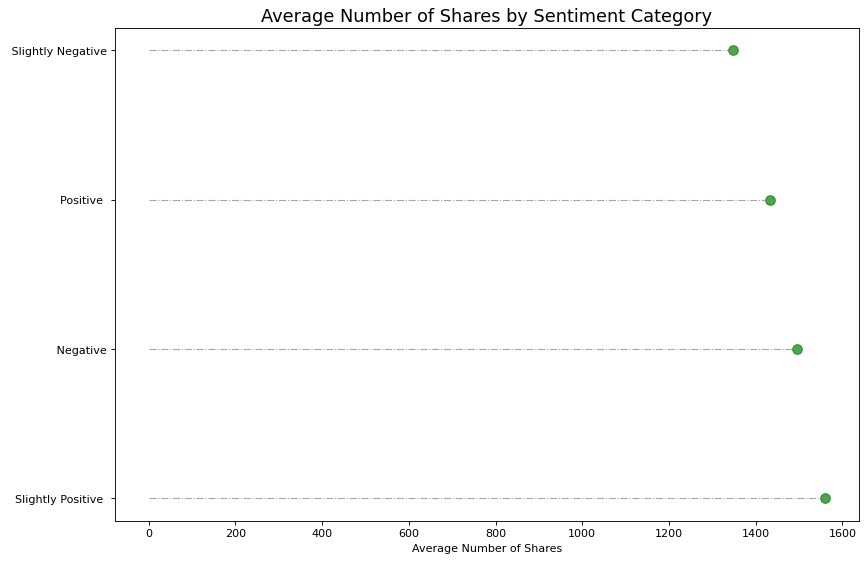

In [179]:
bins_positive = [0, 0.33, 0.67, 1]
labels_positive = ['slightly positive', 'positive', 'very positive']
bins_negative = [-1, -0.67, -0.33, 0]
labels_negative = ['very negative', 'negative', 'slightly negative']

df['positive_sentiment_category'] = pd.cut(df['global_sentiment_polarity'], bins=bins_positive, labels=labels_positive, right=False)
df['negative_sentiment_category'] = pd.cut(df['global_sentiment_polarity'], bins=bins_negative, labels=labels_negative, right=False)

positive_data = df.groupby('positive_sentiment_category')['shares'].mean().reset_index()
negative_data = df.groupby('negative_sentiment_category')['shares'].mean().reset_index()

merged_data = pd.merge(positive_data, negative_data, how='outer', left_on='positive_sentiment_category', right_on='negative_sentiment_category', suffixes=('_positive', '_negative'))
merged_data['positive_sentiment_category'] = merged_data['positive_sentiment_category'].astype(str)

melted_df = pd.melt(merged_data, id_vars=['positive_sentiment_category', 'negative_sentiment_category'],
                    value_vars=['shares_positive', 'shares_negative'],
                    var_name='sentiment_type', value_name='shares')
melted_df['positive_sentiment_category'] = melted_df['positive_sentiment_category'].astype(str)
melted_df['negative_sentiment_category'] = melted_df['negative_sentiment_category'].astype(str)
melted_df['sentiment_category'] = (melted_df['positive_sentiment_category'].replace('nan', '') + ' ' + melted_df['negative_sentiment_category'].replace('nan', ''))
melted_df = melted_df.dropna(subset=['shares'])
melted_df = melted_df[['sentiment_category', 'shares']]
melted_df = melted_df.sort_values(by='shares', ascending=False)

fig, ax = plt.subplots(figsize=(12, 8), dpi=80)
ax.hlines(y=melted_df['sentiment_category'], xmin=0, xmax=melted_df['shares'], color='gray', alpha=0.7, linewidth=1, linestyles='dashdot')
ax.scatter(y=melted_df['sentiment_category'], x=melted_df['shares'], s=75, color='green', alpha=0.7)
ax.set_title('Average Number of Shares by Sentiment Category', fontdict={'size': 16})
ax.set_xlabel('Average Number of Shares')
ax.set_yticks(melted_df['sentiment_category'])
ax.set_yticklabels(melted_df['sentiment_category'].str.title(), fontdict={'horizontalalignment': 'right'})
plt.show()

<span style="font-size:16px;">This plot is very interesting. In the previous part we saw that content with a larger proportion of positive words than negative words get much more shares.

<span style="font-size:16px;">However, in this case, we observe that the sentiment category with the highest number of shares is 'Slightly Positive' corresponding to values between 0 and 0.33 in the 'global_sentiment_polarity' column. But as we can see, the category with the second highest number of shares is "Negative" (-0.33 to -0.66). This illustrates how the polarity of words can significantly influence the overall sentiment. Even though there are more positive words, as seen earlier, the high degree of negativity in the negative words influences the overall sentiment, ultimately rendering it negative.

<span style="font-size:18px;">To conclude the previous section, we could say that to garner a significant number of shares, the content should contain more positive words than negative ones, with the negative words carrying a more impactful weight.

<span style="font-size:18px;">Now, let's explore how the subjectivity of the content and title of an article may relate to the number of shares. The subjectivity of a text indicates how much it conveys a personal opinion, contrasting with objectivity, which reflects neutrality.
Here, it's a score between 0 and 1.

<span style="font-size:16px;">Let's begin with the content subjectivity :

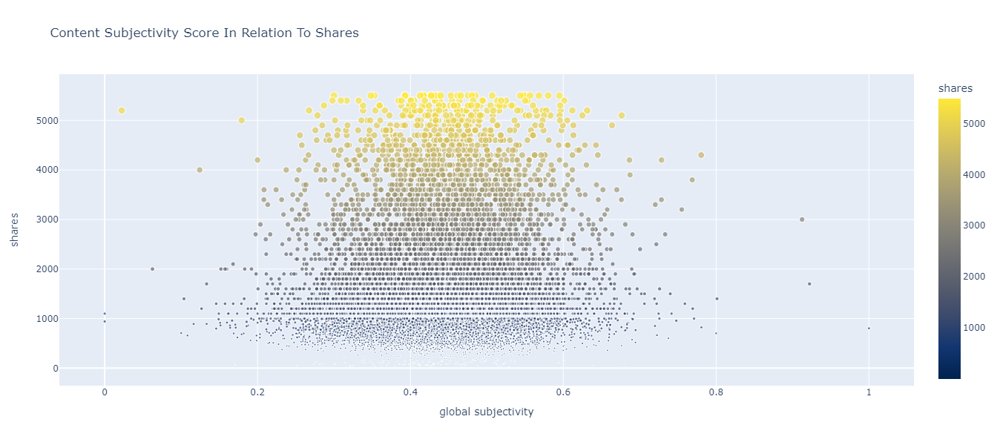

In [180]:
import plotly.express as px

fig = px.scatter(df, x='global_subjectivity', y='shares', color='shares',
                 color_continuous_scale='cividis', title='Content Subjectivity Score In Relation To Shares',
                 size='shares', size_max=10)

fig.update_layout(xaxis_title='global subjectivity', height=600)

fig.show()

<span style="font-size:16px;">With this plot, we observe that the subjectivity of the content is not highly correlated with shares. Nevertheless, we can note that articles with the highest shares tend to have a subjectivity ranging between 30% and just under 60%.

<span style="font-size:16px;">Following this, we will explore the subjectivy of the title:

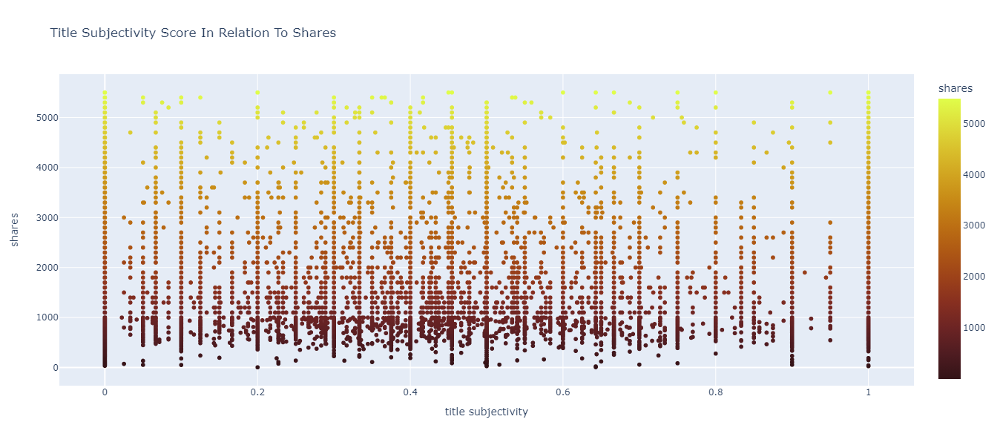

In [181]:
fig = px.scatter(df, x='title_subjectivity', y='shares', color='shares',
                 color_continuous_scale='solar', title='Title Subjectivity Score In Relation To Shares')
fig.update_layout(xaxis_title='title subjectivity', height=600) 
fig.show()

<span style="font-size:16px;">Here we observe that there is not a specifically ideal range to achieve a high number of shares, as the subjectivity of the title is not strongly correlated with the number of shares. It means that this feature can have any value without impacting the shares.

<span style="font-size:18px;">To conclude this section, we can infer that the content of an article should be neither too subjective nor too objective, while the title can be at any level of subjectivity.

### **III) Day of publication**

<span style="font-size:18px;">In this section, we will explore whether the day of the week an article is posted can have an impact on the number of shares.

In [182]:
df["weekday_names"] = df["weekday"].astype(int).map({
    1: 'Monday',
    2: 'Tuesday',
    3: 'Wednesday',
    4: 'Thursday',
    5: 'Friday',
    6: 'Saturday',
    7: 'Sunday'
})

<span style="font-size:16px;">Count and number of average shares by weekday and weekend:

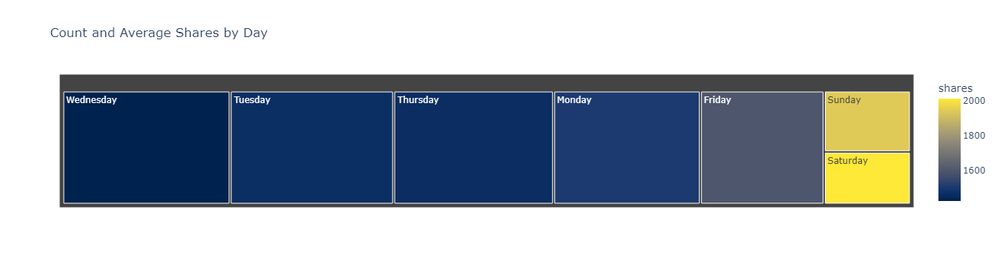

In [183]:
grouped_data = df.groupby('weekday_names').agg({'weekday_names': 'count', 'shares': 'mean'}).rename(columns={'weekday_names': 'count'}).reset_index()

fig = px.treemap(grouped_data, path=['weekday_names'], values='count', color='shares', hover_data=['shares'],
                 color_continuous_scale='cividis', title='Count and Average Shares by Day')
fig.show()

<span style="font-size:16px;">As we can see, most news is published during the weekdays. However, the articles published on the weekend receive the highest average number of shares. This could be explained by the fact that the majority of journalists work during the weekdays, and people, being busy with work, may not have the time to read news. On the weekend, when people have more free time, they are more likely to engage with and share articles. It appears that articles receive the most views at the time of their publication.

<span style="font-size:16px;">So, to get more shares it's better to publish the weekend and particulary the saturday.

### **IV) Data channel**

<span style="font-size:18px;">In this section, we will discuss data channels. There are six available data channels, and not all news articles have one. We will explore whether certain data channels are more commonly shared than others.

<span style="font-size:16px;">Average number of shares per theme:

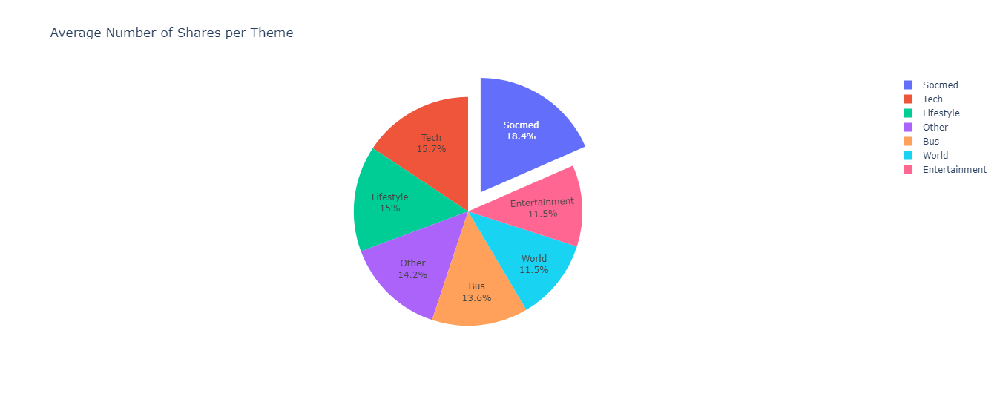

In [184]:
average_shares_per_theme = df.groupby('theme')['shares'].mean().reset_index()

fig = go.Figure(go.Pie(
    labels=average_shares_per_theme['theme'],
    values=average_shares_per_theme['shares'],
    pull=[0, 0, 0, 0, 0.2,0,0],textinfo='label+percent'),layout = go.Layout(height=550, width=700))
fig.update_layout(
    title='Average Number of Shares per Theme')
fig.show()

<span style="font-size:16px;">With this pie chart, we can see that themes are almost equally distributed. The theme with the most shares is 'socmed,' followed by 'tech'.

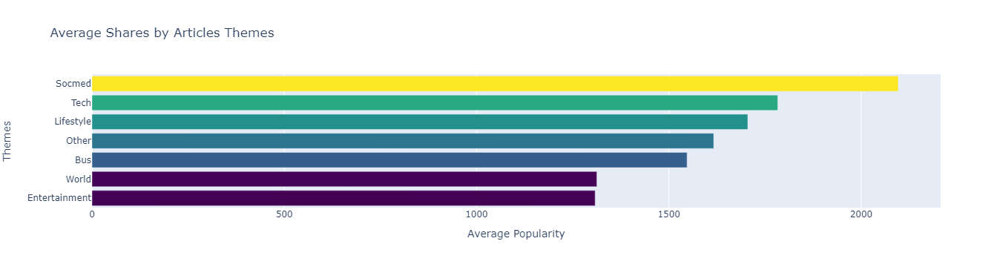

In [185]:
num_themes = df['theme'].nunique()
colorscale = 'Viridis'
theme_group = df.groupby('theme')['shares'].mean().sort_values(ascending=True)
fig = go.Figure()
fig.add_trace(go.Bar(
    y=theme_group.index,
    x=theme_group.values,
    orientation='h',
    marker=dict(color=theme_group.values, colorscale=colorscale)))
fig.update_layout(
    title='Average Shares by Articles Themes',
    xaxis=dict(title='Average Popularity'),
    yaxis=dict(title='Themes'))
fig.show()

### **V) Images & Videos**

<span style="font-size:18px;">In this section, we will focus on the number of images and videos in an article and see what is it's influence on the number of times an article is shared.

<span style="font-size:16px;">Relation between number of images in an article and shares:

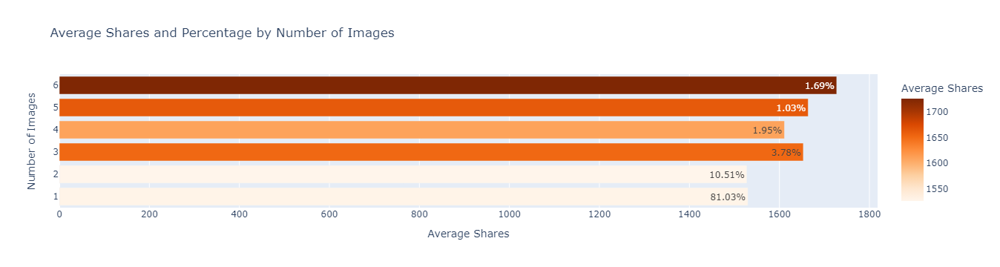

In [186]:
df_grouped = df.groupby('num_imgs')['shares'].agg(['mean', 'count']).reset_index()
df_grouped['percentage'] = (df_grouped['count'] / df_grouped['count'].sum()) * 100
df_grouped['percentage']= df_grouped['percentage'].round(2)
df_grouped['percentage']= df_grouped['percentage'].astype(str) + "%"

fig = px.bar(df_grouped, x='mean', y='num_imgs', orientation='h',text='percentage', title='Average Shares and Percentage by Number of Images',labels={'mean': 'Average Shares', 'num_imgs': 'Number of Images'},color='mean',color_continuous_scale='Oranges')
fig.update_layout(yaxis=dict(tickmode='linear', dtick=1))
fig.show()

<span style="font-size:16px;">With this analysis, we observe that having multiple images tends to result in more shares. The peak in average shares is reached with 6 images, followed by 5 and 3. However, it's worth noting that this is a minority, as most articles have 1 or 2 images.

<span style="font-size:16px;">Relation between number of videos in an article and shares:

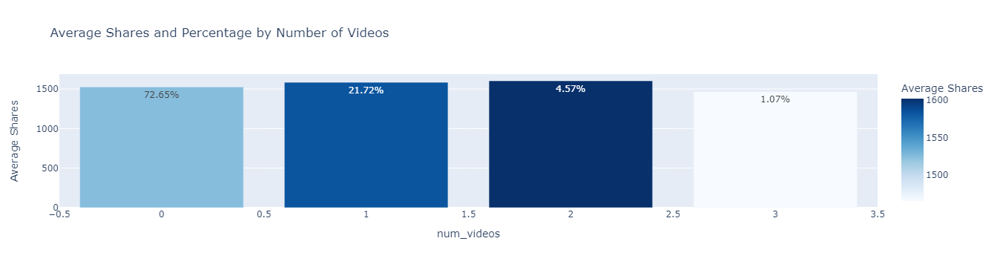

In [187]:
df_grouped = df.groupby('num_videos')['shares'].agg(['mean', 'count']).reset_index()
df_grouped['percentage'] = (df_grouped['count'] / df_grouped['count'].sum()) * 100
df_grouped['percentage']= df_grouped['percentage'].round(2)
df_grouped['percentage']= df_grouped['percentage'].astype(str) + "%"

fig = px.bar(df_grouped, x='num_videos', y='mean', orientation='v',text='percentage', title='Average Shares and Percentage by Number of Videos',labels={'mean': 'Average Shares', 'num_imgs': 'Number of Videos'},color='mean',color_continuous_scale='Blues')
fig.show()

<span style="font-size:16px;">We observe that the number of videos doesn't significantly impact the number of shares, but 2 is slightly better. The majority of articles have between 1 and 2 videos. Therefore, there isn't a specific range of video numbers that leads to an increase in shares.

### **VI) References**

<span style="font-size:18px;">In this section, we will explore how keywords and links, whether referencing other articles or not, may be linked to the number of shares.

<span style="font-size:16px;">Relation between shares and the number of keywords in an article:

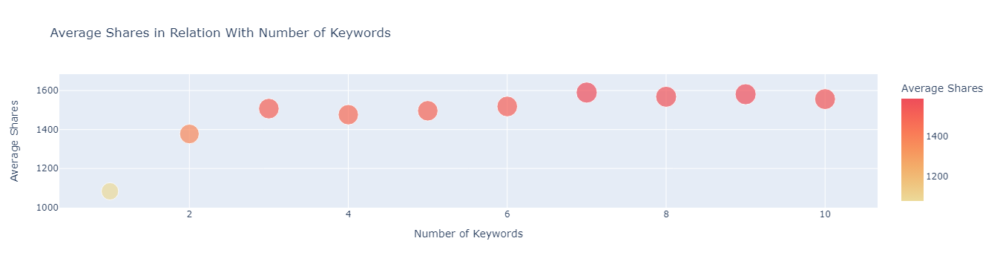

In [188]:
fig = px.scatter(df.groupby('num_keywords')['shares'].mean().reset_index(), x='num_keywords', y='shares', size='shares', color='shares', title='Average Shares in Relation With Number of Keywords',
                 labels={'num_keywords': 'Number of Keywords', 'shares': 'Average Shares'},
                 hover_name='shares',
                 color_continuous_scale='Oryel')
fig.show()

<span style="font-size:16px;">This plot allows us to observe a positive correlation between the number of shares and the number of keywords. Articles with the maximum number of keywords, which is 7, tend to receive the highest number of shares. Therefore, we conclude that including a greater number of keywords can lead to increased shares for an article.

<span style="font-size:16px;">Relation between shares and the number of links to others websites in an article:

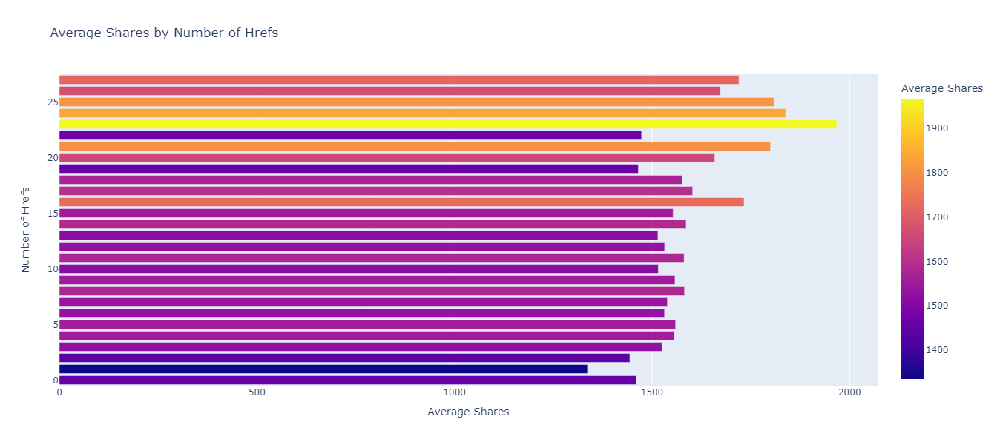

In [189]:
grouped_data = df.groupby('num_hrefs')['shares'].mean().reset_index()

# Create a bar plot with larger bars
fig = px.bar(grouped_data, x='shares', y='num_hrefs', orientation='h', color='shares',
             labels={'num_hrefs': 'Number of Hrefs', 'shares': 'Average Shares'},
             title='Average Shares by Number of Hrefs',
             color_discrete_sequence=['orange'],
             width=800, height=600)

# Show the plot
fig.show()

<span style="font-size:16px;">The number of links in an article is lightly positively correlated with the number of shares. We can observe that articles with around 23 hrefs can get close to 2000 shares. We can say that having 23 to 25 hrefs can be interesting to get a popular article.

<span style="font-size:16px;">Relation between shares and the number of links to others articles published by Mashable:

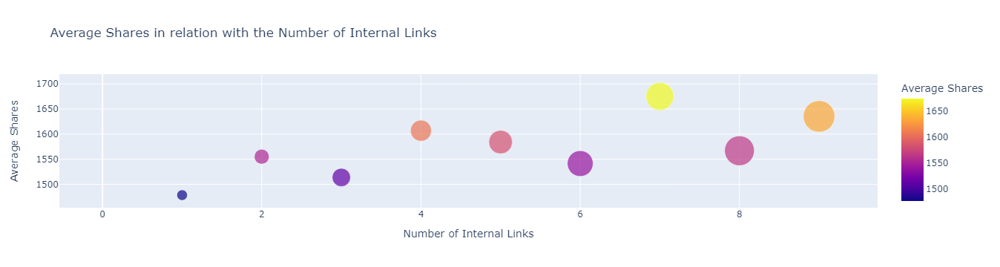

In [190]:
grouped_data = df.groupby('num_self_hrefs')['shares'].mean().reset_index()

fig = px.scatter(grouped_data, x='num_self_hrefs', y='shares', size='num_self_hrefs', color='shares',
                 size_max=30, title='Average Shares in relation with the Number of Internal Links',
                 labels={'num_self_hrefs': 'Number of Internal Links', 'shares': 'Average Shares'})

fig.update_traces(marker=dict(line=dict(color='white', width=0.5)))
fig.show()

<span style="font-size:16px;">We can see that articles with 7 links of others published by Mashable have the highest number of shares in average. Followed by 9.

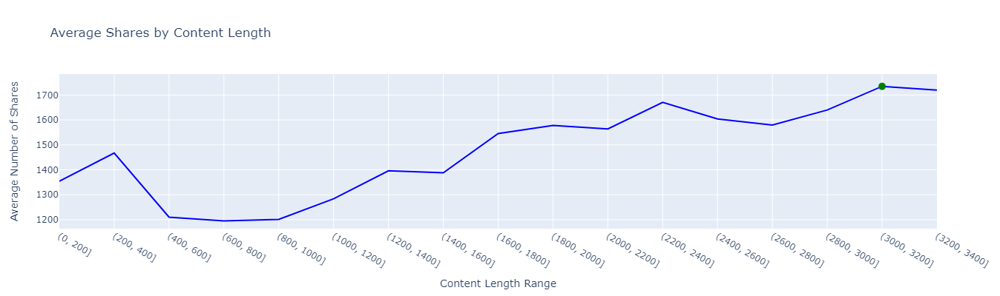

In [191]:
bins = list(range(0, 3500, 200))
df['range_values'] = pd.cut(df['self_reference_avg_sharess'], bins=bins).astype(str)
order = [f'({bins[i]}, {bins[i+1]}]' for i in range(len(bins)-1)]

avg_shares_by_self_reference = df.groupby('range_values', as_index=False)['shares'].mean()
avg_shares_by_self_reference['range_values'] = pd.Categorical(avg_shares_by_self_reference['range_values'], categories=order, ordered=True)
avg_shares_by_self_reference = avg_shares_by_self_reference.sort_values(by='range_values')

max_index = avg_shares_by_self_reference['shares'].idxmax()

fig = px.line(avg_shares_by_self_reference, x='range_values', y='shares', title='Average Shares by Content Length',
              labels={'range_values': 'Content Length Range', 'shares': 'Average Number of Shares'})

fig.update_traces(line=dict(color='blue', shape='linear'), marker=dict(color='green'), selector=dict(type='scatter'))

fig.add_scatter(x=[avg_shares_by_self_reference.loc[max_index, 'range_values']],
                y=[avg_shares_by_self_reference.loc[max_index, 'shares']],
                mode='markers',
                marker=dict(color='green', size=10),
                showlegend=False)

fig.update_layout(autosize=False, width=800, height=400)
fig.show()

<span style="font-size:16px;">With this plot, we notice that articles with self reference having between 3000 and 3200 shares get the most shares. This means that an article with links to others popular articles will get more shares.

# **Conclusion**

<span style="font-size:20px;">The recipe for a popular article:

<span style="font-size:16px;">>**Title Length:**
Aim for a concise title with precisely 4 words.

<span style="font-size:16px;">>**Content Length:**
Ensure the article falls within the range of 1200 to 1400 words.

    
<span style="font-size:16px;">>**Word Metrics:**
Maintain a unique words ratio between 30% to 40%.
Try to keep in mind, when writing your article, to make the effort to write words of 4 to 5 letters.


<span style="font-size:16px;">>**Word Sentiment:**
Strive for a higher global rate of positive words compared to negative words.
Positive words polarity should range from 20% to 60%.
Negative words polarity should range from -10% to -60%.
Aim for an overall global sentiment polarity of 0% to 33% positive.

<span style="font-size:16px;">>**Content Subjectivity:**
Keep the content subjectivity within the range of 30% to 60%.


<span style="font-size:16px;">>**Publication Timing:**
Optimal publishing day is Saturday.


<span style="font-size:16px;">>**Theme:**
Tailor the article content to revolve around social media (Socmed).


<span style="font-size:16px;">>**Multimedia Elements:**
Include 6 images to enhance visual appeal.
Embed 2 videos for a dynamic and engaging experience.


<span style="font-size:16px;">>**SEO and Links:**
Utilize 7 carefully chosen keywords to enhance search engine visibility.
Include 23 hyperlinks to relevant sources.
Ensure 7 self-referential hyperlinks within the article.
Aim for an average of 3000 to 3200 shares for articles linked within the content. Overall, the more the articles you reference are popular and therefore widely shared, the more your article will take on this same popular trend.
    
*P.S.: Don't forget to have a look at the README file for the overall conclusion*